In [1]:
import scanpy as sc
import anndata as ann
import numpy as np 
import seaborn as sb
import pandas as pd
import pickle
from sklearn import preprocessing as pp
import diffxpy.api as de
import time
from scipy import sparse

import sys  
sys.path.insert(0, '/lustre/groups/ml01/code/karin.hrovatin/mm_pancreas_atlas_rep/code/')
from importlib import reload  
import helper
reload(helper)
import helper as h
from constants import SAVE
import expected_multiplet_rate as emr
reload(emr)
import expected_multiplet_rate as emr
#sc.settings.verbosity = 3

from matplotlib import rcParams
import matplotlib.pyplot as plt

#R interface
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [3]:
%%R
library(scran)
library(biomaRt)
library(BiocParallel)
#library(Seurat)


Error in library(scran) : there is no package called ‘scran’


In [4]:
# Path for saving results - last shared folder by all datasets
shared_folder='/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/salinno_project/rev4/'
UID2='Fltp16_annotation'

Load data:

In [ ]:
#Load data
#adata=pickle.load(  open( shared_folder+"data_normalised.pkl", "rb" ) )
adata=h.open_h5ad(shared_folder+"data_normalised.h5ad",unique_id2=UID2)

## Add previously generated annotation

At the time of this analysis the previously generated annotation was still internal (unpublished) and may thus differ from the finnaly published annotation. Howevre, this previous annotatiuon was used only for internal validation and non of the analyses depend on it.

In [6]:
# Add previously generated annotation (Maren Buttner)
#adata_preannotated=h.open_h5ad("/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/salinno_project/rev4/maren/data_endo_final.h5ad",unique_id2=UID2)
adata_preannotated=h.open_h5ad("/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/salinno_project/rev4/maren/data_annotated.h5ad",unique_id2=UID2)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/compat/__init__.py:158: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/anndata/compat/__init__.py:158: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [7]:
adata_preannotated

AnnData object with n_obs × n_vars = 19748 × 17918
    obs: 'sample', 'eGFP_plus', 'eGFP_minus', 'Td-Tomato-plus', 'Td-Tomato-minus', 'n_counts', 'log_counts', 'n_genes', 'mt_fraction', 'doublet_score', 'doublet', 'S_score', 'G2M_score', 'phase', 'x_score', 'y_score', 'sex', 'louvain', 'cell_type'
    var: 'gene_ids', 'chromosome', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'sex_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [8]:
# Match the cell names between preanotated and current dataset
cell_name_map={'-mGFP':'-145_mGFP','-mRFP':'-146_mRFP','-mTmG':'-147_mTmG'}
adata_preannotated.obs.index=[h.replace_all(cell,cell_name_map) for cell in adata_preannotated.obs.index]

In [9]:
# Add pre-prepared cell type annotation to currently used dataset
adata.obs['pre_cell_type']=adata_preannotated.obs.reindex(adata.obs.index)['cell_type']
adata.obs['pre_cell_type'] = adata.obs['pre_cell_type'].cat.add_categories('NA')
adata.obs['pre_cell_type'].fillna('NA', inplace =True) 

Pre-annotated cell counts

In [10]:
# Count of cells per annotation
adata.obs.groupby('pre_cell_type').size()

pre_cell_type
alpha                   7522
beta                    7226
gamma                    673
delta                   1607
poly                     172
stellate                 384
endothelial              174
acinar/ductal            127
immune                    90
epsilon                   16
alpha-delta              335
alpha-beta                51
beta-delta               307
alpha, proliferating     213
beta, proliferating      108
gamma, proliferating      92
delta, proliferating      60
NA                       724
dtype: int64

## Visualisation

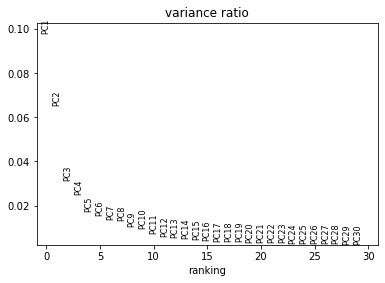

In [11]:
sc.pp.pca(adata, n_comps=30, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata)

In [12]:
# Select number of PCs to use
N_PCS=16

Compare different embeddings based on previously defined annotation. 

In [13]:
#sc.pp.neighbors(adata,n_pcs = N_PCS,metric='correlation') 
#sc.tl.umap(adata)

In [14]:
#rcParams['figure.figsize']=(7,7)
#sc.pl.umap(adata,size=10,color=['pre_cell_type'])
#sc.pl.umap(adata,size=10,color=['file'])

In [15]:
sc.pp.neighbors(adata,n_pcs = N_PCS) 
sc.tl.umap(adata)

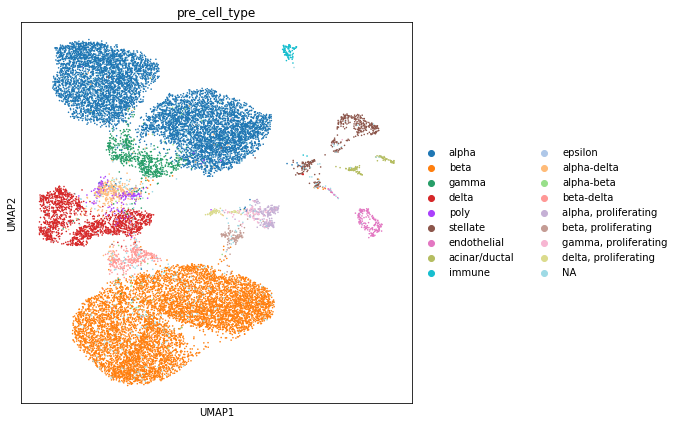

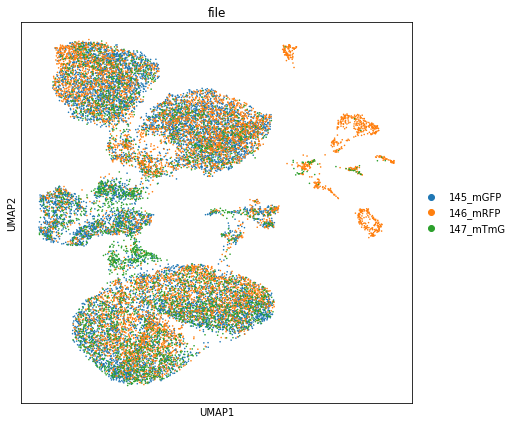

In [16]:
rcParams['figure.figsize']=(7,7)
sc.pl.umap(adata,size=10,color=['pre_cell_type'])
sc.pl.umap(adata,size=10,color=['file'])

#C: Decided that Euclidean distance (default) will be ok.

## Cell cycle
Performed separately for individual batches.

### Seurat/Scanpy - score by G2M and S

In [17]:
# Load mouse cell cycle genes
cell_cycle_mm=pd.read_table('/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/gene_lists/cell_cycle_mm_Macosko2015.tsv',sep='\t')

Use cell cycle genes that overlap HVGs (from different batches). Display these genes on HVG plots (with non-phase genes being marked as .NA).

Use G2/M and M gene sets for G2/M annotation and S gene set for S annotation.

G1/S N genes: 92 overlap var: 90 overlap hvg (all): 19
S N genes: 96 overlap var: 94 overlap hvg (all): 21
G2/M N genes: 127 overlap var: 125 overlap hvg (all): 34
M N genes: 143 overlap var: 142 overlap hvg (all): 33
M/G1 N genes: 108 overlap var: 106 overlap hvg (all): 7
N genes for scoring S: 21 and G2/M: 67


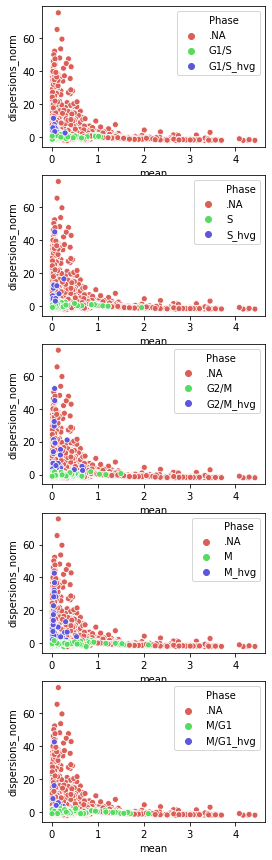

In [18]:
# How many of the cell cycle phase genes are present in HVG and in var and how variable they are
hvg=set(adata.var_names[adata.var.highly_variable])
i=0
rcParams['figure.figsize']=(4,15)
fig,axs=plt.subplots(5)
s_hvg=[]
g2m_hvg=[]
for phase in cell_cycle_mm.Phase.unique():
    genes_phase = set(cell_cycle_mm.query('Phase =="'+phase+'"').Gene)
    overlap_var = set(adata.var_names) & genes_phase
    overlap_hvg = hvg & genes_phase
    print(phase,'N genes:',len(genes_phase),'overlap var:',len(overlap_var),'overlap hvg (all):',len(overlap_hvg))
    phase_df=pd.DataFrame([phase]*len(overlap_var),index=overlap_var,columns=['Phase']).reindex(adata.var_names).fillna('.NA').sort_values('Phase')
    phase_df.loc[overlap_hvg,'Phase']=phase+'_hvg'
    phase_df['mean']=adata.var.means
    phase_df['dispersions_norm']=adata.var.dispersions_norm
    sb.scatterplot(x="mean", y="dispersions_norm", hue="Phase",data=phase_df,ax=axs[i],palette='hls')
    i+=1
    if phase == 'S':
        s_hvg.extend(overlap_hvg)
    if phase in ['G2/M','M']:
        g2m_hvg.extend(overlap_hvg)
        
print('N genes for scoring S:',len(s_hvg),'and G2/M:',len(g2m_hvg))

Cell cycle annotation

In [19]:
# Annotated cell cycle per batch
adata.obs['S_score']= np.zeros(adata.shape[0])
adata.obs['G2M_score'] = np.zeros(adata.shape[0])
adata.obs['phase'] = np.zeros(adata.shape[0])

for batch in enumerate(adata.obs['file'].cat.categories):
    batch=batch[1]
    idx = adata.obs.query('file=="'+batch+'"').index
    adata_tmp = adata[idx,:].copy()
    sc.tl.score_genes_cell_cycle(adata_tmp, s_genes=s_hvg, g2m_genes=g2m_hvg,use_raw=False)
    adata.obs.loc[idx,'S_score'] = adata_tmp.obs['S_score']
    adata.obs.loc[idx,'G2M_score'] = adata_tmp.obs['G2M_score']
    adata.obs.loc[idx,'phase'] = adata_tmp.obs['phase']
    
del adata_tmp

In [20]:
# Count of cells annotated to each phase
adata.obs['phase'].value_counts()

G1     14437
S       4494
G2M      950
Name: phase, dtype: int64

Display cell cycle score distributions and annotation.

... storing 'phase' as categorical


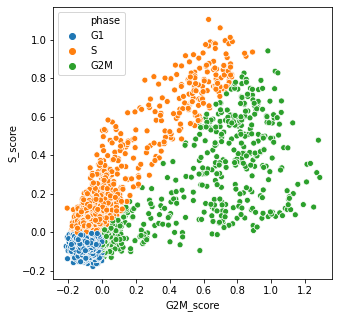

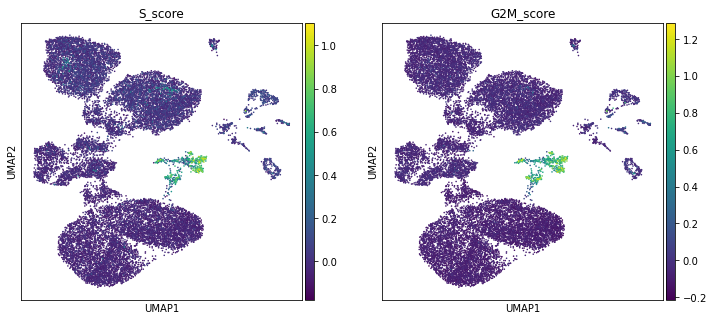

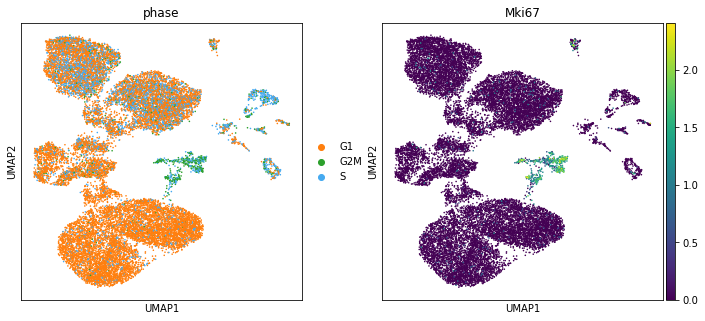

In [21]:
adata.uns['phase_colors']=['#ff7f0e', '#2ca02c','#46aaf0']

rcParams['figure.figsize']=(5,5)
sb.scatterplot(x='G2M_score',y='S_score',hue='phase',data=adata.obs)
sc.pl.umap(adata, color=['S_score', 'G2M_score'], size=10, use_raw=False)
sc.pl.umap(adata, color=['phase','Mki67'], size=10, use_raw=False)

 ### Cyclone - based on G1, S, and G2/M scores

Add gene Entrez IDs to adata in order to map genes to cell cycle database.

In [22]:
# Adata genes for R
genes=adata.var_names

In [23]:
%%R -i genes -o gene_ids
# Extract Ensembl gene IDs
mouse = useMart("ensembl", dataset = "mmusculus_gene_ensembl")
gene_ids = getBM(attributes = c("mgi_symbol",'ensembl_gene_id'), filters = "mgi_symbol", values = genes , mart = mouse, uniqueRows=FALSE)

In [24]:
# Add gene ids to adata, use only genes with unique mapped ensembl ids
gene_ids.drop_duplicates(subset='mgi_symbol', keep=False, inplace=True)
gene_ids.index=gene_ids.mgi_symbol
gene_ids=gene_ids.reindex(list(adata.var_names))
adata.var['EID']=gene_ids.ensembl_gene_id

In [25]:
# Prepare R data for cyclonee
x_mat=adata.X.T
gene_ids=adata.var.EID
batches=adata.obs.file
cells=adata.obs.index

In [26]:
%%R -i x_mat -i gene_ids -i batches -i cells -o cyclone_anno
# Cyclone cell scores, calculated separately for each batch
mm.pairs <- readRDS(system.file("exdata", "mouse_cycle_markers.rds", package="scran"))
phases<-c()
s<-c()
g2m<-c()
g1<-c()
cells_order<-c()
for(batch in unique(batches)){
    # Select batch data
    x_mat_batch=x_mat[,batches==batch]
    print(batch,dim(x_mat_batch[1]))
    # Scores
    assignments <- cyclone(x_mat_batch, mm.pairs, gene.names=gene_ids,BPPARAM=MulticoreParam(workers = 16))
    phases<-c(phases,assignments$phases)
    s<-c(s,assignments$score$S)
    g2m<-c(g2m,assignments$score$G2M)
    g1<-c(g1,assignments$score$G1)
    # Save cell order
    cells_order<-c(cells_order,cells[batches==batch])
}
cyclone_anno<-data.frame(phase_cyclone=phases,s_cyclone=s,g2m_cyclone=g2m,g1_cyclone=g1)
rownames(cyclone_anno)<-cells_order

[1] "145_mGFP"
[1] "146_mRFP"
[1] "147_mTmG"


In [27]:
# Count of cells annotated to each phase
cyclone_anno.phase_cyclone.value_counts()

G1     19512
G2M      335
S         34
Name: phase_cyclone, dtype: int64

In [28]:
# Add cyclone annotation to adata
cyclone_anno=cyclone_anno.reindex(adata.obs.index)
adata.obs=pd.concat([adata.obs,cyclone_anno],axis=1)

... storing 'phase_cyclone' as categorical
... storing 'EID' as categorical


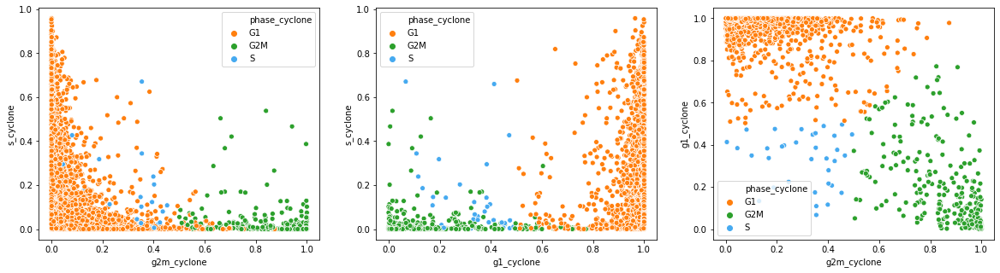

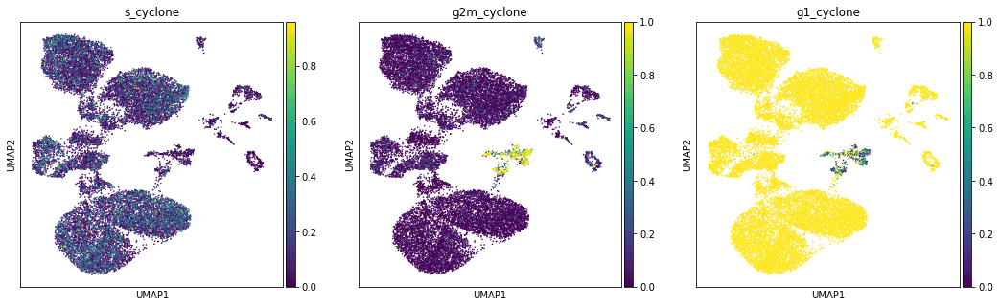

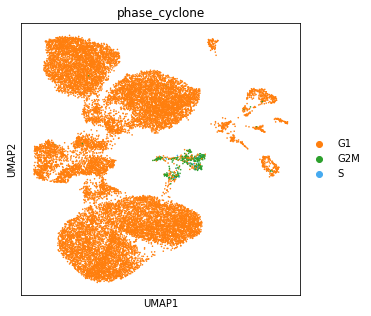

In [29]:
# Plot score distributions and cell assignment on UMAP
rcParams['figure.figsize']=(20,5)
fig,axs=plt.subplots(1,3)
palette=sb.color_palette(['#ff7f0e', '#2ca02c','#46aaf0'])
sb.scatterplot(x='g2m_cyclone',y='s_cyclone',hue='phase_cyclone',data=cyclone_anno,ax=axs[0],palette=palette)
sb.scatterplot(x='g1_cyclone',y='s_cyclone',hue='phase_cyclone',data=cyclone_anno,ax=axs[1],palette=palette)
sb.scatterplot(x='g2m_cyclone',y='g1_cyclone',hue='phase_cyclone',data=cyclone_anno,ax=axs[2],palette=palette)
rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata, color=['s_cyclone', 'g2m_cyclone','g1_cyclone'], size=10, use_raw=False)
adata.uns['phase_cyclone_colors']=['#ff7f0e', '#2ca02c','#46aaf0']
sc.pl.umap(adata, color=['phase_cyclone'], size=10, use_raw=False)

#C: The cyclone results seem more reliable based on previous cell type annotation. 

## Sex scores

Extract expressed genes from X and Y chromosome and score their expression, separately for each batch.

Add chromosome information:

In [30]:
# Gene names for R for chromosome assignment
genes=adata.var_names

In [31]:
%%R -i genes -o genes_chr
# Chromosome assignment 

mouse = useMart("ensembl", dataset = "mmusculus_gene_ensembl")
# Return duplicated results - e.g. one gene being annotated to multiple chromosomes
genes_chr = getBM(attributes = c("mgi_symbol",'chromosome_name'), filters = "mgi_symbol", values = genes , mart = mouse, uniqueRows=F)


In [32]:
# Remove genes annotated to non-standard chromosomes and 
# confirm that each gene is now annotated to only one chromosome
mouse_chromosomes=[str(i) for i in range(1,20)]+['X','Y','MT']
genes_chr_filtered=genes_chr.query('chromosome_name in @mouse_chromosomes')
#Remove duplicated rows (gene was returned multiple times with the same chromosome)
genes_chr_filtered=genes_chr_filtered.drop_duplicates()
print('Each gene has one annotated chromosome:',
      genes_chr_filtered.mgi_symbol.unique().shape[0]==genes_chr_filtered.shape[0])
print('N genes with chromosomes:',genes_chr_filtered.shape[0],'out of',adata.shape[1],'genes')

Each gene has one annotated chromosome: True
N genes with chromosomes: 16343 out of 16773 genes


In [33]:
# Add chromosomes in adata
genes_chr_filtered.index=genes_chr_filtered.mgi_symbol
genes_chr_filtered=genes_chr_filtered.reindex(adata.var_names)
adata.var['chromosome']=genes_chr_filtered['chromosome_name']

Extract X and Y HVGs and compare their number to all expressed X and Y genes.

In [34]:
# Select X and Y genes that are HVG
x_hvg = adata.var.query('chromosome=="X" & highly_variable').index
y_hvg = adata.var.query('chromosome=="Y" & highly_variable').index
print('X HVG:',len(x_hvg),'/',adata.var.query('chromosome=="X"').shape[0],
      'Y HVG:',len(y_hvg),'/',adata.var.query('chromosome=="Y"').shape[0])

X HVG: 67 / 523 Y HVG: 3 / 6


Show Y gene expression on UMAP.

... storing 'chromosome' as categorical


Y specific HVG


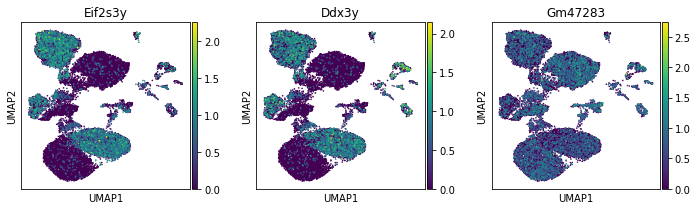

Y specific non-HVG


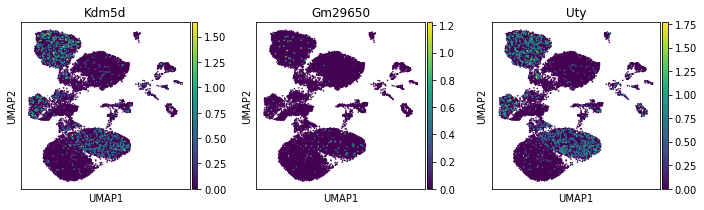

In [35]:
# Show Y HVGs and Y non-HVGs
rcParams['figure.figsize']=(3,3)
print('Y specific HVG')
sc.pl.umap(adata, color=y_hvg, size=10, use_raw=False)
print('Y specific non-HVG')
sc.pl.umap(adata, color=adata.var.query('chromosome=="Y"& ~highly_variable').index, size=10, use_raw=False)

#C: Due to low number of expressed Y genes both HVG and non-HVG genes will be used. Genes Gm47283 (unsepcific??) and Gm29650 (low expression in most cells) will not be used for Y scoring. 
For X chromosome only HVG will be used. 

Score cells:

In [36]:
# Prepare final scoring gene sets for X and Y
y_all=adata.var.query('chromosome=="Y"').index
y_selected=[gene for gene in y_all if gene not in ['Gm47283','Gm29650']]
x_selected=list(x_hvg)
print('N selected genes from Y:',len(y_selected),'and from X:',len(x_selected))

N selected genes from Y: 4 and from X: 67


In [37]:
#Do not use the smaller gene set as controll size as Y gene set is very small
#ctrl_size = min(len(x_genes), len(y_genes))

# For performing it on all batches together
#sc.tl.score_genes(adata, x_selected, score_name = 'x_score', use_raw=False)
#sc.tl.score_genes(adata, y_selected, score_name = 'y_score',use_raw=False)

# Compute sex score per batch
adata.obs['x_score']= np.zeros(adata.shape[0])
adata.obs['y_score'] = np.zeros(adata.shape[0])

for batch in enumerate(adata.obs['file'].cat.categories):
    batch=batch[1]
    idx = adata.obs.query('file=="'+batch+'"').index
    adata_tmp = adata[idx,:].copy()
    sc.tl.score_genes(adata_tmp, x_selected, score_name = 'x_score', use_raw=False)
    sc.tl.score_genes(adata_tmp, y_selected, score_name = 'y_score',use_raw=False)
    adata.obs.loc[idx,'y_score'] = adata_tmp.obs['y_score']
    adata.obs.loc[idx,'x_score'] = adata_tmp.obs['x_score']
    
del adata_tmp

Plot X and Y scores

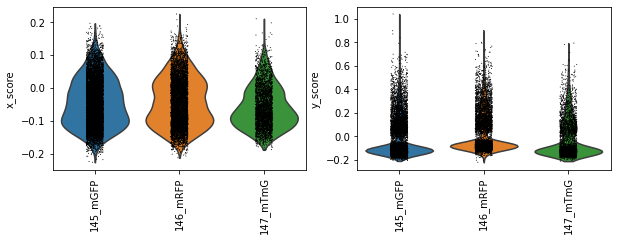

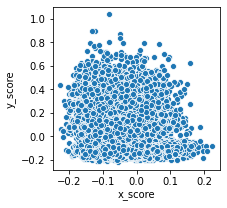

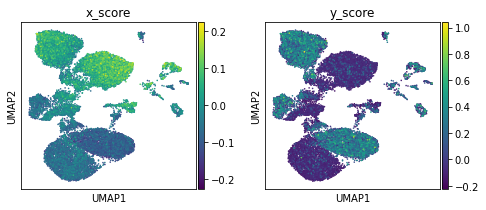

<AxesSubplot:xlabel='y_score'>

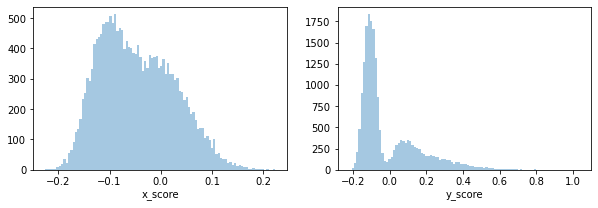

In [38]:
rcParams['figure.figsize']=(10,3)
fig,axs=plt.subplots(1,2)
# Scores across batches
sc.pl.violin(adata, ['x_score'], groupby='file', size=1, log=False,rotation=90,ax=axs[0],show=False)
sc.pl.violin(adata, ['y_score'], groupby='file', size=1, log=False,rotation=90,ax=axs[1],show=False)
plt.show()
# X vs Y score
rcParams['figure.figsize']=(3,3)
sb.scatterplot(x='x_score',y='y_score',data=adata.obs)
# Distribution of scores
sc.pl.umap(adata, color=['x_score','y_score'] ,size=10, use_raw=False)
rcParams['figure.figsize']=(10,3)
fig,axs=plt.subplots(1,2)
sb.distplot(adata.obs['x_score'],  kde=False,  bins=100,ax=axs[0])
sb.distplot(adata.obs['y_score'],  kde=False,  bins=100,ax=axs[1])

#C: It seems that Y score alone performs much better - X score depends more on the cell type. Thus only Y score will be used for cell type annotation.

<AxesSubplot:xlabel='y_score'>

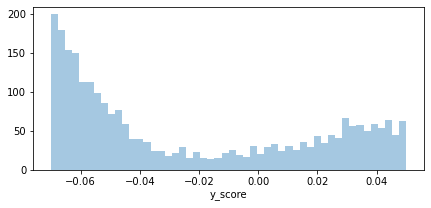

In [39]:
# More detailed plot of y_score region of interest
rcParams['figure.figsize']=(7,3)
sb.distplot(adata.obs.query('y_score>-0.07 & y_score<0.05')['y_score'],  kde=False,  bins=50)

#C: Set male threshold at >= - 0.02 (Score 0 means equal expression as a reference data set.)

... storing 'sex' as categorical


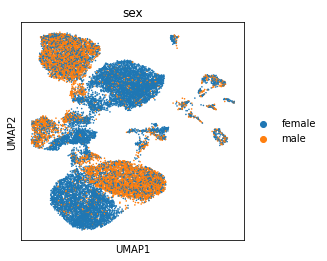

In [48]:
adata.obs['sex']=(adata.obs['y_score']>=-0.02).replace(False,'female').replace(True,'male')

rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata, color=['sex'] ,size=10, use_raw=False)

## Save intermediate results before cell type annotation

In [49]:
if SAVE:
    h.save_h5ad(adata, shared_folder+"data_annotated.h5ad",unique_id2=UID2)

# Cell type annotation

In [5]:
adata=h.open_h5ad(shared_folder+"data_annotated.h5ad",unique_id2=UID2)

## Endo high annotation

In [6]:
# Normalise raw data for cell type scoring
adata_rawnorm=adata.raw.to_adata().copy()
adata_rawnorm.X /= adata.obs['size_factors'].values[:,None] # This reshapes the size-factors array
sc.pp.log1p(adata_rawnorm)
adata_rawnorm.X = np.asarray(adata_rawnorm.X)
adata_rawnorm.obs=adata.obs.copy()

#### Ins

In [ ]:
genes=['Ins1','Ins2']
score_name='ins'

In [7]:
# Compute score
sc.tl.score_genes(adata_rawnorm, gene_list=genes, score_name=score_name+'_score',  use_raw=False)

<ipython-input-9-1b559b26e534>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ins_scores['ins_score_norm']=pp.minmax_scale(ins_scores.ins_score)


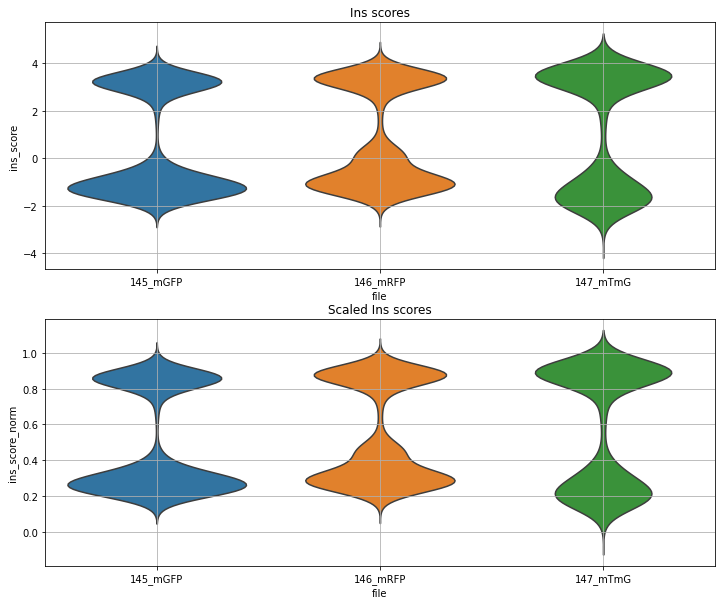

In [9]:
scores=adata_rawnorm.obs[[score_name+'_score','file']]
scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])
rcParams['figure.figsize']=(12,10)
fig,axs=plt.subplots(2,1)
sb.violinplot(x='file',y=score_name+'_score',data=scores,inner=None,ax=axs[0])
axs[0].title.set_text(score_name+' scores')
axs[0].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores,inner=None,ax=axs[1])
axs[1].title.set_text('Scaled '+score_name+' scores')
axs[1].grid()
#sb.violinplot(x='file',y=score_name+'_score_norm',data=scores[scores[score_name+'_score_norm']>0.15],
#             inner=None,ax=axs[2])
#axs[2].title.set_text('Scaled '+score_name+' scores without very low '+score_name+' cells')
#axs[2].grid()

In [13]:
# Find score high cells
# Use different thresholds across files as there might be different ambient counts (or other effects), 
# thus shifting distributions up a bit
file_thresholds={'145_mGFP':0.6,'146_mRFP':0.65,'147_mTmG':0.6}
adata_rawnorm.obs[score_name+'_high']=scores.apply(lambda x: x[score_name+'_score_norm'] > file_thresholds[x.file], 
                                                   axis=1)
print('Proportion of '+score_name+' high across samples:')
adata_rawnorm.obs[['file',score_name+'_high']].groupby('file')[score_name+'_high'].value_counts(
    normalize=True,sort=False)

Proportion of ins high across samples:


file      ins_high
145_mGFP  False       0.627264
          True        0.372736
146_mRFP  False       0.610848
          True        0.389152
147_mTmG  False       0.471044
          True        0.528956
Name: ins_high, dtype: float64

In [ ]:
# Add info about score high to main adata and save it
adata.obs[score_name+'_score']=adata_rawnorm.obs[score_name+'_score']
adata.obs[score_name+'_high']=adata_rawnorm.obs[score_name+'_high']

#### Gcg

In [7]:
genes=['Gcg']
score_name='gcg'

In [8]:
# Compute score
sc.tl.score_genes(adata_rawnorm, gene_list=genes, score_name=score_name+'_score',  use_raw=False)

<ipython-input-9-458a9266293c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])


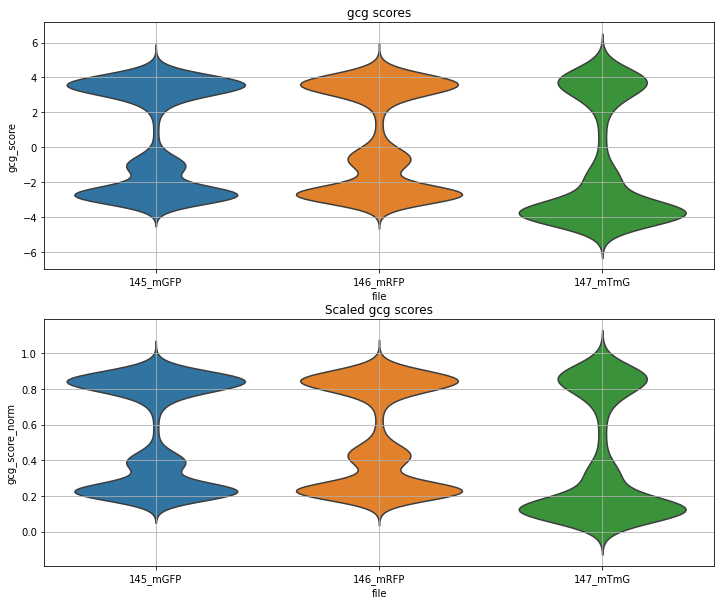

In [9]:
scores=adata_rawnorm.obs[[score_name+'_score','file']]
scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])
rcParams['figure.figsize']=(12,10)
fig,axs=plt.subplots(2,1)
sb.violinplot(x='file',y=score_name+'_score',data=scores,inner=None,ax=axs[0])
axs[0].title.set_text(score_name+' scores')
axs[0].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores,inner=None,ax=axs[1])
axs[1].title.set_text('Scaled '+score_name+' scores')
axs[1].grid()
#sb.violinplot(x='file',y=score_name+'_score_norm',data=scores[scores[score_name+'_score_norm']>0.15],
#             inner=None,ax=axs[2])
#axs[2].title.set_text('Scaled '+score_name+' scores without very low '+score_name+' cells')
#axs[2].grid()

In [10]:
# Find score high cells
# Use different thresholds across files as there might be different ambient counts (or other effects), 
# thus shifting distributions up a bit
file_thresholds={'145_mGFP':0.6,'146_mRFP':0.65,'147_mTmG':0.6}
adata_rawnorm.obs[score_name+'_high']=scores.apply(lambda x: x[score_name+'_score_norm'] > file_thresholds[x.file], 
                                                   axis=1)
print('Proportion of '+score_name+' high across samples:')
adata_rawnorm.obs[['file',score_name+'_high']].groupby('file')[score_name+'_high'].value_counts(
    normalize=True,sort=False)

Proportion of gcg high across samples:


file      gcg_high
145_mGFP  False       0.516105
          True        0.483895
146_mRFP  False       0.571807
          True        0.428193
147_mTmG  False       0.658544
          True        0.341456
Name: gcg_high, dtype: float64

In [11]:
# Add info about score high to main adata and save it
adata.obs[score_name+'_score']=adata_rawnorm.obs[score_name+'_score']
adata.obs[score_name+'_high']=adata_rawnorm.obs[score_name+'_high']

#### Sst

In [12]:
genes=['Sst']
score_name='sst'

In [13]:
# Compute score
sc.tl.score_genes(adata_rawnorm, gene_list=genes, score_name=score_name+'_score',  use_raw=False)

<ipython-input-14-458a9266293c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])


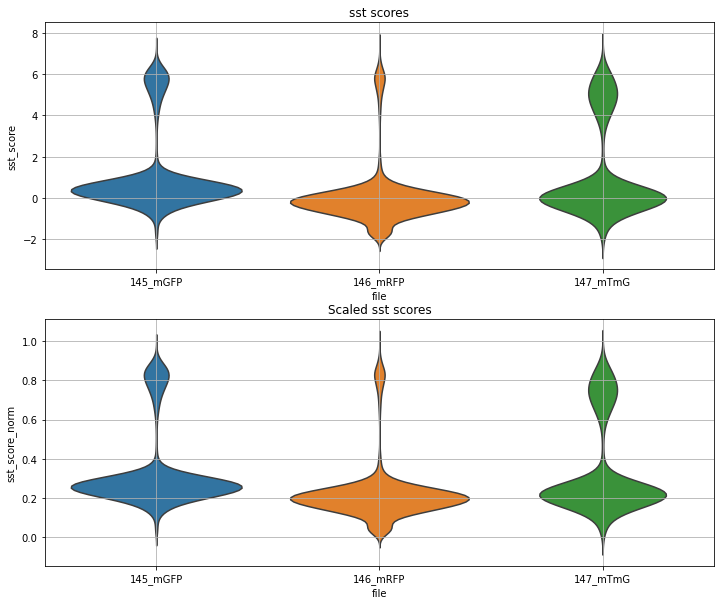

In [14]:
scores=adata_rawnorm.obs[[score_name+'_score','file']]
scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])
rcParams['figure.figsize']=(12,10)
fig,axs=plt.subplots(2,1)
sb.violinplot(x='file',y=score_name+'_score',data=scores,inner=None,ax=axs[0])
axs[0].title.set_text(score_name+' scores')
axs[0].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores,inner=None,ax=axs[1])
axs[1].title.set_text('Scaled '+score_name+' scores')
axs[1].grid()
#sb.violinplot(x='file',y=score_name+'_score_norm',data=scores[scores[score_name+'_score_norm']>0.15],
#             inner=None,ax=axs[2])
#axs[2].title.set_text('Scaled '+score_name+' scores without very low '+score_name+' cells')
#axs[2].grid()

In [25]:
# Find score high cells
# Use different thresholds across files as there might be different ambient counts (or other effects), 
# thus shifting distributions up a bit
file_thresholds={'145_mGFP':0.6,'146_mRFP':0.6,'147_mTmG':0.5}
adata_rawnorm.obs[score_name+'_high']=scores.apply(lambda x: x[score_name+'_score_norm'] > file_thresholds[x.file], 
                                                   axis=1)
print('Proportion of '+score_name+' high across samples:')
adata_rawnorm.obs[['file',score_name+'_high']].groupby('file')[score_name+'_high'].value_counts(
    normalize=True,sort=False)

Proportion of ppy high across samples:


file      ppy_high
145_mGFP  False       0.845028
          True        0.154972
146_mRFP  False       0.871723
          True        0.128277
147_mTmG  False       0.752580
          True        0.247420
Name: ppy_high, dtype: float64

In [26]:
# Add info about score high to main adata and save it
adata.obs[score_name+'_score']=adata_rawnorm.obs[score_name+'_score']
adata.obs[score_name+'_high']=adata_rawnorm.obs[score_name+'_high']

#### Ppy

In [19]:
genes=['Ppy']
score_name='ppy'

In [20]:
# Compute score
sc.tl.score_genes(adata_rawnorm, gene_list=genes, score_name=score_name+'_score',  use_raw=False)

<ipython-input-21-458a9266293c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])


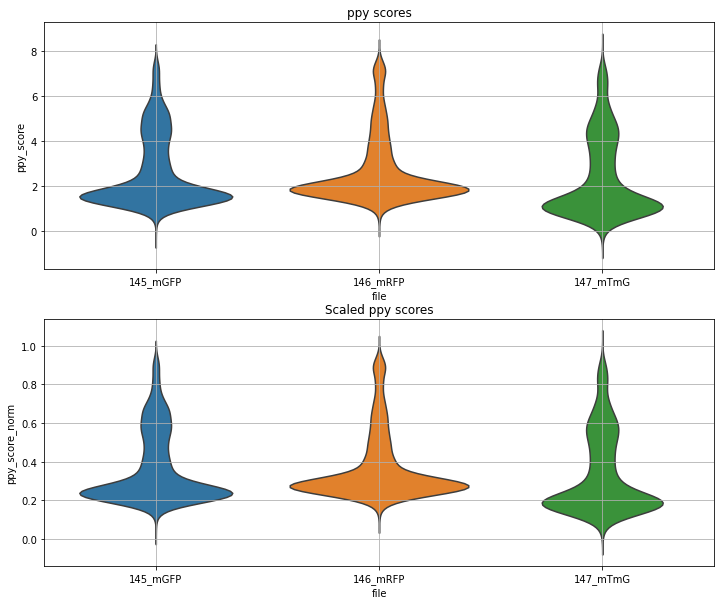

In [21]:
scores=adata_rawnorm.obs[[score_name+'_score','file']]
scores[score_name+'_score_norm']=pp.minmax_scale(scores[score_name+'_score'])
rcParams['figure.figsize']=(12,10)
fig,axs=plt.subplots(2,1)
sb.violinplot(x='file',y=score_name+'_score',data=scores,inner=None,ax=axs[0])
axs[0].title.set_text(score_name+' scores')
axs[0].grid()
sb.violinplot(x='file',y=score_name+'_score_norm',data=scores,inner=None,ax=axs[1])
axs[1].title.set_text('Scaled '+score_name+' scores')
axs[1].grid()
#sb.violinplot(x='file',y=score_name+'_score_norm',data=scores[scores[score_name+'_score_norm']>0.15],
#             inner=None,ax=axs[2])
#axs[2].title.set_text('Scaled '+score_name+' scores without very low '+score_name+' cells')
#axs[2].grid()

In [22]:
# Find score high cells
# Use different thresholds across files as there might be different ambient counts (or other effects), 
# thus shifting distributions up a bit
file_thresholds={'145_mGFP':0.8,'146_mRFP':0.8,'147_mTmG':0.75}
adata_rawnorm.obs[score_name+'_high']=scores.apply(lambda x: x[score_name+'_score_norm'] > file_thresholds[x.file], 
                                                   axis=1)
print('Proportion of '+score_name+' high across samples:')
adata_rawnorm.obs[['file',score_name+'_high']].groupby('file')[score_name+'_high'].value_counts(
    normalize=True,sort=False)

Proportion of ppy high across samples:


file      ppy_high
145_mGFP  False       0.969418
          True        0.030582
146_mRFP  False       0.948271
          True        0.051729
147_mTmG  False       0.946674
          True        0.053326
Name: ppy_high, dtype: float64

In [23]:
# Add info about score high to main adata and save it
adata.obs[score_name+'_score']=adata_rawnorm.obs[score_name+'_score']
adata.obs[score_name+'_high']=adata_rawnorm.obs[score_name+'_high']

#### Save

In [27]:
h.save_h5ad(adata, shared_folder+"data_annotated.h5ad",unique_id2=UID2)

## Clustering

#### Leiden clustering on log transformed data.

In [50]:
sc.tl.leiden(adata,resolution=1.5)

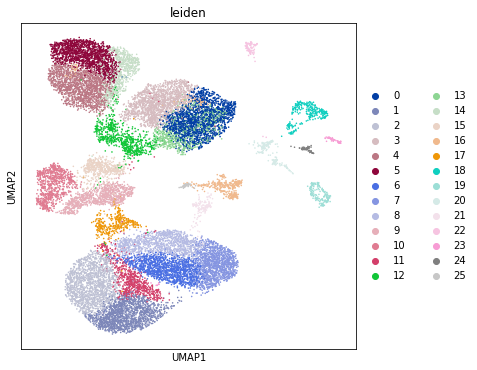

In [51]:
rcParams['figure.figsize']=(6,6)
sc.pl.umap(adata, color=['leiden'] ,size=10, use_raw=False)

#### Seurat style clustering

In [53]:
# Preapre data for Seurat clustering
expression=pd.DataFrame(adata.X.T,index=adata.var_names,columns=adata.obs.index)
hvg=adata.var_names[adata.var.highly_variable]

In [54]:
%%R -i expression -i hvg -i N_PCS -i shared_folder
# Seurat clustering data preparatrion - so that seurat object required for clustering can be computed once and then reused
seurat_obj<-CreateSeuratObject(counts=expression)
seurat_obj <- ScaleData(seurat_obj, features = hvg)
seurat_obj <- RunPCA(seurat_obj, features = hvg,npcs=N_PCS)
seurat_obj <- FindNeighbors(seurat_obj, dims = 1:N_PCS)
saveRDS(seurat_obj, file = paste0(shared_folder,"data_clustering_seurat_annotemp.rds"))

PC_ 1 
Positive:  Sparc, Vim, Ppic, Ldha, Sparcl1, Col4a2, Ifi203, Fstl1, Anxa2, Col4a1 
	   Mndal, Thbs1, Ifitm3, Akap2, Msn, Slc43a3, Plpp3, Nid1, Col15a1, Plaur 
	   Slfn5, Serpinh1, Rhoj, Serpine1, Bgn, Ebf1, Phf11d, Emp3, Lgals1, Zfp36l1 
Negative:  Hist1h1c, Ppp1r1a, Ero1lb, G6pc2, Hadh, Rbp4, Mlxipl, Nkx6-1, Prss53, Hepacam2 
	   Msmo1, Fam151a, AC078895.1, Ttr, Pdx1, Pcsk1, Trpm5, Gjd2, Tmem163, Fkbp1b 
	   Defb1, Zdhhc2, Papss2, Dnajc24, Ucn3, Rasgrf1, Cldn4, Phactr1, Sdf2l1, Sytl4 
PC_ 2 
Positive:  Prss53, Ppp1r1a, G6pc2, Hadh, Fam151a, Trpm5, Gng12, Bace2, Fkbp1b, AC078895.1 
	   Pcsk1, Sytl4, Ucn3, Ero1lb, Rasgrf1, Dnajb9, Enho, Slc2a2, Tmem215, Papss2 
	   Mlxipl, Mafa, Frzb, Spock2, Pdx1, Defb1, Dnajc24, Vstm2l, Prlr, Sdf2l1 
Negative:  Gpx3, Higd1a, Mafb, Ttr, Ctsz, Etv1, Irx2, Cryba2, Sfrp5, Irx1 
	   Basp1, Pappa2, Slc38a5, Rgs4, Upp1, Lpl, Sstr2, Gc, Cit, Kcnk3 
	   Tmsb15b2, Gadd45b, Arx, Dbpht2, Gria2, Vgf, Tmsb15b1, C8b, Nudt11, Aard 
PC_ 3 
Positive:  Col6a1, Bgn

In [55]:
res=0.3

In [56]:
%%R -i res -i shared_folder -o clusters 
#Seurat clustering
seurat_obj <- readRDS( file = paste0(shared_folder,"data_clustering_seurat_annotemp.rds"))
seurat_obj <- FindClusters(seurat_obj, resolution = res)
clusters<-data.frame(unlist(Idents(seurat_obj )))
rownames(clusters)<-names(Idents(seurat_obj ))
colnames(clusters)<-c('cluster_seurat')

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 19881
Number of edges: 638829

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9135
Number of communities: 12
Elapsed time: 4 seconds


In [57]:
# Add Seurat clusters
clusters=clusters.reindex(adata.obs.index)
adata.obs['cluster_seurat_r'+str(res)]=clusters.cluster_seurat

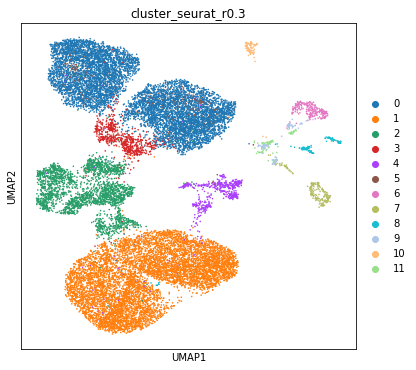

In [58]:
# Plot Seurat clustering
rcParams['figure.figsize']=(6,6)
sc.pl.umap(adata, color=['cluster_seurat_r0.3'] ,size=10, use_raw=False)

#### Leiden clustering on log transformed z-scaled data.

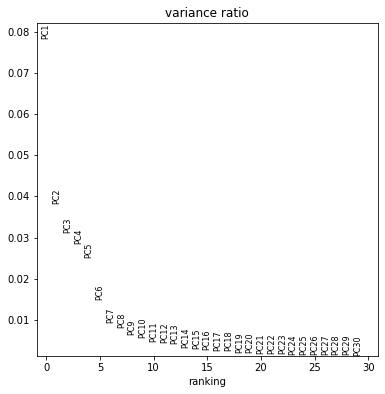

In [9]:
# Scale data and perform PCA
adata_scl=adata.copy()
sc.pp.scale(adata_scl,max_value=10)
sc.pp.pca(adata_scl, n_comps=30, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata_scl)

In [12]:
#C: Can stay the same as above
N_PCS

16

In [13]:
# neighbours on scaled data
sc.pp.neighbors(adata_scl,n_pcs = N_PCS) 

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities


In [14]:
# This neighbour weight computation (used in  Seurat) does not improve clustering - the main improvement is due to scaling
#snn.shared_knn_adata(adata,n_pcs=N_PCS,n_jobs=8)

In [15]:
# Umap on scaled data
sc.tl.umap(adata_scl)

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),


In [11]:
# Add scaled embedding to adata
adata.obsm['X_umap_scl']=adata_scl.obsm['X_umap']

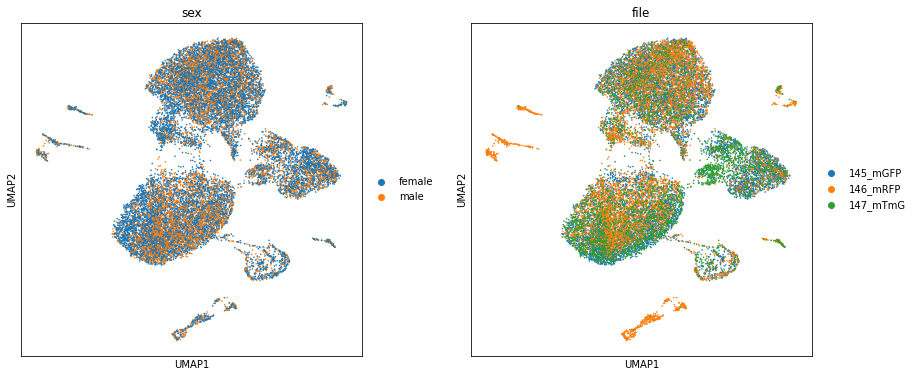

In [19]:
del adata_scl.uns['sex_colors']
rcParams['figure.figsize']=(6,6)
sc.pl.umap(adata_scl, color=['sex','file'] ,size=10, use_raw=False,wspace=0.2)

In [13]:
# Clustering resolution
res=0.4

In [14]:
# Cluster scaled data
sc.tl.leiden(adata_scl, resolution=res, key_added='leiden_scaled_r'+str(res), directed=True, use_weights=True)

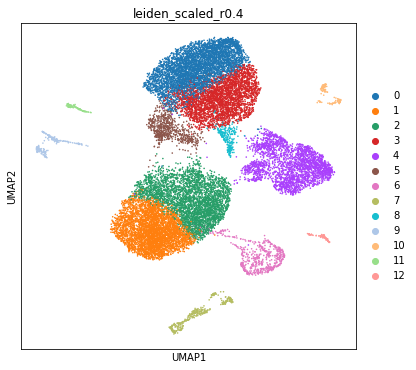

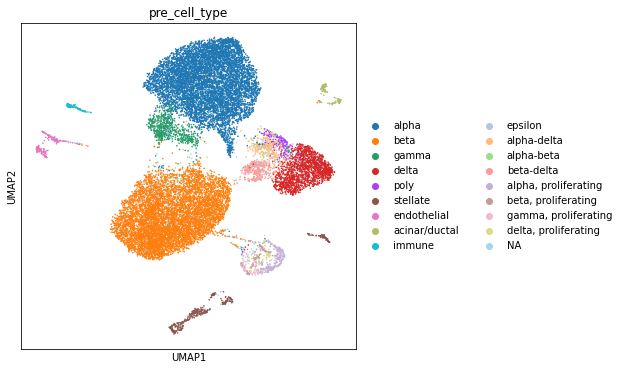

In [15]:
# Compare UMAPs and clusters on scaled data
rcParams['figure.figsize']=(6,6)
sc.pl.umap(adata_scl, color=['leiden_scaled_r'+str(res)] ,size=10, use_raw=False)
sc.pl.umap(adata_scl, color=['pre_cell_type'] ,size=10, use_raw=False)

#C: Umap and clustering on scaled data performs better.

## Cell type annotation

In [16]:
# Normalise raw data for plotting and cell type scoring
adata_raw=adata_scl.raw.to_adata().copy()
sc.pp.normalize_total(adata_raw, target_sum=1e4, exclude_highly_expressed=True,inplace=False)
sc.pp.log1p(adata_raw)
adata_rawnormalised=adata_scl.copy()
adata_rawnormalised.raw=adata_raw
del adata_raw

In [4]:
# Markers data
markers=pd.read_excel('/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/gene_lists/markers.xlsx',
                          sheet_name='mice')

In [22]:
# Subset markers to non-immature and non-dedifferentiated for initial annotation
print('Subtypes (original):',markers.Subtype.unique())
remove_subtype=['immature','dedifferentiated']
remove_subtype=[]
markers_filter=markers.query('Subtype not in @remove_subtype')

Subtypes (original): ['mature' 'immature' nan 'dedifferentiated' 'activated' 'quiescent'
 'cytotoxic']


acinar


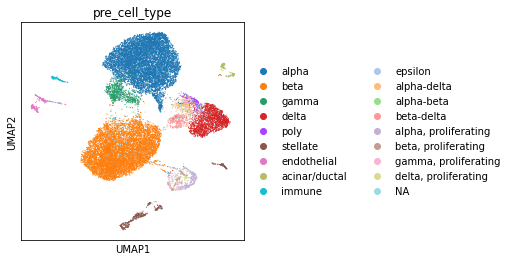

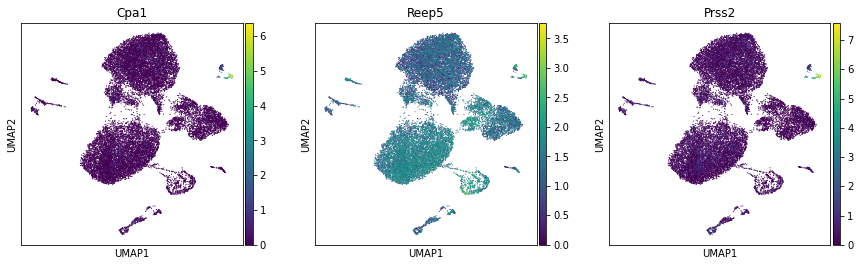

alpha


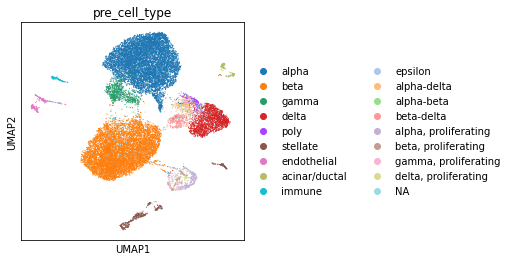

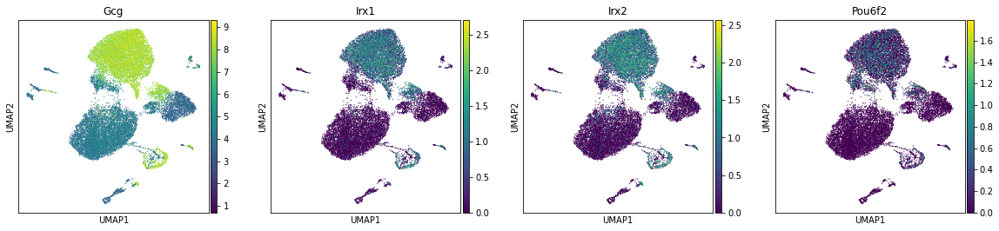

B immune


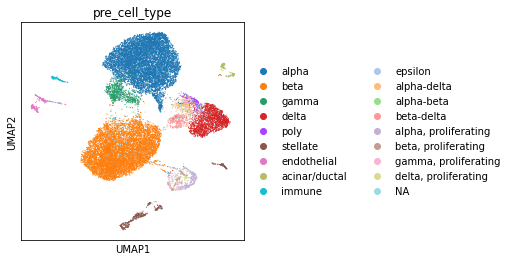

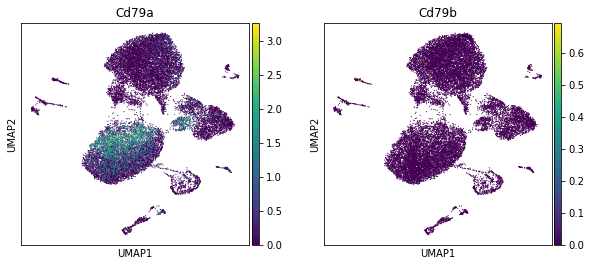

beta


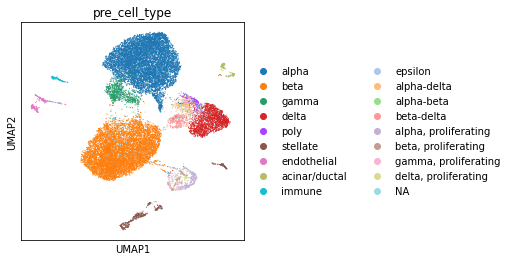

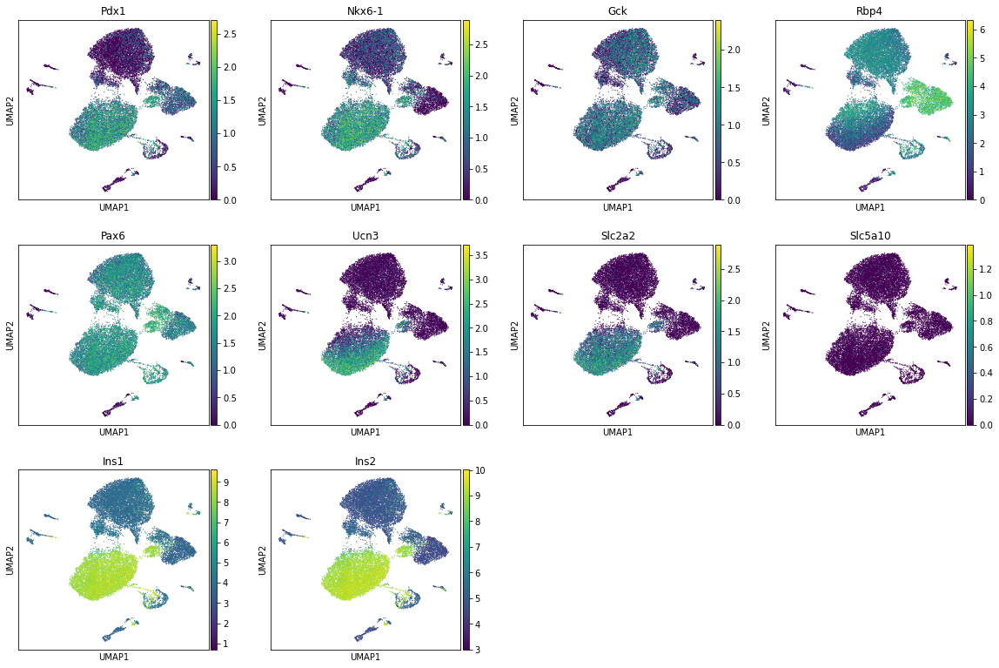

delta


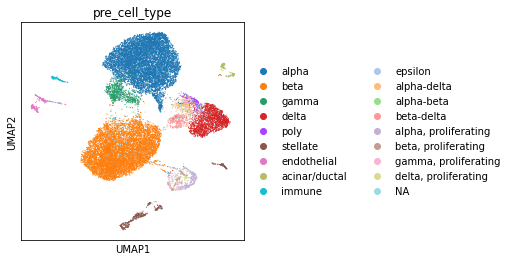

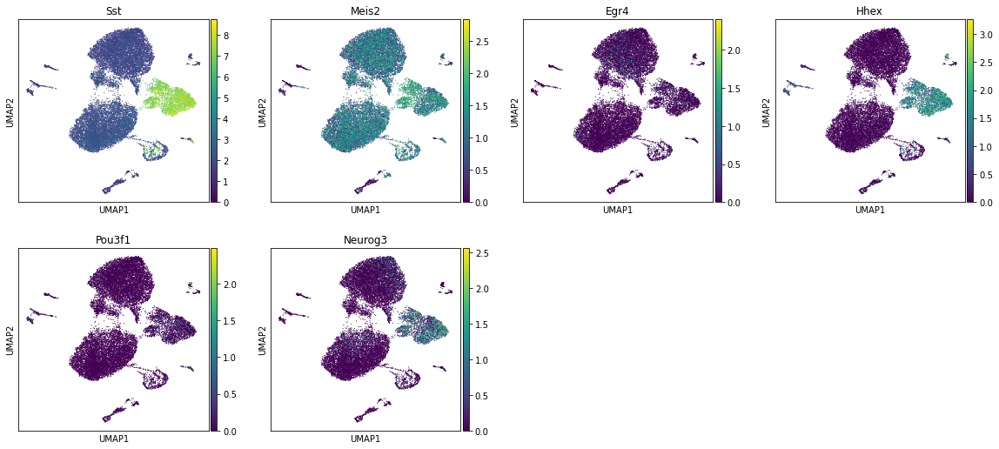

dendritic


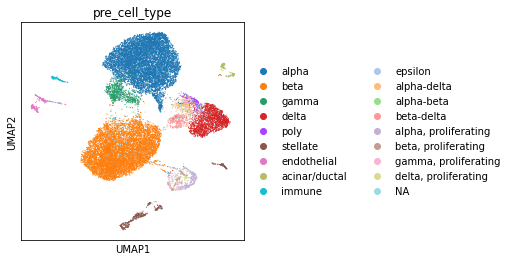

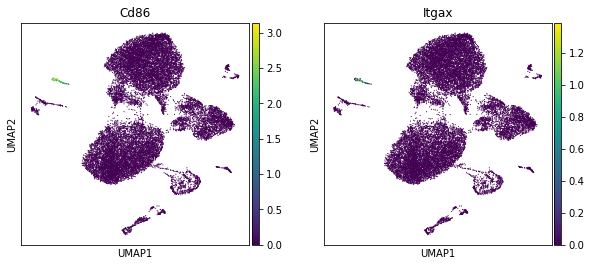

ductal


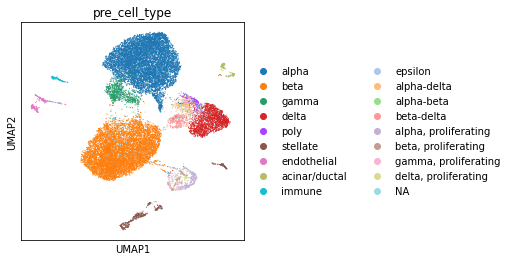

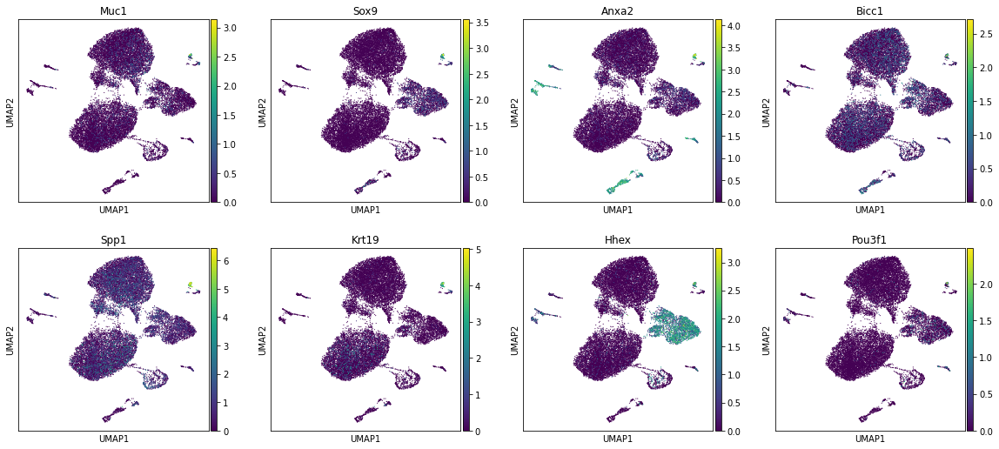

endocrine


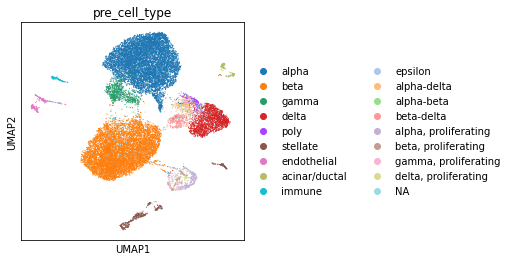

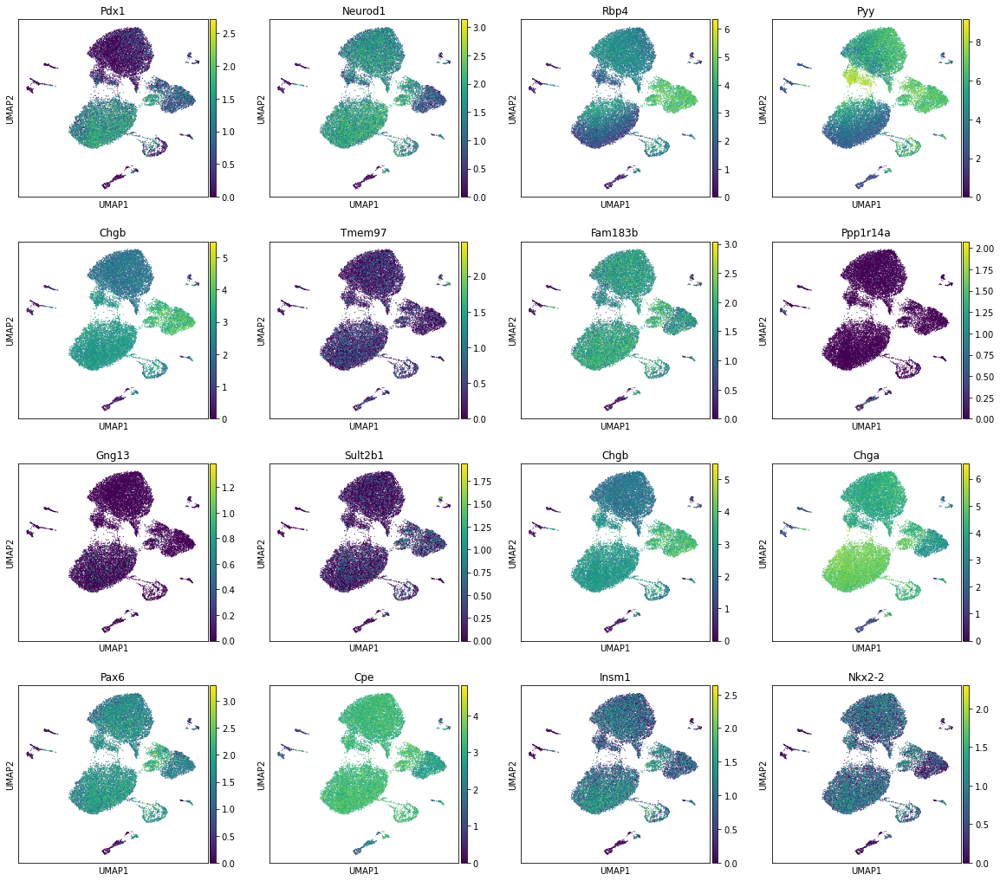

endothelial


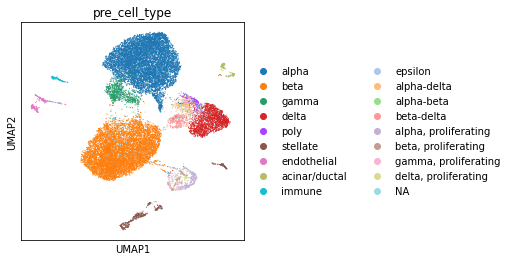

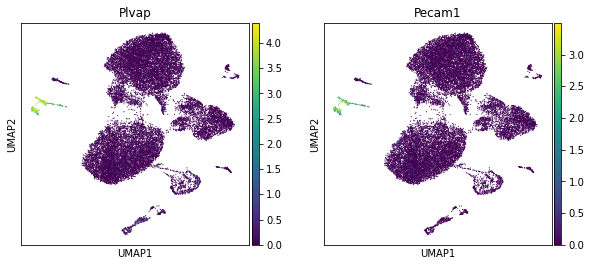

EP


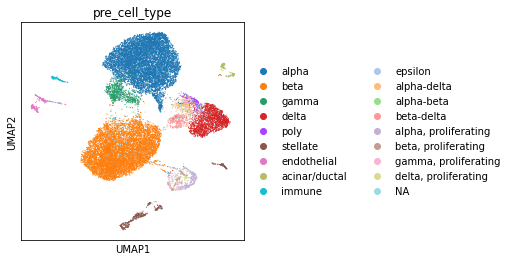

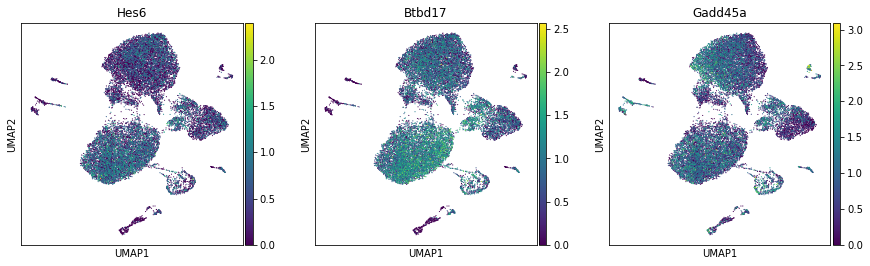

epithelial


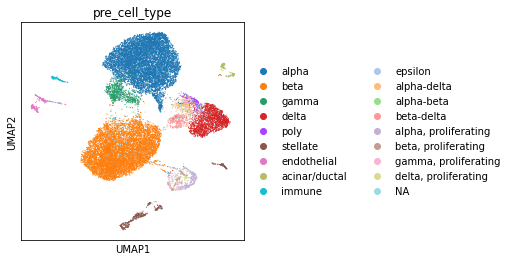

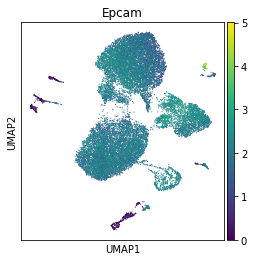

epsilon


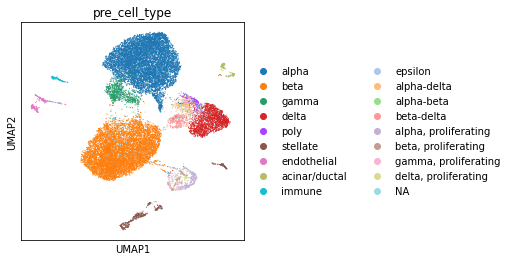

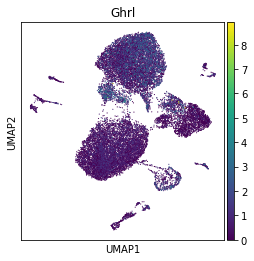

gamma


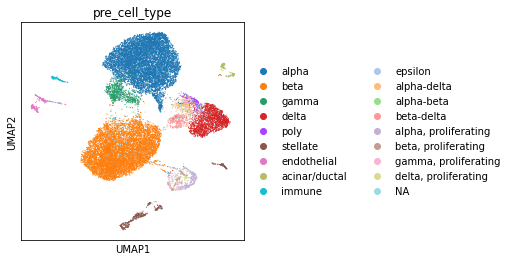

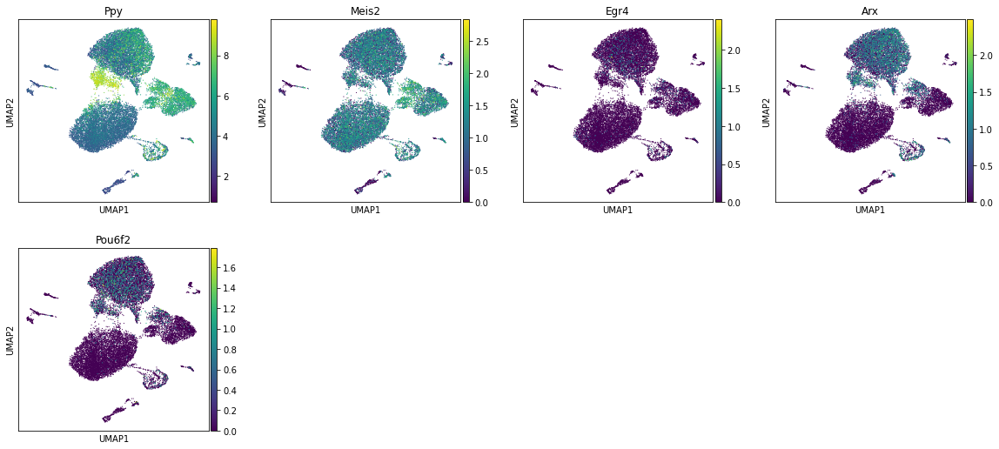

immune


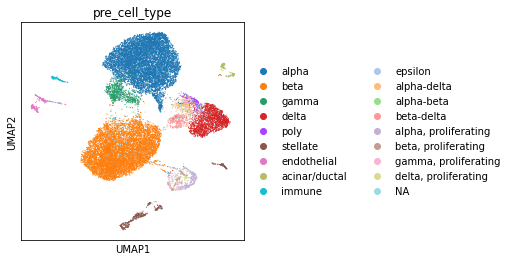

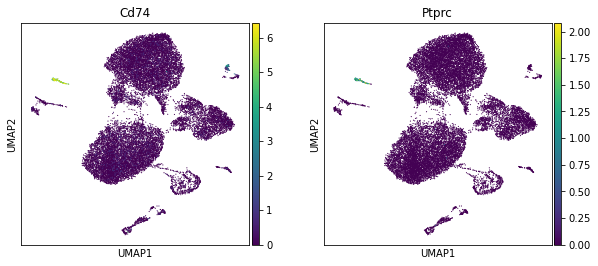

lymphocye


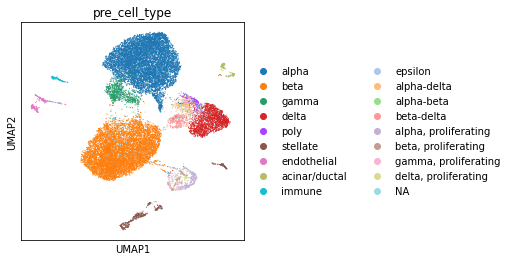

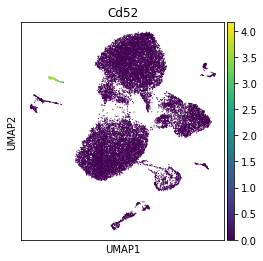

macrophage


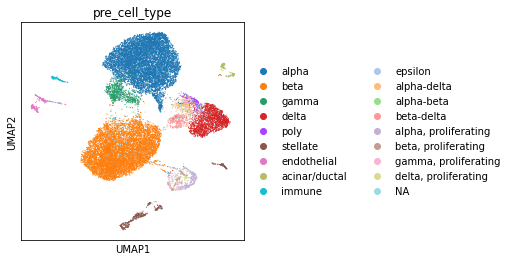

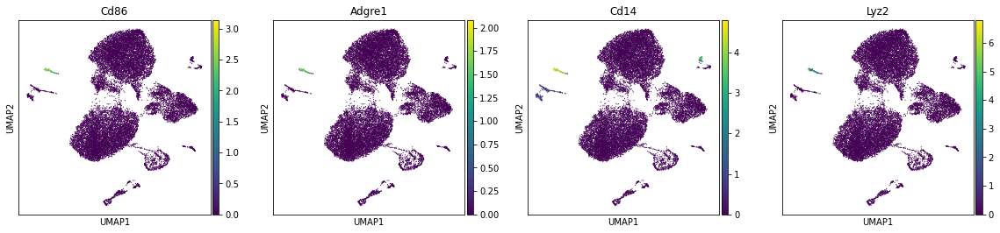

MPC


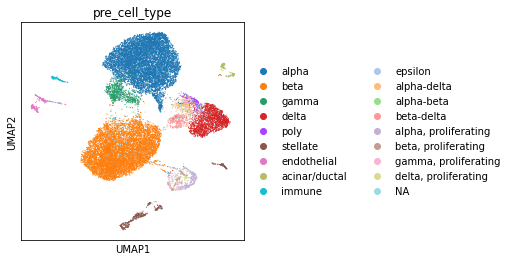

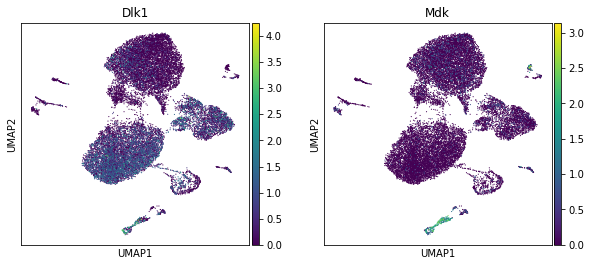

pericyte


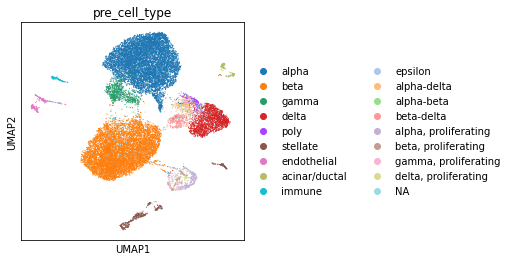

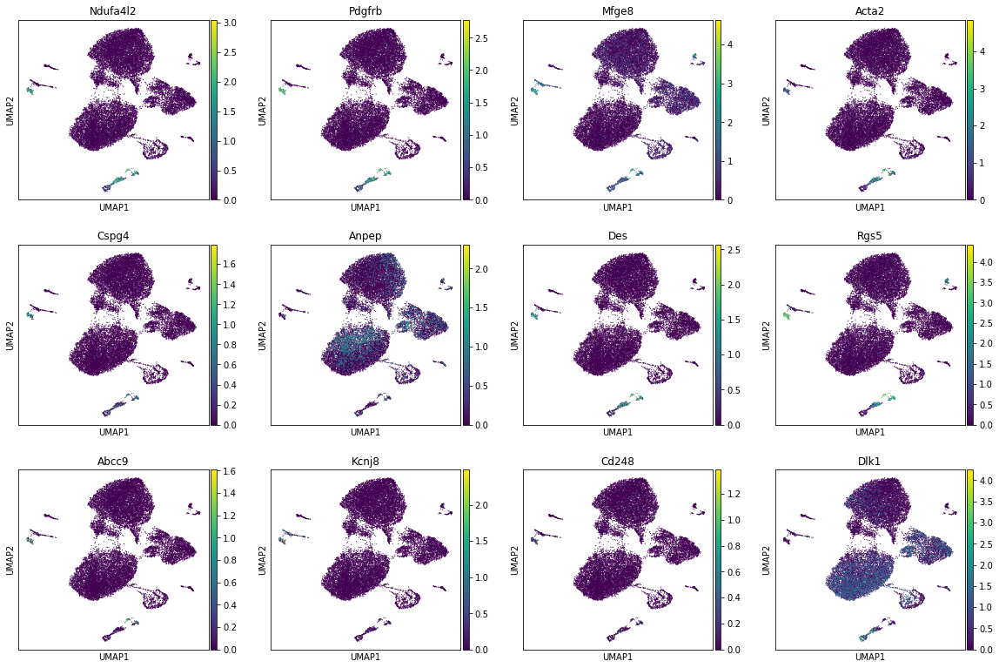

schwann


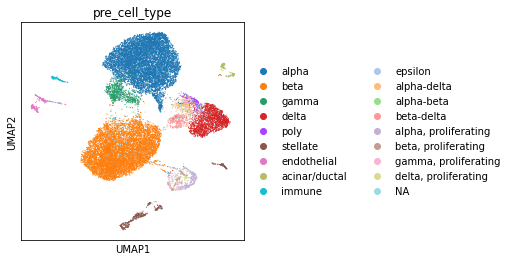

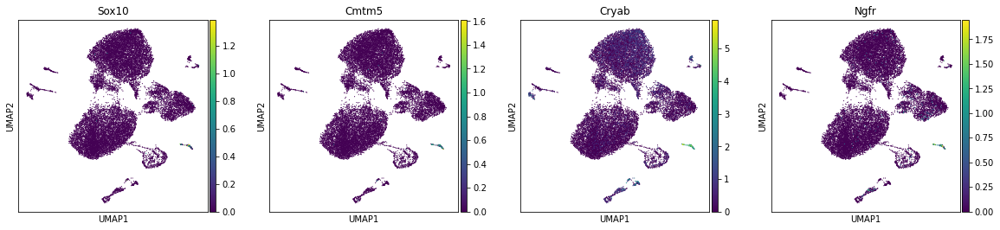

stellate


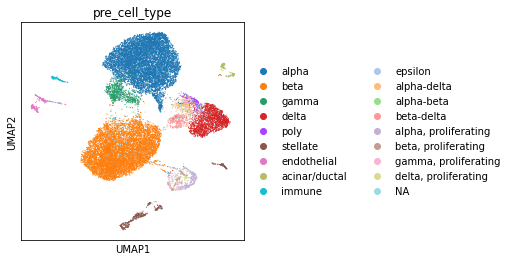

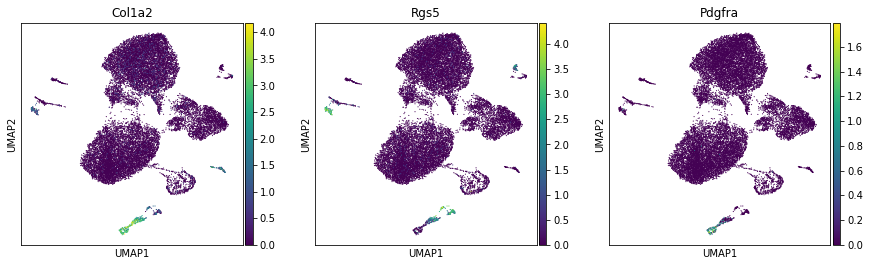

T immune


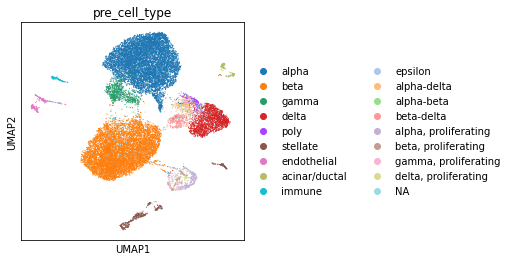

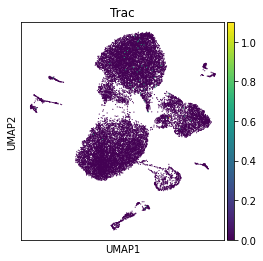

tip


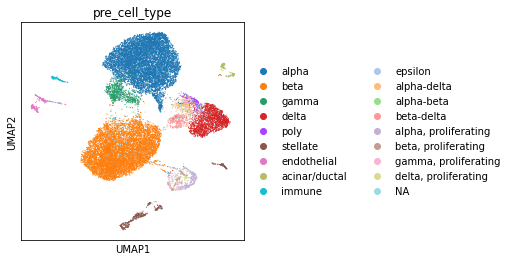

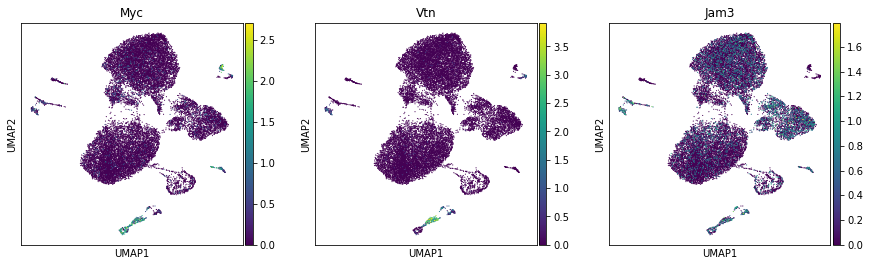

trunk


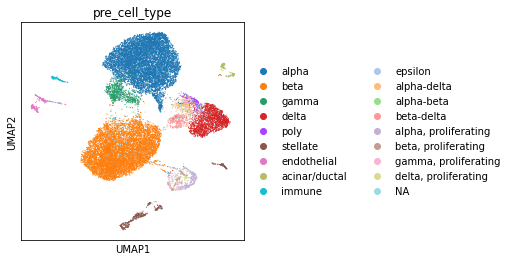

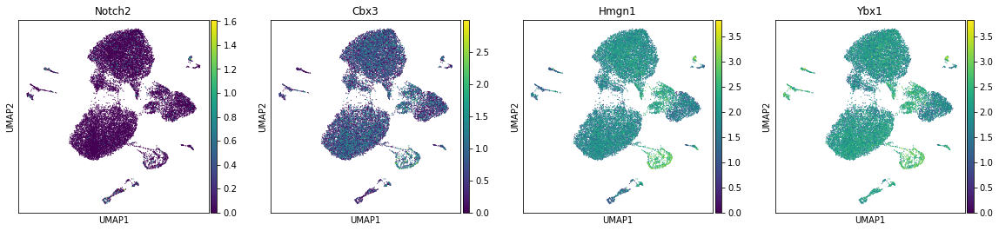

In [72]:
# Plot markers for each cell type
for cell_type in sorted(list(markers_filter.Cell.unique()), key=str.lower):
    print(cell_type)
    genes=list(markers_filter.query('Cell == "'+cell_type+'"').Gene)
    # Retain genes present in raw var_names
    genes=[gene for gene in genes if gene in adata.raw.var_names]
    rcParams['figure.figsize']=(4,4)
    sc.pl.umap(adata_rawnormalised, color=['pre_cell_type'],size=5, use_raw=True)
    sc.pl.umap(adata_rawnormalised, color=genes ,size=5, use_raw=True)

In [73]:
# Selected markers that seem to be able to distinguish between cell types
# Use only hormone genes for endocrine cells
markers_selection={
'immune':['Cd74','Ptprc','Cd86','Adgre1','Lyz2','Cd86','Itgax','Cd52'],
'schwann':['Sox10','Cmtm5','Cryab','Ngfr'],
'stellate':['Col1a2','Pdgfra'],
'endothelial':['Plvap','Pecam1'],
'pericyte':['Ndufa4l2','Pdgfrb','Acta2','Cspg4','Des','Rgs5','Abcc9'],
'acinar':['Cpa1','Prss2'],
'ductal':['Muc1','Sox9','Spp1','Krt19'],
'alpha':['Gcg',],
'beta':['Ins1','Ins2'],
'delta':['Sst'],
'gamma':['Ppy'],
'epsilon':['Ghrl']
}

#markers_selection={
#'immune':['Cd74','Ptprc','Cd86','Adgre1','Lyz2','Cd86','Itgax','Cd52'],
#'schwann':['Sox10'],
#'stellate':['Col1a2','Pdgfra'],
#'endothelial':['Plvap','Pecam1'],
#'ductal':['Muc1','Sox9','Spp1','Krt19'],
#'acinar':['Cpa1','Prss2'],
#'beta':['Slc2a2','Ins1','Ins2'],
#'alpha':['Gcg','Irx1','Irx2'],
#'delta':['Sst','Hhex','Neurog3'],
#'gamma':['Ppy'],
#'epsilon':['Ghrl']
#}

### Marker expression scores
Score each cell for marker expression of each cell type. Cells can thus be annotated qith 0 to N cell types. The presence of annotations is then checked for each cluster.

In [74]:
#Score cells for each cell type

# Save score column names 
scores=[]
for cell_type,genes in markers_selection.items():
    score_name=cell_type+'_score'
    scores.append(cell_type+'_score')
    sc.tl.score_genes(adata_rawnormalised, gene_list=genes, score_name=score_name,  use_raw=True)

In [75]:
# Which clusters (column name) to analyse for cell scores
res=0.4
clusters_col='leiden_scaled_r'+str(res)

In [76]:
# Add cluster information to the used adata
adata_rawnormalised.obs[clusters_col]=adata_scl.obs[clusters_col]

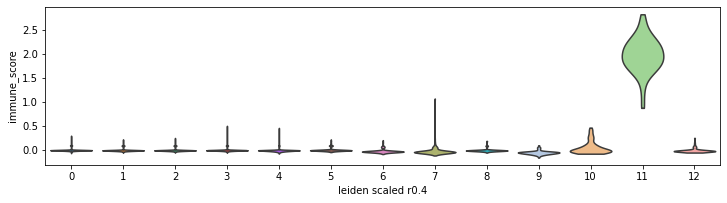

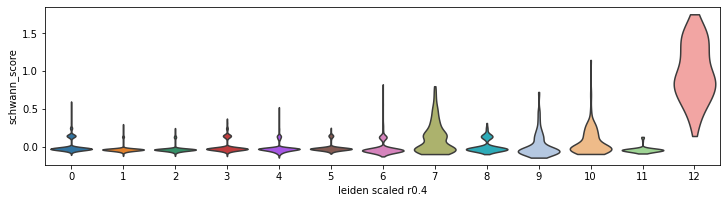

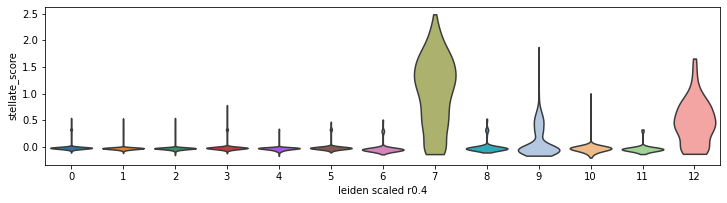

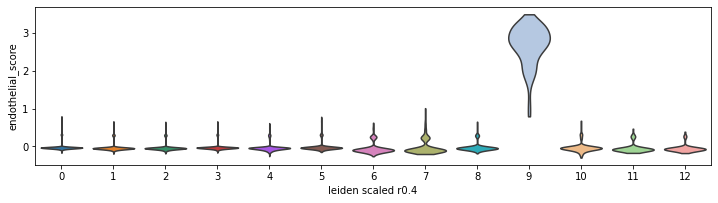

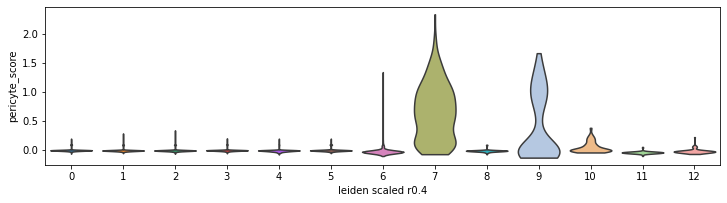

...

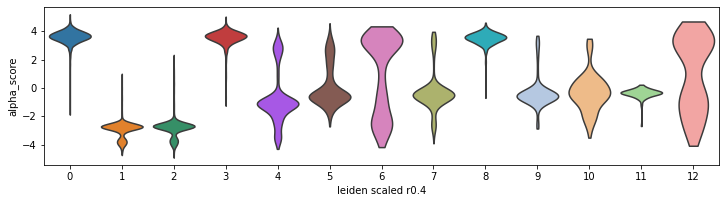

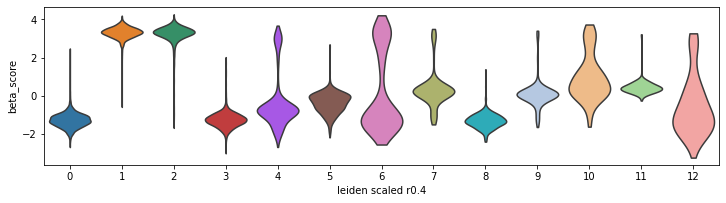

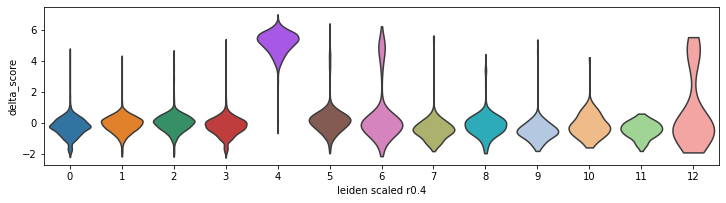

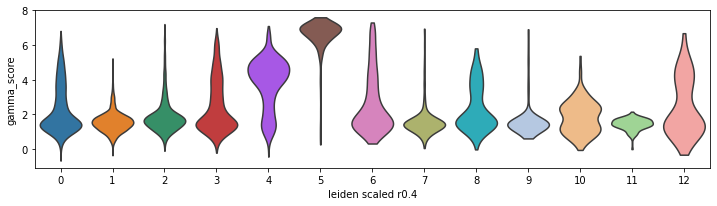

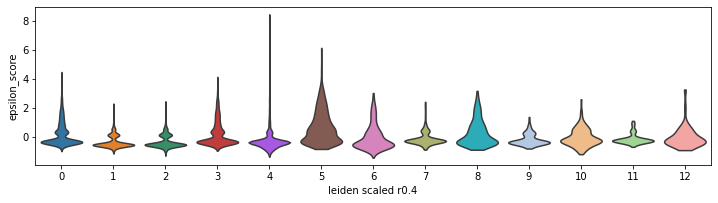

In [77]:
# Plot scores distribution across clusters
rcParams['figure.figsize']=(10,3)
for score in scores:
    sc.pl.violin(adata_rawnormalised, keys=score, groupby=clusters_col, use_raw=True, stripplot=False)

In [78]:
# Scores per cluster, scaled from 0 to 1 in each cell type
#C: Not very informative!
#scores_df=adata_rawnormalised.obs[scores+[clusters_col]]
#score_means=scores_df.groupby(clusters_col).mean()
#score_means=pd.DataFrame(pp.minmax_scale(score_means),index=score_means.index,columns=score_means.columns)
#sb.clustermap(score_means,yticklabels=1)

In [79]:
# Scores normalised to interval [0,1] for each cell type - so that they can be more easily compared
scores_df_norm=adata_rawnormalised.obs[scores]
scores_df_norm=pd.DataFrame(pp.minmax_scale(scores_df_norm),columns=scores_df_norm.columns,index=adata_rawnormalised.obs.index)

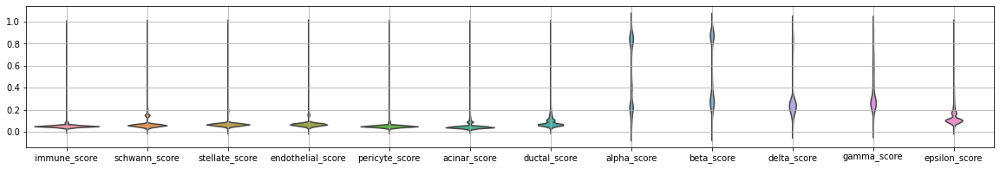

In [80]:
# Plot of normalised scores distribution in whole dataset, per cluster
rcParams['figure.figsize']=(20,3)
fig,ax=plt.subplots()
sb.violinplot(data=scores_df_norm,inner=None,ax=ax)
ax.grid()

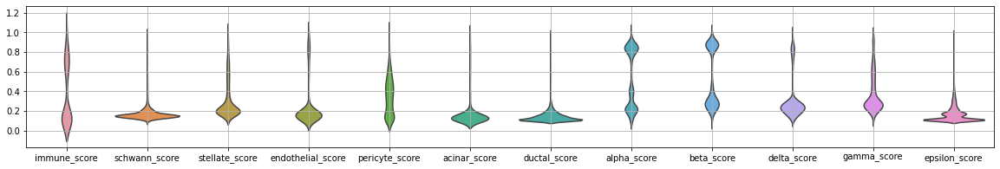

In [118]:
# Plot of normalised scores distribution, excluding low scores, per cluster
rcParams['figure.figsize']=(20,3)
fig,ax=plt.subplots()
sb.violinplot(data=scores_df_norm[scores_df_norm>0.1],inner=None,ax=ax)
ax.grid()

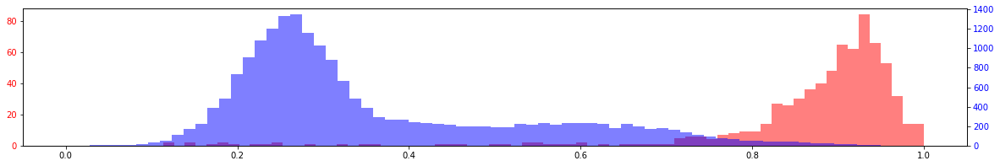

In [85]:
# Check gamma score in gamma cluster to reset the threshold
fig,ax1=plt.subplots()
a=ax1.hist(scores_df_norm.gamma_score[(adata_scl.obs[clusters_col]=='5').values],bins=70,alpha=0.5,color='r')
ax1.tick_params(axis='y', labelcolor='r')
ax2 = ax1.twinx()
a=ax2.hist(scores_df_norm.gamma_score[(adata_scl.obs[clusters_col]!='5').values],bins=70,alpha=0.5,color='b')
ax2.tick_params(axis='y', labelcolor='b')

In [162]:
# Thresholds for cell type assignemnt based on normalised scores
thresholds=[]
for col in scores_df_norm:
    threshold=0.55
    if col=='gamma_score':
        threshold=0.8
    elif col=='stellate_score':
        threshold=0.5
    elif col=='pericyte_score':
        threshold=0.25
    elif col =='immune_score' :
        threshold=0.4
    elif col =='epsilon_score' :
        threshold=0.8
    thresholds.append(threshold)

In [163]:
# Assign cell types based on scores to each cell
assignment_df=scores_df_norm>=thresholds
assignment_df.columns=[col.replace('_score','') for col in scores_df_norm.columns] 

In [164]:
# Count of cells per cell type
assignment_df[[col.replace('_score','') for col in scores_df_norm.columns]].sum()

immune           90
schwann          47
stellate        173
endothelial     185
pericyte        281
acinar           53
ductal           47
alpha          8876
beta           8153
delta          2705
gamma           901
epsilon           5
dtype: int64

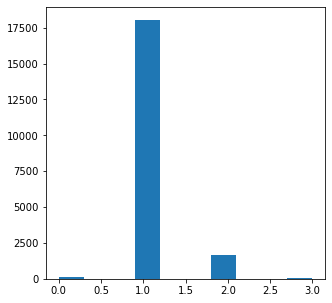

In [165]:
# How many cell types were annotated to each cell
a=plt.hist(assignment_df.sum(axis=1))

In [166]:
# For each cell make a (standard) string of annotated cell types: 
# e.g. each annotated cell type in the same order, separated by '_' when multiple cell types were annotated
type_unions=[]
for idx,row in assignment_df.iterrows():
    type_union=''
    for col in row.index:
        if row[col]:
            type_union=type_union+col+'_'
    if type_union=='':
        type_union='NA'
    type_unions.append(type_union.rstrip('_'))

In [167]:
# Add cell types strings of cells to scores/assignment DF
assignment_df['type_union']=type_unions
assignment_df[clusters_col]=adata_rawnormalised.obs[clusters_col].values

### Annotate clusters

In [43]:
def add_category(df,idxs,col,category):
    """
    Add single value to multiple rows of DF column (useful when column might be categorical). 
    If column is categorical the value is beforehand added in the list of present categories 
    (required for categorical columns). 
    :param df: DF to which to add values
    :param idxs: Index names of rows where the value should be assigned to the column.
    :param col: Column to which to add the value.
    :param category: The value to add to rows,column.
    """
    # If column is already present, is categorical and value is not in categories add the value to categories first.
    if col in df.columns and df[col].dtype.name=='category' and category not in df[col].cat.categories:
        df[col] = df[col].cat.add_categories([category])
    df.loc[idxs,col]=category

In [180]:
# Make DF of marker gene expressions (normalised, log transformed), scaled for each gene to [0,1]
used_markers=list(dict.fromkeys([marker for marker_list in markers_selection.values() for marker in marker_list]))
gene_idx=adata_rawnormalised.raw.var_names.isin(used_markers)
genes=adata_rawnormalised.raw.var_names[gene_idx]
scaled_expression=pd.DataFrame(pp.minmax_scale(adata_rawnormalised.raw.X.toarray()[:, gene_idx]),
                               columns=genes,index=adata_rawnormalised.obs.index
                              )[[marker for marker in used_markers if marker in genes]]


def subcluster(adata_cluster,res,original_cluster,assignment_df_temp,clusters_name_prefix='leiden_scaled_r'):
    """
    Cluster adata and add reult into cell type assignment DF. Plot the clustering on UMAP.
    Add name of the original cluster to which the adata belongs to new cluster names.
    Cluster column name: clusters_name_prefix+str(res) 
    :param adata_cluster: Adata (with already computed neighbours and UMAP) to cluster with leiden clustering. 
    :param res: Leiden resolution
    :param original_cluster: Original cluster name, new clusters are named 'original cluster'+'_'+'new cluster'
    :param assignment_df_temp: assignment_df to which to add clusters - should have same row order as adata
    :param clusters_name_prefix: Prefix for cluster column name.
    """
    clusters_col_name=clusters_name_prefix+str(res)
    sc.tl.leiden(adata_cluster, resolution=res, key_added=clusters_col_name, directed=True, use_weights=True)
    adata_cluster.obs[clusters_col_name]=[original_cluster+'_'+subcluster 
                                                 for subcluster in adata_cluster.obs[clusters_col_name]]
    sc.pl.umap(adata_cluster,color=clusters_col_name)
    time.sleep(1.0)
    
    assignment_df_temp['leiden_scaled_r'+str(res)]=adata_cluster.obs['leiden_scaled_r'+str(res)].values
    
def get_cluster_data(adata_original, cluster,cluster_col,assignment_df):
    """
    Subset adata and assignment_df to cluster.
    :param adata_original: Adata to subset.
    :param  cluster: Cluster for which to extract the data.
    :param cluster_col: Column where clusters are listed. Should be present in adata and assignment_df.
    :param assignment_df: DF with cell type assignmnets in column 'type_union' and cluster info. Should have index names
    that are present in adata.obs.index.
    :return: Subset of adata, assignment_df
    """
    adata_temp=adata_original[adata_original.obs[cluster_col]==cluster].copy()
    assignment_df_temp=pd.DataFrame(assignment_df.loc[adata_temp.obs.index,'type_union'])
    return adata_temp, assignment_df_temp

def cluster_annotate(assignment_df,cluster_col,present_threshold,nomain_threshold,
                     save,cluster_annotation,adata_main):
    """
    Loop through clusters, check present cell types and if there is no main cell type plot expression and QC metrics.
    For each cluster list proportion of present cell types.
    Expression (normalised, log transformed, [0,1] per gene scaled) is plotted for marker genes across cells (heatmap).
    QC metrics are plotted as scatterplot of N genes and N counts with cluster cells overlayed over all cels.
    :param assignment_df: DF with cell type assignment in column 'type_union' and cluster assignment.
    :param cluster_col: Cluster column name in assignment_df.
    :param present_threshold: Count among present cell types each cell type present if it represents 
    at least present_threshold proportion of cells in cluster. 
    :param nomain_threshold: If only 1 cell type was selected with present_threshold and 
    no cell type is present at proportion at least nomain_threshold add 'other' to annotated cell types list.
    :param save: Save cluster information to adata_main (column 'cluster') and cell types list to cluster_annotation.
    :param cluster_annotation: Dict where each cluster (key) has list of annotated cell types (value).
    :param adata_main: Add cluster to adata_main.obs.cluster. Use this adata for plotting of QC mettrics (for this a
    column 'temp_selected' is added.)
    """
    for group in assignment_df[['type_union',cluster_col]].groupby(cluster_col):
        types_summary=group[1].type_union.value_counts(normalize=True)
        present=list(types_summary[types_summary >= present_threshold].index)
        if len(present)==1 and types_summary.max() < nomain_threshold:
            present.append('other')
            
        if save:
            cluster_annotation[group[0]]=present
            add_category(df=adata_main.obs,idxs=group[1].index,col='cluster',category=group[0])
        
        print('\nCluster:',group[0],'\tsize:',group[1].shape[0])    
        print('Present:',present)
        print(types_summary)
        
        #present_nonna=[cell_type for cell_type in present if cell_type !='NA']
        #if len(present_nonna)!=1:
        if len(present)!=1 or present==['NA']:
            sb.clustermap(
                pd.DataFrame(scaled_expression.loc[group[1].index,:]),
                col_cluster=False,xticklabels=1,yticklabels=False,figsize=(7,5))
            plt.title('Cluster: '+group[0]+' assigned:'+str(present))
            adata_main.obs['temp_selected']=adata_main.obs.index.isin(group[1].index)
            rcParams['figure.figsize']=(5,5)
            p1 = sc.pl.scatter(adata_main, 'n_counts', 'n_genes', color='temp_selected', size=40,color_map='viridis')
            time.sleep(1.0)

def save_cluster_annotation(adata,cluster_name,cell_types:list,cell_names):
    """
    Save cluster information for a set of cells to cluster_annotation (from outer scope) dictionary and specified adata.
    :param adata: Adata to which to save cluster name for cells. 
    Cluster information is saved to adata.obs in 'cluster' column.
    :param cluster_name: Name of the cluster.
    :param cell_types: List of cell types annotated to the cluster.
    :param cell_names: Cell names (matching adata.obs.index) to which the new cluster is asigned.
    """
    cluster_annotation[cluster_name]=cell_types
    add_category(df=adata.obs,idxs=cell_names,col='cluster',category=cluster_name)

In [240]:
#Save cell types annotated to each cluster
cluster_annotation=dict()


Cluster: 0 	size: 4464
Present: ['alpha']
alpha                0.982303
alpha_gamma          0.009857
alpha_delta          0.002912
NA                   0.002688
alpha_beta           0.001120
beta                 0.000448
alpha_delta_gamma    0.000224
alpha_beta_delta     0.000224
gamma                0.000224
Name: type_union, dtype: float64

Cluster: 1 	size: 3978
Present: ['beta']
beta          0.997738
beta_delta    0.001508
alpha_beta    0.000503
NA            0.000251
Name: type_union, dtype: float64

Cluster: 2 	size: 3481
Present: ['beta']
beta                0.975007
NA                  0.006033
alpha_beta          0.005458
beta_gamma          0.004884
gamma               0.003447
beta_delta          0.003160
alpha               0.001149
alpha_gamma         0.000287
delta_gamma         0.000287
beta_delta_gamma    0.000287
Name: type_union, dtype: float64

Cluster: 3 	size: 3056
Present: ['alpha']
alpha               0.959097
alpha_gamma         0.024869
alpha_beta          0

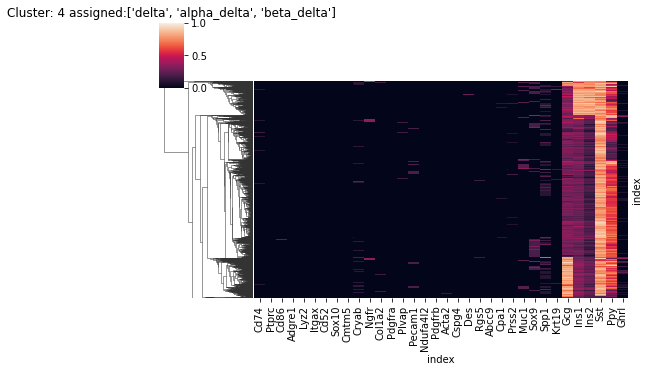

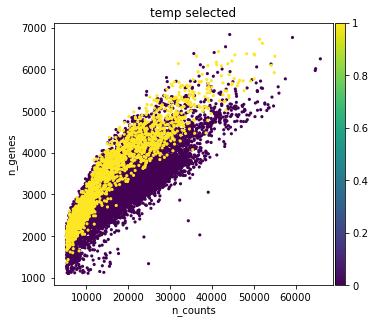


Cluster: 5 	size: 701
Present: ['gamma', 'alpha_gamma']
gamma                0.673324
alpha_gamma          0.179743
alpha                0.075606
NA                   0.032810
delta_gamma          0.012839
alpha_delta_gamma    0.008559
delta                0.004280
beta_gamma           0.004280
alpha_delta          0.002853
beta_delta_gamma     0.002853
beta                 0.002853
Name: type_union, dtype: float64


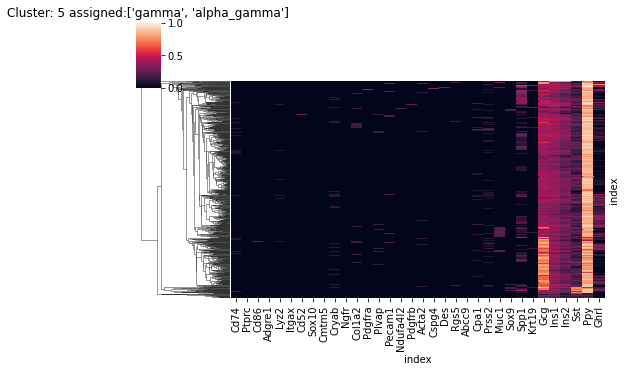

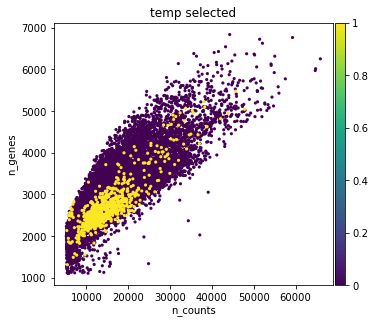


Cluster: 6 	size: 558
Present: ['alpha', 'beta']
alpha                0.478495
beta                 0.279570
delta                0.071685
alpha_delta          0.053763
gamma                0.043011
alpha_beta           0.028674
alpha_gamma          0.017921
beta_delta           0.012545
alpha_beta_delta     0.005376
beta_gamma           0.003584
NA                   0.003584
alpha_delta_gamma    0.001792
Name: type_union, dtype: float64


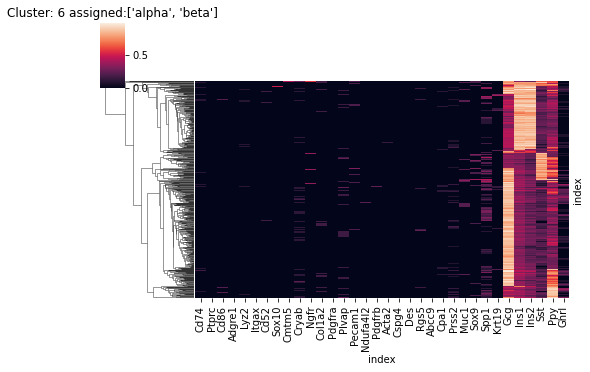

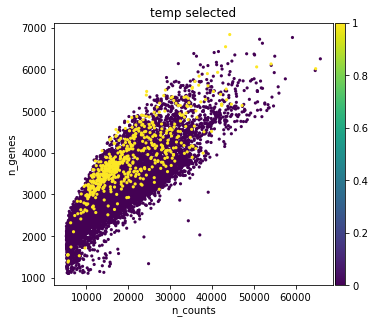


Cluster: 7 	size: 336
Present: ['stellate', 'pericyte', 'stellate_pericyte']
stellate                   0.294643
pericyte                   0.223214
stellate_pericyte          0.175595
pericyte_alpha             0.095238
pericyte_beta              0.077381
NA                         0.068452
pericyte_delta             0.011905
stellate_beta              0.008929
pericyte_gamma             0.005952
alpha                      0.005952
beta                       0.005952
stellate_pericyte_alpha    0.005952
immune_stellate            0.002976
stellate_acinar            0.002976
stellate_alpha             0.002976
pericyte_alpha_delta       0.002976
pericyte_beta_gamma        0.002976
stellate_alpha_beta        0.002976
pericyte_alpha_beta        0.002976
Name: type_union, dtype: float64


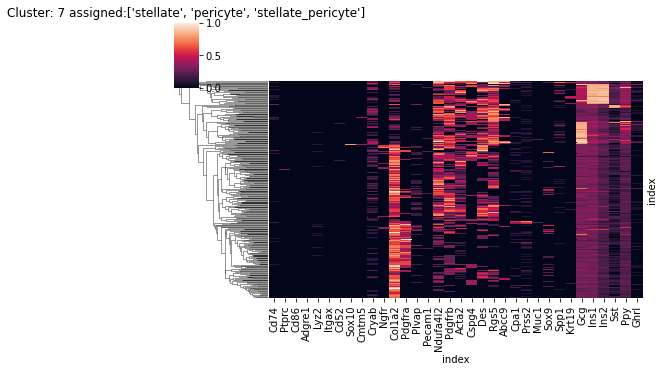

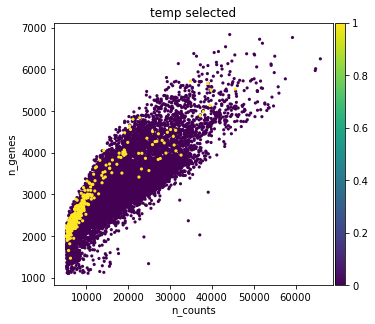


Cluster: 8 	size: 247
Present: ['alpha']
alpha          0.979757
alpha_delta    0.012146
alpha_beta     0.004049
delta          0.004049
Name: type_union, dtype: float64

Cluster: 9 	size: 196
Present: ['endothelial', 'endothelial_pericyte']
endothelial                0.433673
endothelial_pericyte       0.382653
endothelial_alpha          0.066327
endothelial_beta           0.035714
NA                         0.015306
alpha                      0.015306
beta                       0.010204
endothelial_alpha_delta    0.005102
delta                      0.005102
stellate_endothelial       0.005102
pericyte                   0.005102
endothelial_alpha_gamma    0.005102
endothelial_alpha_beta     0.005102
endothelial_gamma          0.005102
alpha_gamma                0.005102
Name: type_union, dtype: float64


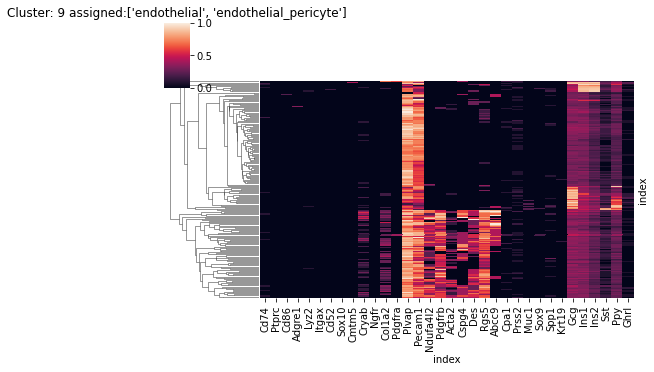

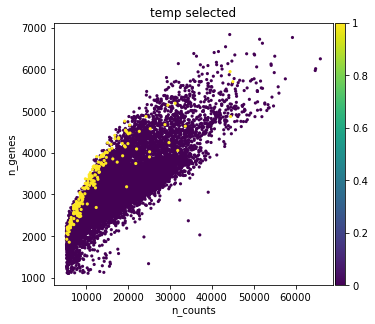


Cluster: 10 	size: 132
Present: ['ductal', 'acinar_beta', 'NA']
ductal               0.280303
acinar_beta          0.250000
NA                   0.143939
beta                 0.090909
acinar_alpha_beta    0.053030
acinar               0.037879
acinar_alpha         0.030303
ductal_beta          0.030303
alpha                0.022727
ductal_alpha         0.022727
acinar_ductal        0.015152
schwann_acinar       0.007576
alpha_beta           0.007576
delta                0.007576
Name: type_union, dtype: float64


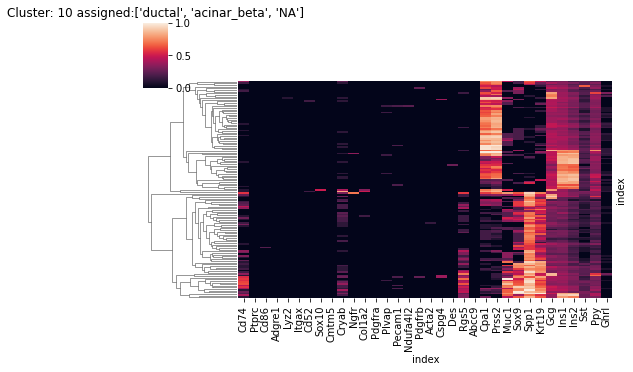

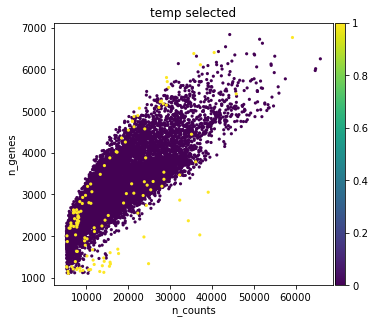


Cluster: 11 	size: 91
Present: ['immune']
immune           0.956044
NA               0.021978
immune_beta      0.010989
immune_ductal    0.010989
Name: type_union, dtype: float64

Cluster: 12 	size: 85
Present: ['schwann_alpha', 'alpha', 'schwann']
schwann_alpha             0.235294
alpha                     0.188235
schwann                   0.105882
schwann_beta              0.070588
NA                        0.058824
alpha_delta               0.058824
delta                     0.058824
schwann_beta_delta        0.035294
beta                      0.035294
schwann_delta             0.035294
stellate_alpha            0.023529
schwann_stellate          0.023529
schwann_stellate_delta    0.011765
beta_delta                0.011765
alpha_beta                0.011765
schwann_gamma             0.011765
schwann_alpha_delta       0.011765
delta_gamma               0.011765
Name: type_union, dtype: float64


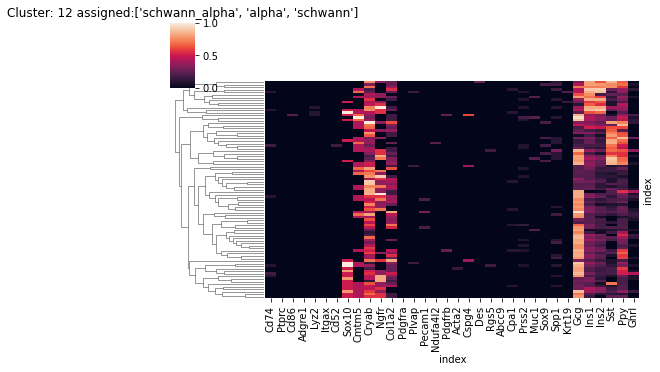

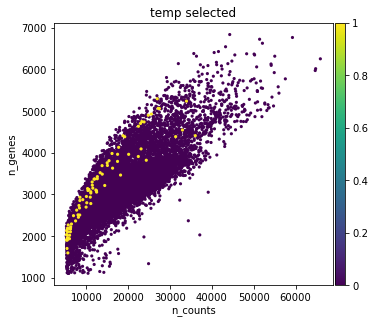

In [241]:
# Display cell type annotation distribution of each cluster.
cluster_annotate(assignment_df=assignment_df,
                 cluster_col=clusters_col,present_threshold=0.1,nomain_threshold=0.7,
                     save=True,cluster_annotation=cluster_annotation,adata_main=adata_rawnormalised)

In [242]:
# Reassign cell type of a cluster
cluster_annotation['12']=['schwann']

**** Original cluster 4


... storing 'leiden_scaled_r0.3' as categorical


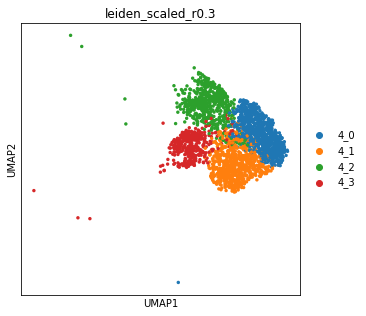


Cluster: 4_0 	size: 919
Present: ['delta']
delta          0.947769
alpha_delta    0.018498
beta_delta     0.016322
delta_gamma    0.013058
NA             0.004353
Name: type_union, dtype: float64

Cluster: 4_1 	size: 709
Present: ['delta']
delta                0.952045
alpha_delta          0.012694
delta_gamma          0.012694
beta_delta           0.012694
NA                   0.005642
beta_delta_gamma     0.001410
alpha_delta_gamma    0.001410
alpha_beta_delta     0.001410
Name: type_union, dtype: float64

Cluster: 4_2 	size: 567
Present: ['alpha_delta', 'delta']
alpha_delta          0.733686
delta                0.105820
delta_gamma          0.070547
beta_delta           0.021164
alpha_delta_gamma    0.017637
alpha_beta_delta     0.015873
alpha                0.014109
epsilon              0.008818
NA                   0.007055
beta_delta_gamma     0.003527
alpha_gamma          0.001764
Name: type_union, dtype: float64


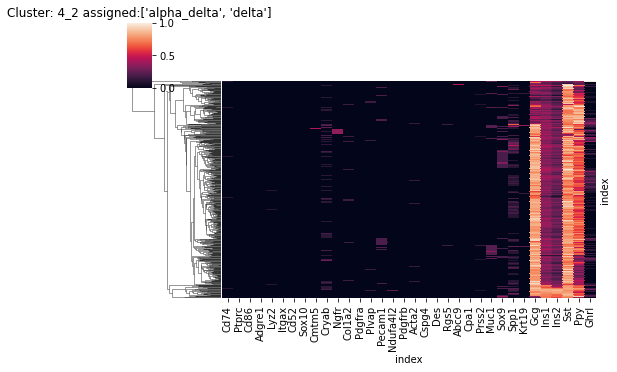

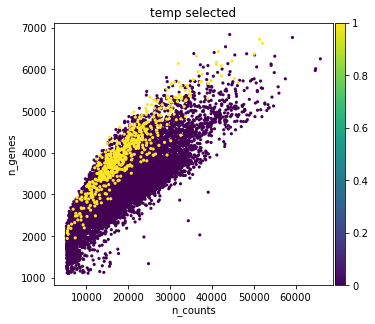

... storing 'leiden_scaled_r0.3' as categorical



Cluster: 4_3 	size: 361
Present: ['beta_delta']
beta_delta          0.927978
delta               0.033241
alpha_beta_delta    0.022161
beta_delta_gamma    0.005540
NA                  0.005540
delta_gamma         0.002770
beta                0.002770
Name: type_union, dtype: float64
**** Original cluster 5


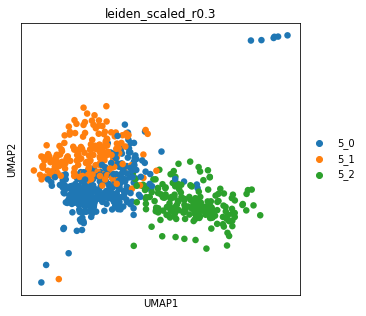


Cluster: 5_0 	size: 313
Present: ['gamma', 'alpha_gamma']
gamma                0.702875
alpha_gamma          0.166134
alpha                0.063898
delta_gamma          0.019169
NA                   0.015974
alpha_delta_gamma    0.009585
beta_gamma           0.006390
beta                 0.006390
alpha_delta          0.003195
beta_delta_gamma     0.003195
delta                0.003195
Name: type_union, dtype: float64


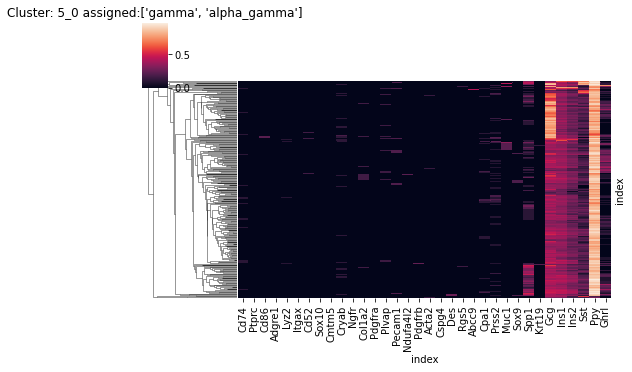

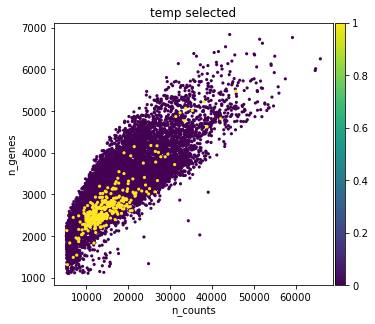


Cluster: 5_1 	size: 197
Present: ['gamma', 'alpha_gamma', 'alpha']
gamma                0.538071
alpha_gamma          0.223350
alpha                0.152284
NA                   0.055838
delta                0.010152
alpha_delta_gamma    0.010152
alpha_delta          0.005076
beta_delta_gamma     0.005076
Name: type_union, dtype: float64


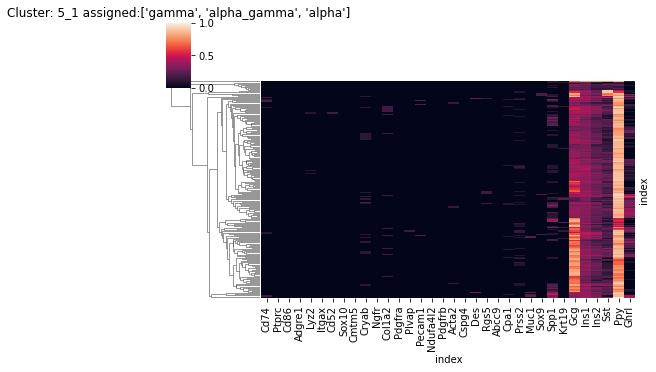

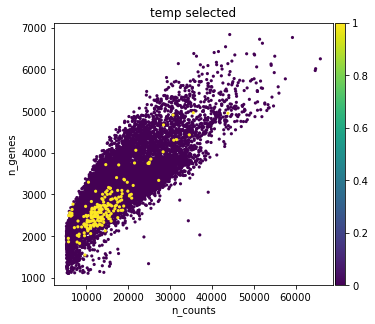


Cluster: 5_2 	size: 191
Present: ['gamma', 'alpha_gamma']
gamma                0.764398
alpha_gamma          0.157068
NA                   0.036649
alpha                0.015707
delta_gamma          0.015707
beta_gamma           0.005236
alpha_delta_gamma    0.005236
Name: type_union, dtype: float64


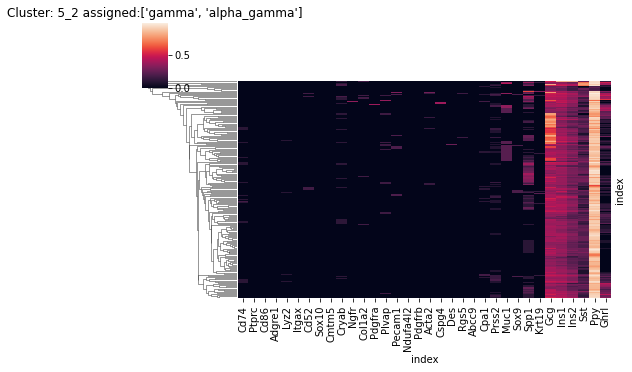

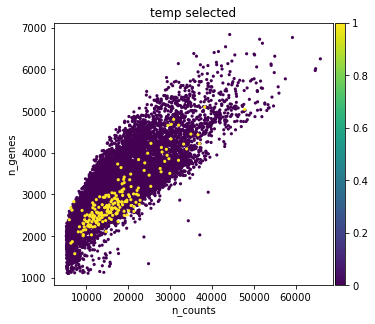

... storing 'leiden_scaled_r0.3' as categorical


**** Original cluster 6


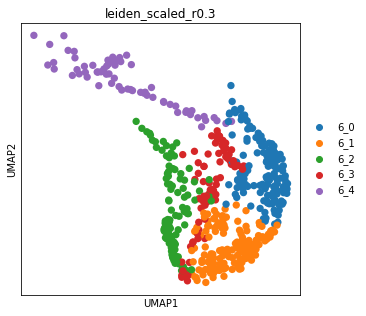


Cluster: 6_0 	size: 152
Present: ['alpha', 'delta']
alpha          0.684211
delta          0.125000
alpha_delta    0.065789
gamma          0.065789
alpha_gamma    0.032895
NA             0.006579
beta_delta     0.006579
alpha_beta     0.006579
beta           0.006579
Name: type_union, dtype: float64


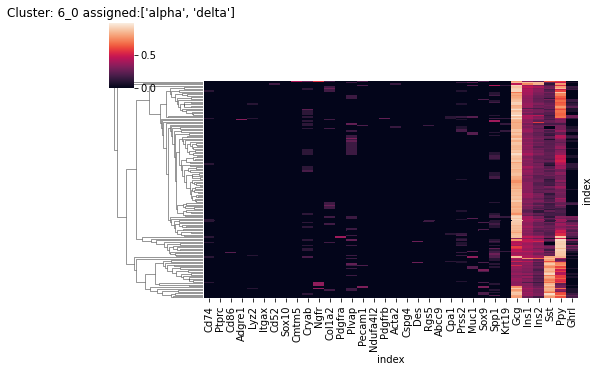

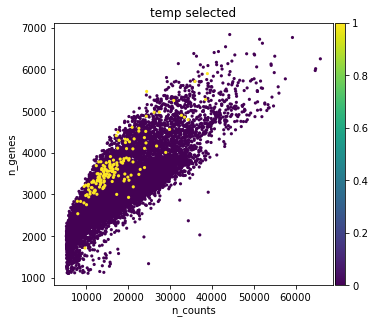


Cluster: 6_1 	size: 147
Present: ['alpha', 'other']
alpha                0.782313
delta                0.081633
gamma                0.054422
alpha_delta          0.027211
alpha_beta           0.020408
alpha_gamma          0.020408
alpha_delta_gamma    0.006803
beta_gamma           0.006803
Name: type_union, dtype: float64


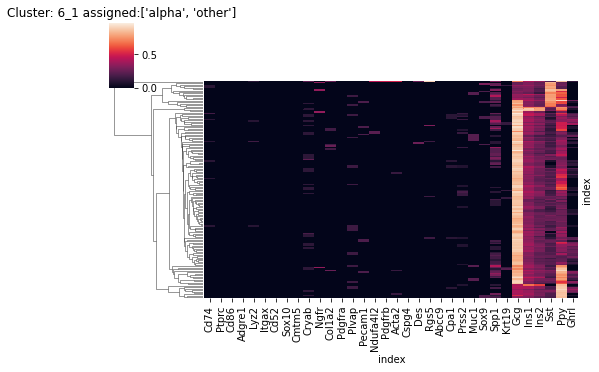

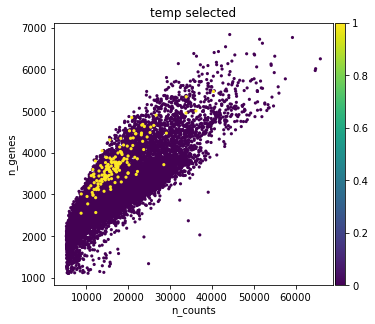


Cluster: 6_2 	size: 108
Present: ['alpha', 'alpha_delta', 'beta']
alpha               0.444444
alpha_delta         0.148148
beta                0.148148
delta               0.083333
alpha_beta          0.064815
gamma               0.037037
beta_delta          0.027778
alpha_beta_delta    0.027778
alpha_gamma         0.018519
Name: type_union, dtype: float64


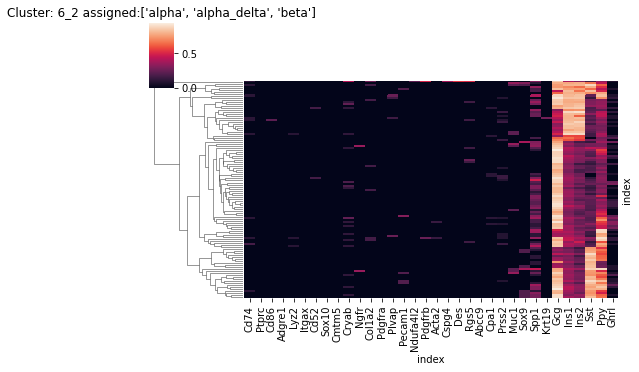

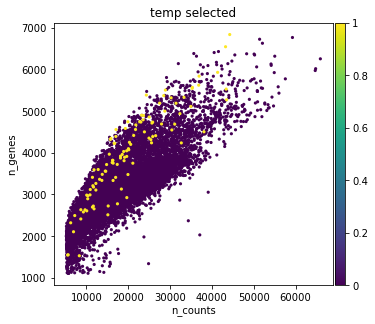

... storing 'leiden_scaled_r0.3' as categorical



Cluster: 6_3 	size: 86
Present: ['beta']
beta          0.930233
alpha_beta    0.034884
beta_delta    0.034884
Name: type_union, dtype: float64

Cluster: 6_4 	size: 65
Present: ['beta']
beta          0.907692
alpha_beta    0.030769
gamma         0.030769
NA            0.015385
beta_gamma    0.015385
Name: type_union, dtype: float64
**** Original cluster 7


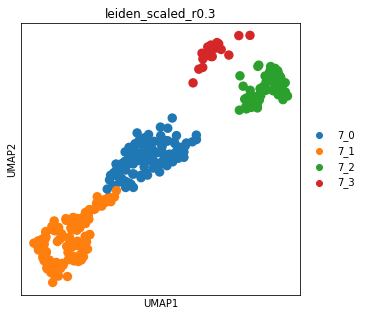


Cluster: 7_0 	size: 120
Present: ['stellate_pericyte', 'pericyte']
stellate_pericyte          0.441667
pericyte                   0.358333
NA                         0.083333
stellate                   0.075000
stellate_pericyte_alpha    0.016667
stellate_beta              0.008333
pericyte_alpha             0.008333
stellate_alpha_beta        0.008333
Name: type_union, dtype: float64


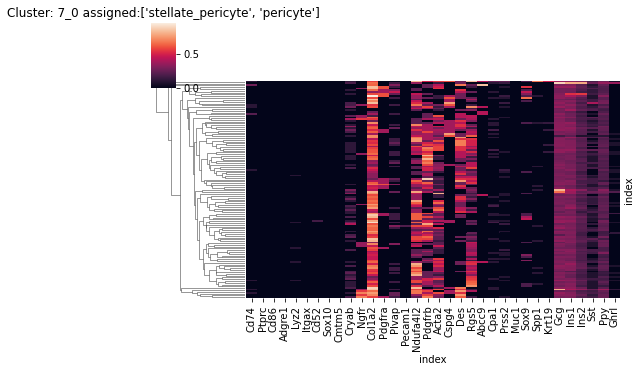

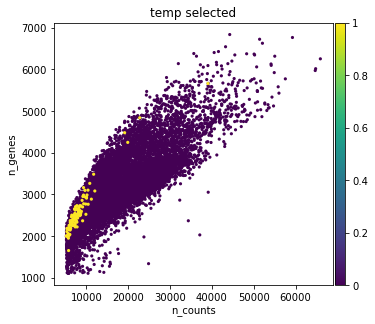


Cluster: 7_1 	size: 114
Present: ['stellate', 'NA']
stellate             0.789474
NA                   0.114035
stellate_pericyte    0.052632
stellate_beta        0.017544
stellate_acinar      0.008772
immune_stellate      0.008772
stellate_alpha       0.008772
Name: type_union, dtype: float64


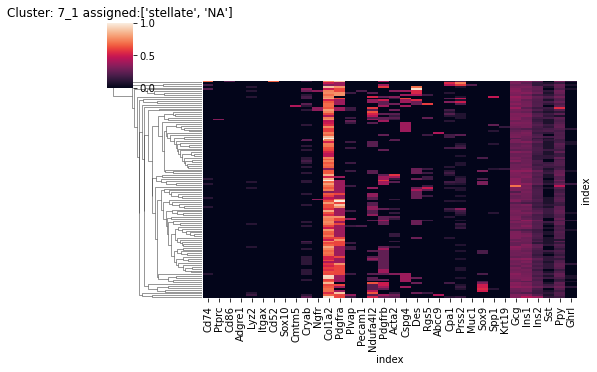

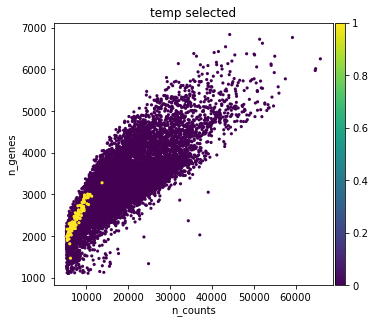


Cluster: 7_2 	size: 71
Present: ['pericyte_alpha', 'pericyte_beta']
pericyte_alpha          0.422535
pericyte_beta           0.366197
pericyte_delta          0.056338
alpha                   0.028169
pericyte                0.028169
pericyte_gamma          0.028169
beta                    0.028169
pericyte_alpha_beta     0.014085
pericyte_beta_gamma     0.014085
pericyte_alpha_delta    0.014085
Name: type_union, dtype: float64


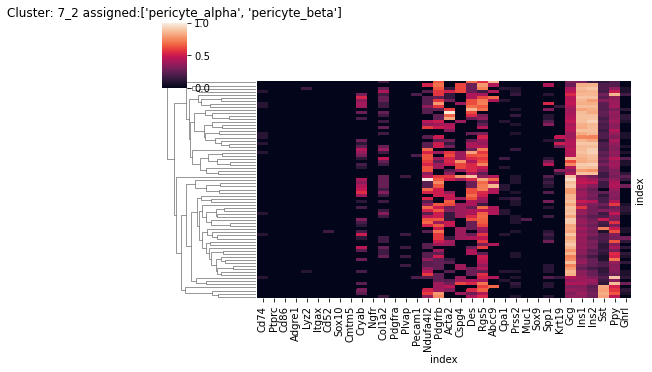

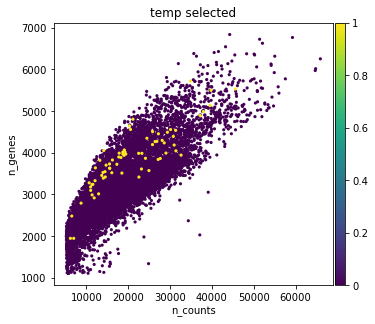

... storing 'leiden_scaled_r0.3' as categorical



Cluster: 7_3 	size: 31
Present: ['pericyte']
pericyte          0.967742
pericyte_alpha    0.032258
Name: type_union, dtype: float64
**** Original cluster 9


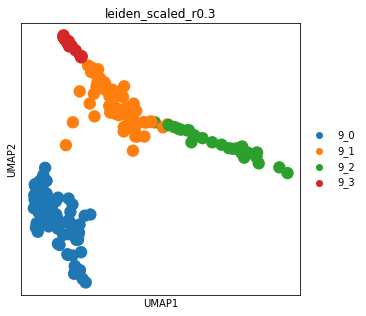


Cluster: 9_0 	size: 77
Present: ['endothelial_pericyte']
endothelial_pericyte    0.948052
endothelial             0.025974
stellate_endothelial    0.012987
pericyte                0.012987
Name: type_union, dtype: float64

Cluster: 9_1 	size: 70
Present: ['endothelial']
endothelial             0.914286
endothelial_pericyte    0.028571
NA                      0.028571
endothelial_alpha       0.014286
endothelial_beta        0.014286
Name: type_union, dtype: float64

Cluster: 9_2 	size: 32
Present: ['endothelial_alpha', 'endothelial_beta']
endothelial_alpha          0.37500
endothelial_beta           0.18750
alpha                      0.09375
endothelial                0.06250
beta                       0.06250
alpha_gamma                0.03125
endothelial_alpha_delta    0.03125
endothelial_alpha_beta     0.03125
delta                      0.03125
endothelial_gamma          0.03125
NA                         0.03125
endothelial_alpha_gamma    0.03125
Name: type_union, dtype: float64


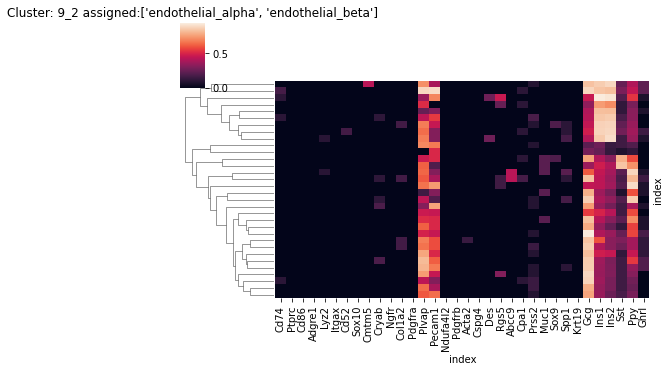

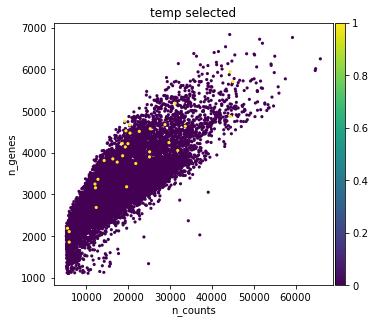

... storing 'leiden_scaled_r0.3' as categorical



Cluster: 9_3 	size: 17
Present: ['endothelial']
endothelial    1.0
Name: type_union, dtype: float64
**** Original cluster 10


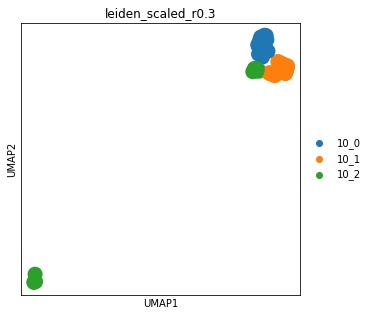


Cluster: 10_0 	size: 66
Present: ['ductal', 'NA']
ductal           0.560606
NA               0.287879
ductal_beta      0.060606
ductal_alpha     0.045455
alpha            0.030303
acinar_ductal    0.015152
Name: type_union, dtype: float64


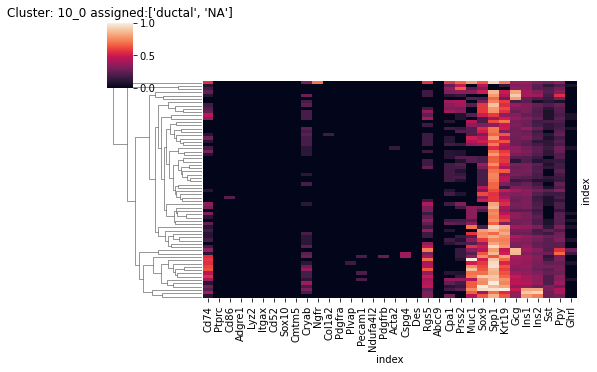

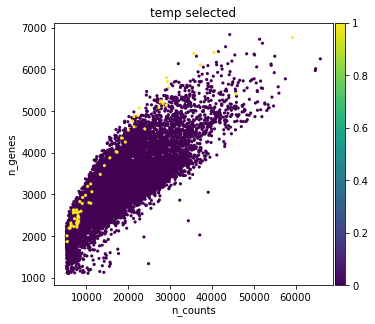


Cluster: 10_1 	size: 55
Present: ['acinar_beta', 'acinar_alpha_beta']
acinar_beta          0.600000
acinar_alpha_beta    0.127273
acinar               0.090909
acinar_alpha         0.072727
alpha                0.018182
schwann_acinar       0.018182
alpha_beta           0.018182
delta                0.018182
acinar_ductal        0.018182
beta                 0.018182
Name: type_union, dtype: float64


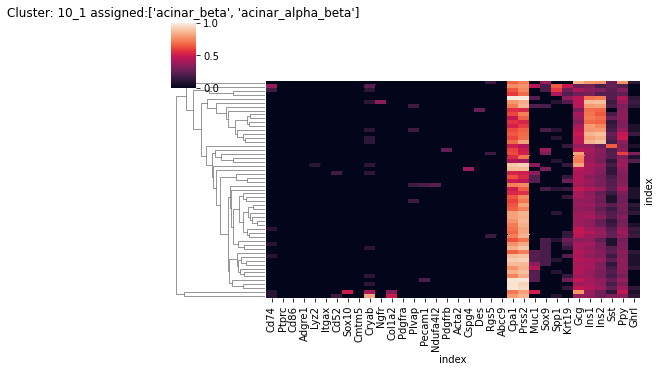

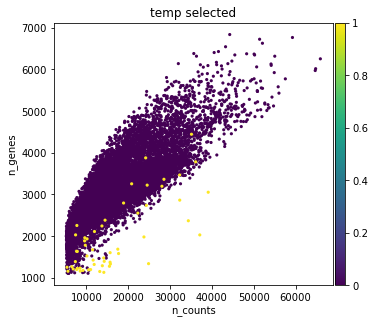


Cluster: 10_2 	size: 11
Present: ['beta']
beta    1.0
Name: type_union, dtype: float64


In [243]:
# recluster clusters that previously had less or more than 1 annotted cell type (exclusing NA and other).
for cluster in sorted(list(adata_rawnormalised.obs[clusters_col].unique()),key=int):
    if len(cluster_annotation[cluster]) != 1 or len(
        [cell_type for cell_type in cluster_annotation[cluster] if cell_type !='NA' and cell_type !='other']) == 0:
        print('**** Original cluster',cluster)
        res=0.3
        adata_temp,assignment_df_temp=get_cluster_data(adata_original=adata_rawnormalised, cluster=cluster,
                                                       cluster_col='cluster',assignment_df=assignment_df)
        subcluster(adata_cluster=adata_temp,res=res,original_cluster=cluster,assignment_df_temp=assignment_df_temp)
        cluster_annotate(assignment_df=assignment_df_temp,
                         cluster_col='leiden_scaled_r'+str(res),
                         # Use more leanient condition as this is already subclustered - 
                        # otherwise data could be in some cases subclustered almost idefinitely
                         present_threshold=0.1,nomain_threshold=0.9,
                     save=True,cluster_annotation=cluster_annotation,adata_main= adata_rawnormalised)

#C: Cluster 10_2 is besides acinar and ductal cells, but it has annotated beta - analyse it.

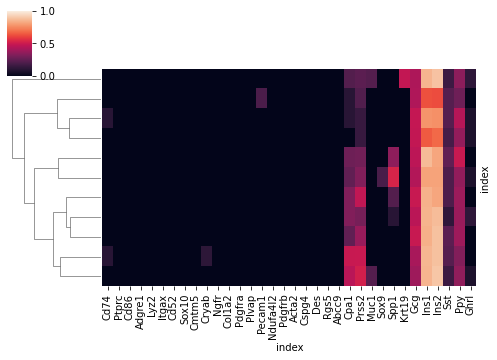

In [244]:
# Expression of markers in cluster 10_2
sb.clustermap(pd.DataFrame(scaled_expression.loc[adata_rawnormalised.obs.query('cluster=="10_2"').index,:]), 
                  row_cluster=row_cluster, col_cluster=False,xticklabels=1,yticklabels=False,figsize=(7,5),vmin=0,vmax=1)

#C: Different clustering resolutions were used and some of the clusters were subclustered, however this could not resolve some of the clusters that are comprised of multiple cell types.

#C: Part of beta cells clusters with acinar and ductal, thus this is named differently.

In [245]:
# Correct entries in cluster_annotation dict - all clusters that do not have exactly one entry will be assigned 'NA'
# If cluster is to be removed add 'remove'

# Cluster 6 will be adjusted for cell cycle to try to resolve cell typs better
cluster_annotation['7_0']=['stellate_pericyte']
cluster_annotation['7_1']=['stellate']
cluster_annotation['7_2']=['pericyte']
cluster_annotation['9_2']=['endothelial']
cluster_annotation['10_0']=['ductal']
cluster_annotation['10_1']=['acinar']
cluster_annotation['10_2']=['acinar_low']

#### Annotate cells from unsolvable clusters based on cell type score threshold
All those clusters are endocrine so strip any non-endocrine annotations from cell names.

In [246]:
# Get clusters that still do not have single cell type annotation
unsolvable=[]
for cluster in sorted(list(adata_rawnormalised.obs['cluster'].unique()),key=int):
    if len(cluster_annotation[cluster]) != 1:
        unsolvable.append(cluster)
print('Unsolvable clusters:',unsolvable)        

Unsolvable clusters: ['4_2', '5_0', '5_1', '5_2', '6_0', '6_1', '6_2']


In [247]:
# Get all cells from the clusters 
idx_unsolvable=adata_rawnormalised.obs.query('cluster in @unsolvable').index

In [248]:
# Make new assignments with only endocrine cell types (excluding epsilone)
type_unions=[]
for idx in idx_unsolvable:
    row=assignment_df.loc[idx,:]
    type_union=''
    # Use list comprehension instead of just the endocrine list so that names of cell types stay in the same order as above
    for col in [col for col in row.index if col in ['alpha','beta','delta','gamma','epsilon']]:
        if row[col]:
            type_union=type_union+col+'_'
    if type_union=='':
        type_union='NA'
    type_unions.append(type_union.rstrip('_'))

#Reasign cell types in assignment_df
assignment_df.loc[idx_unsolvable,'type_union']=type_unions

gamma N: 494


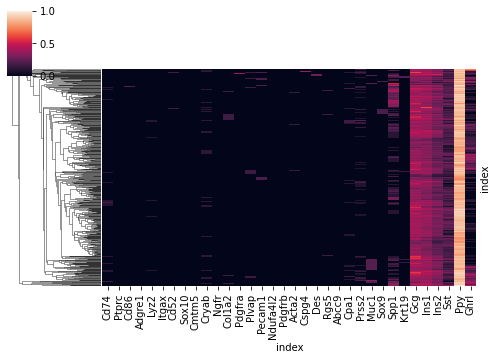

alpha_delta N: 448


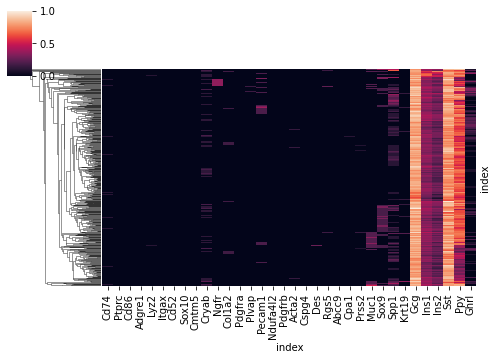

NA N: 28


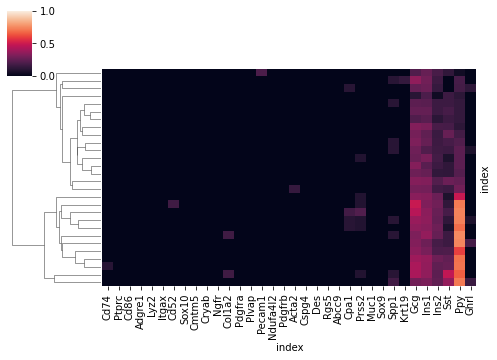

alpha N: 328


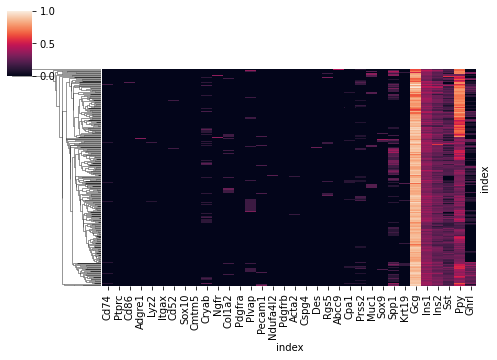

alpha_gamma N: 137


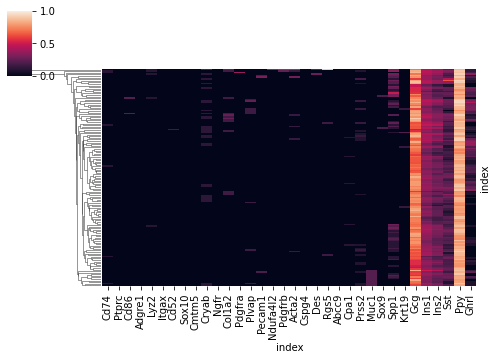

delta N: 103


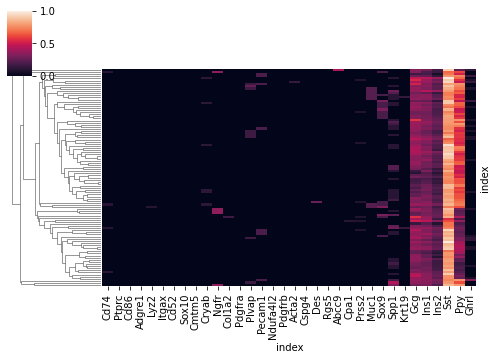

alpha_delta_gamma N: 17


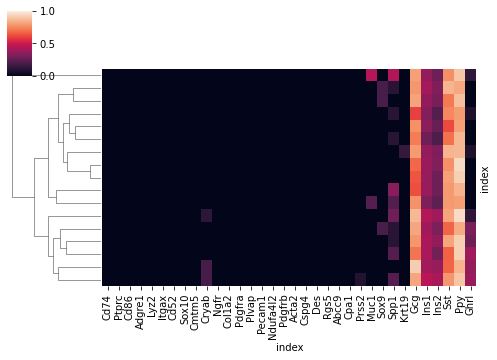

beta N: 19


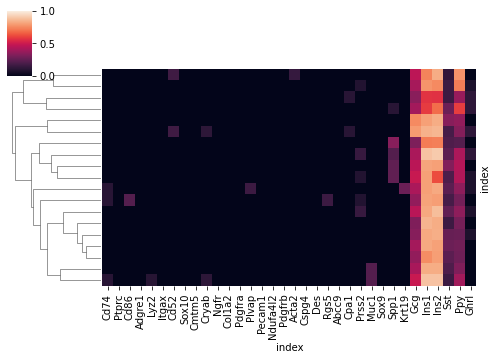

delta_gamma N: 49


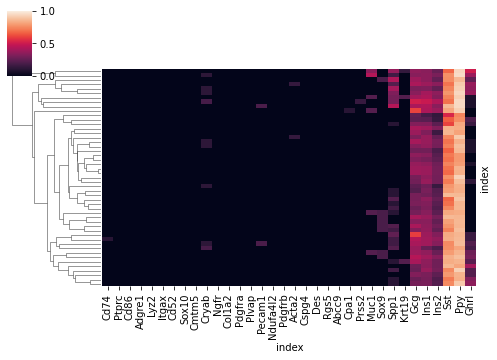

beta_delta N: 16


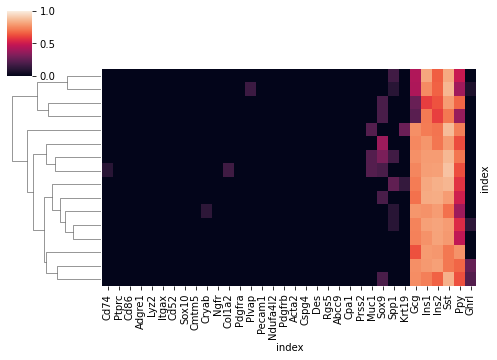

alpha_beta_delta N: 12


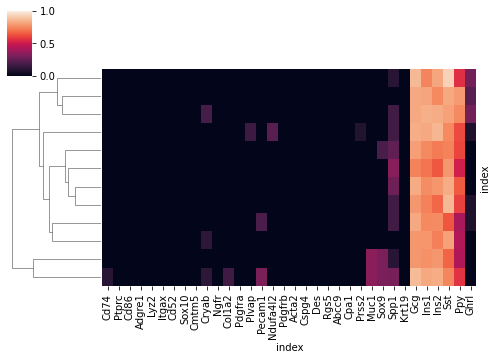

epsilon N: 5


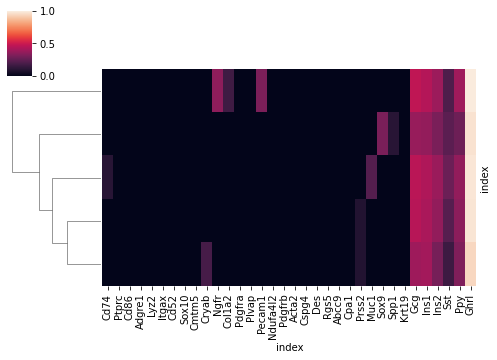

alpha_beta N: 11


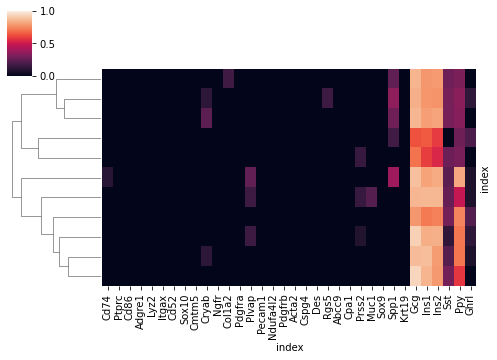

beta_gamma N: 4


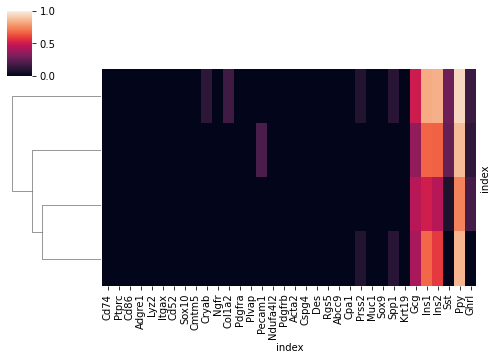

beta_delta_gamma N: 4


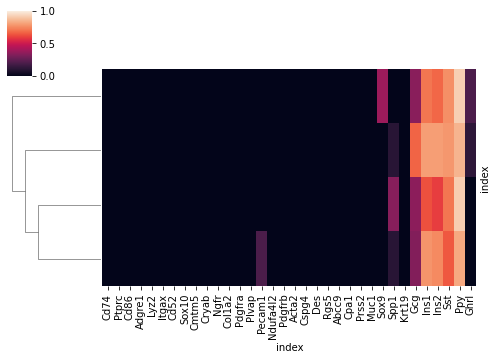

In [249]:
# Group unsolvable cells by cell type and plot expression to check if assignment was ok
for cell_type in assignment_df.loc[idx_unsolvable,'type_union'].unique():
    type_idx=assignment_df.loc[idx_unsolvable,:].query('type_union == "'+cell_type+'"').index
    print(cell_type,'N:',len(type_idx))
    row_cluster=True
    if len(type_idx)<2:
        row_cluster=False
    sb.clustermap(pd.DataFrame(scaled_expression.loc[type_idx,:]), 
                  row_cluster=row_cluster, col_cluster=False,xticklabels=1,yticklabels=False,figsize=(7,5),vmin=0,vmax=1)
    plt.show()
    time.sleep(1.0)

In [250]:
# Replace cluster names in adata and cluster_annotation with threshold based annotation
for cell_type in assignment_df.loc[idx_unsolvable,'type_union'].unique():
    # Subset assignment_df to idx_unsolvable before extracting idices of each cell type so that 
    # Cells from other clusters to not get assigned new clusters because they share phenotype
    type_idx=assignment_df.loc[idx_unsolvable,:].query('type_union == "'+cell_type+'"').index
    save_cluster_annotation(adata=adata_rawnormalised,cluster_name=cell_type,cell_types=[cell_type],cell_names=type_idx)

#### Resolve cluster involved in cell cycle - UNUSED

#### Add cluster based annotation to adata

In [251]:
# Display cluster annotation of clusters that will be used
clusters=list(adata_rawnormalised.obs['cluster'].unique())
clusters.sort()
for cluster in clusters:
    print(cluster ,cluster_annotation[cluster ])

0 ['alpha']
1 ['beta']
10_0 ['ductal']
10_1 ['acinar']
10_2 ['acinar_low']
11 ['immune']
12 ['schwann']
2 ['beta']
3 ['alpha']
4_0 ['delta']
4_1 ['delta']
4_3 ['beta_delta']
6_3 ['beta']
6_4 ['beta']
7_0 ['stellate_pericyte']
7_1 ['stellate']
7_2 ['pericyte']
7_3 ['pericyte']
8 ['alpha']
9_0 ['endothelial_pericyte']
9_1 ['endothelial']
9_2 ['endothelial']
9_3 ['endothelial']
NA ['NA']
alpha ['alpha']
alpha_beta ['alpha_beta']
alpha_beta_delta ['alpha_beta_delta']
alpha_delta ['alpha_delta']
alpha_delta_gamma ['alpha_delta_gamma']
alpha_gamma ['alpha_gamma']
beta ['beta']
beta_delta ['beta_delta']
beta_delta_gamma ['beta_delta_gamma']
beta_gamma ['beta_gamma']
delta ['delta']
delta_gamma ['delta_gamma']
epsilon ['epsilon']
gamma ['gamma']


In [252]:
# Add cell type annotation to clusters. 
# If clusters was annotated with more than one cell type (inbcluding NA or other) set it to 'NA'.
if 'cell_type' in adata_rawnormalised.obs.columns:
    adata_rawnormalised.obs.drop('cell_type',axis=1,inplace=True)
for row_idx in adata_rawnormalised.obs.index:
    cluster=adata_rawnormalised.obs.at[row_idx,'cluster']
    cell_type=cluster_annotation[cluster]
    if len(cell_type)!=1:
        cell_type='NA'
    else:
        cell_type=cell_type[0]
        
    add_category(df=adata_rawnormalised.obs,idxs=row_idx,col='cell_type',category=cell_type)

#### Annotate proliferative cells

In [253]:
for idx in adata_rawnormalised.obs.index[adata_rawnormalised.obs[clusters_col]=='6']:
    add_category(adata_rawnormalised.obs, idxs=[idx], col='cell_type',
                 category=adata_rawnormalised.obs.at[idx,'cell_type']+'_proliferative')
    add_category(adata_rawnormalised.obs, idxs=[idx], col='cluster',
                 category=adata_rawnormalised.obs.at[idx,'cluster']+'_proliferative')

#### Add rare cell types that do not have clusters - UNUSED

### Cell type annotation evaluation

In [254]:
# Add cell type to adata
adata.obs['cell_type']=adata_rawnormalised.obs.cell_type
# Add final clusters and starting clusters to adata
adata.obs[['cluster',clusters_col]]=adata_rawnormalised.obs[['cluster',clusters_col]]
# Add cell type scores
score_cols=[col for col in scores_df_norm.columns if '_score' in col]
adata.obs[score_cols]=scores_df_norm[score_cols].reindex(adata.obs.index)

... storing 'cell_type' as categorical


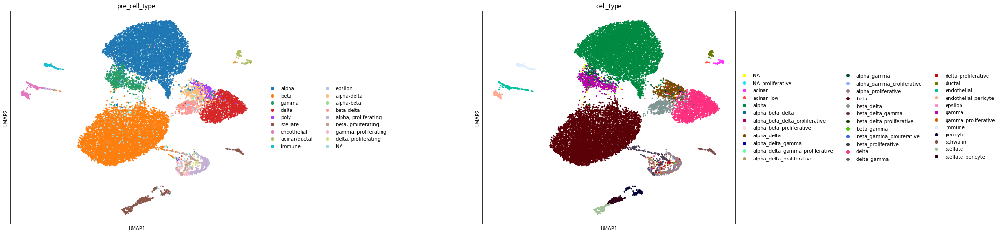

In [255]:
# Plot cell types on UMPA (pre-annotated and new ones)
rcParams['figure.figsize']=(8,8)
sc.pl.umap(adata_rawnormalised, color=['pre_cell_type','cell_type'], size=40, use_raw=False,wspace=0.7)

In [256]:
# Count of new cell types
adata_rawnormalised.obs.cell_type.value_counts()

alpha                              7828
beta                               7461
delta                              1691
gamma                               472
alpha_delta                         418
beta_delta                          373
alpha_proliferative                 267
beta_proliferative                  168
alpha_gamma                         127
stellate_pericyte                   120
endothelial                         119
stellate                            114
pericyte                            102
immune                               91
schwann                              85
endothelial_pericyte                 77
ductal                               66
acinar                               55
delta_gamma                          49
delta_proliferative                  40
alpha_delta_proliferative            30
NA                                   27
gamma_proliferative                  22
alpha_delta_gamma                    16
alpha_beta_proliferative             11


Text(0.5, 1.0, 'cell_type')

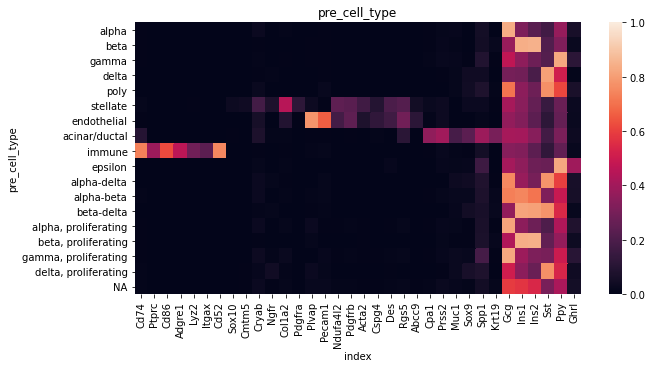

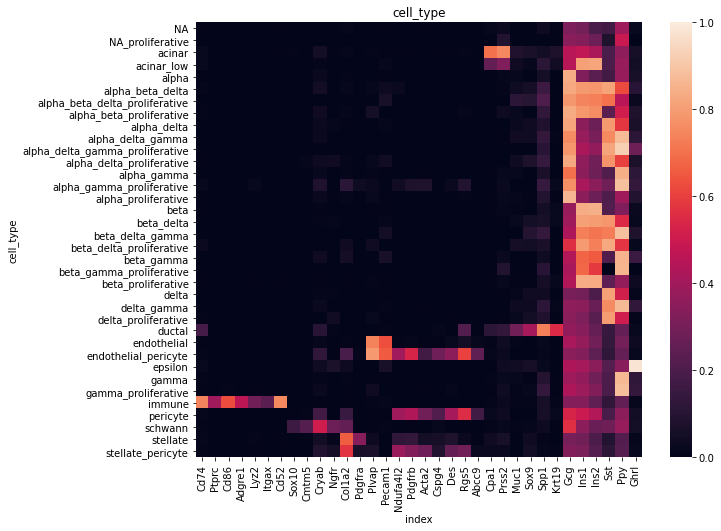

In [257]:
# Plot mean marker expression in each cluster
rcParams['figure.figsize']=(10,5)
fig,ax=plt.subplots()
sb.heatmap(scaled_expression.groupby(adata_rawnormalised.obs['pre_cell_type']).mean(),yticklabels=1,xticklabels=1,
          vmin=0,vmax=1)
ax.set_title('pre_cell_type')
rcParams['figure.figsize']=(10,8)
fig,ax=plt.subplots()
sb.heatmap(scaled_expression.groupby(adata_rawnormalised.obs['cell_type']).mean(),yticklabels=1,xticklabels=1,
          vmin=0,vmax=1)
ax.set_title('cell_type')

#C: Annotated stellate are not neuronal but rather more fibroblast like (stellate != pancreatic stellate).

#### Cell type markers

Upregulated genes in each cell type compared to other cells on normalised log scaled data.

In [258]:
# Compute overexpressed genes in each cell type on normalised log scaled data
#Retain only cell types with >=10 cells and non-NA annotation
groups_counts=adata.obs.cell_type.value_counts()
groups=[cell_type for cell_type in groups_counts[groups_counts>=10].index if cell_type!='NA']
# Compute markers
sc.tl.rank_genes_groups(adata,groupby='cell_type',groups=groups, use_raw=False)
sc.tl.filter_rank_genes_groups(adata,groupby='cell_type', use_raw=False)

... storing 'cell_type' as categorical


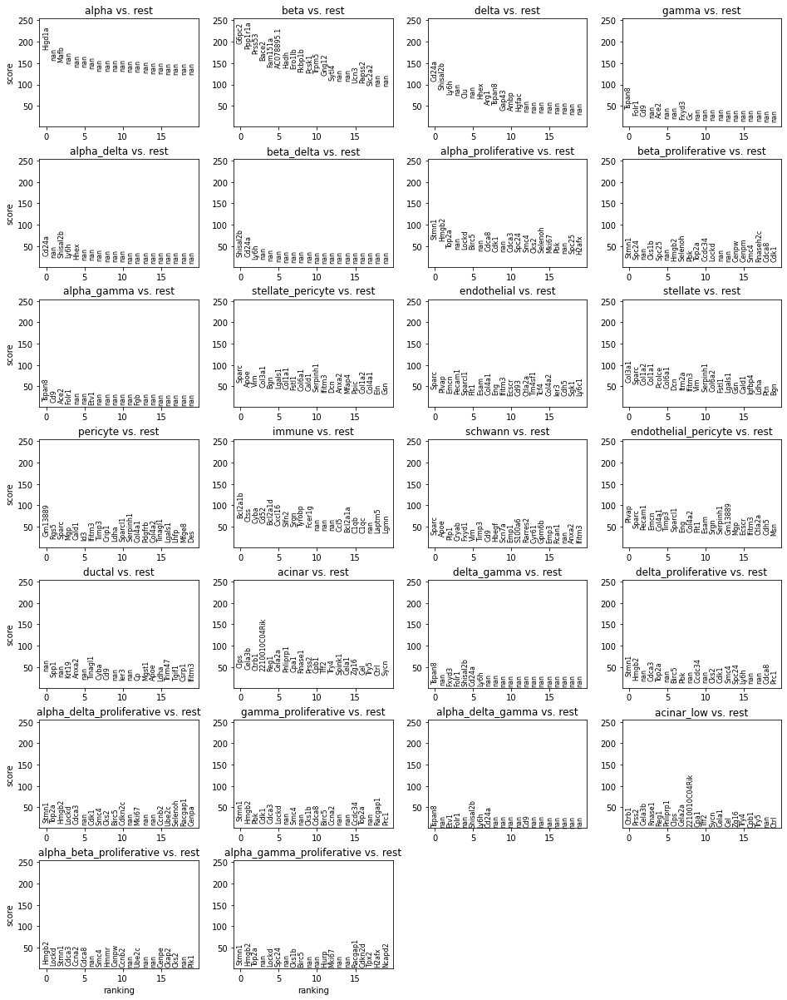

In [259]:
# Plot cell_type vs rest upregulated genes
rcParams['figure.figsize']=(4,3)
sc.pl.rank_genes_groups(adata,key='rank_genes_groups_filtered')

Expression of upregulated genes on normalised log transformed z-scaled data

categories: NA, NA_proliferative, acinar, etc.
var_group_labels: alpha, beta, delta, etc.


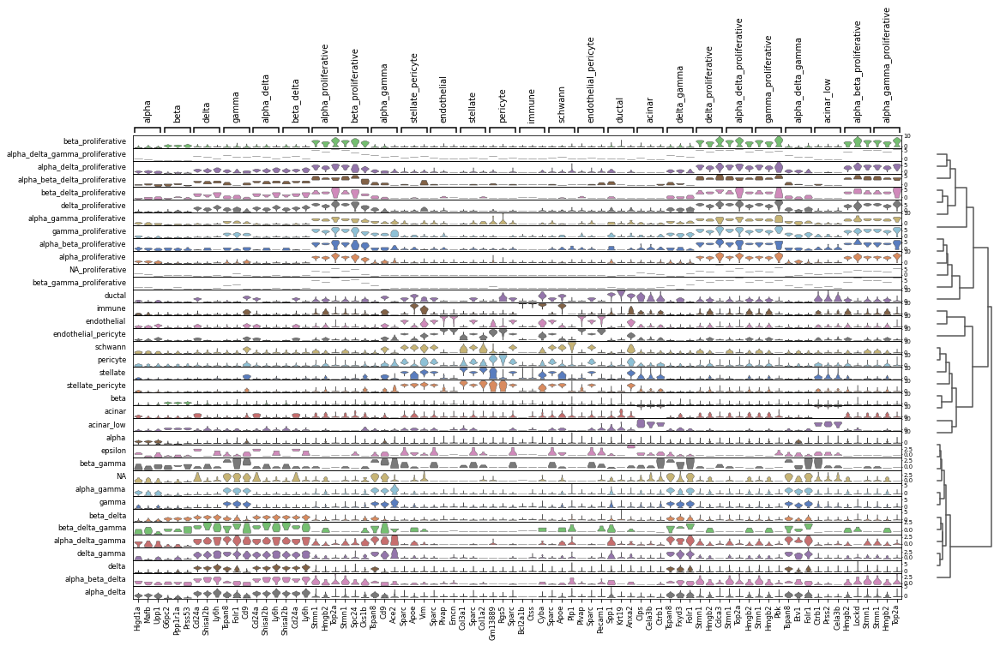

In [260]:
# Plot expression of cell type upregulated genes on normalised log transformed z-scaled data
adata_scl.uns['rank_genes_groups_filtered']=adata.uns['rank_genes_groups_filtered']
adata_scl.obs['cell_type']=adata.obs['cell_type']
sc.pl.rank_genes_groups_stacked_violin(adata_scl,key='rank_genes_groups_filtered',n_genes=3,use_raw=False)

#### Markers of potential dublet populations
Find genes overexpressed in potential dublet populations compared to individual cell types present in both parental cell types.

Mixed cell type is set as reference - to use mean for filtering (besidel lFC and qval).

QC metrics in each cell type.

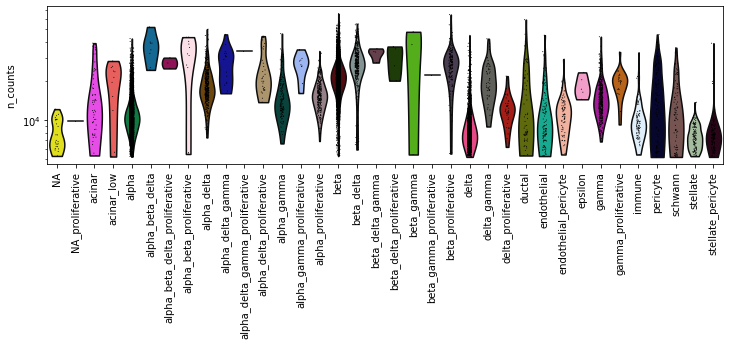

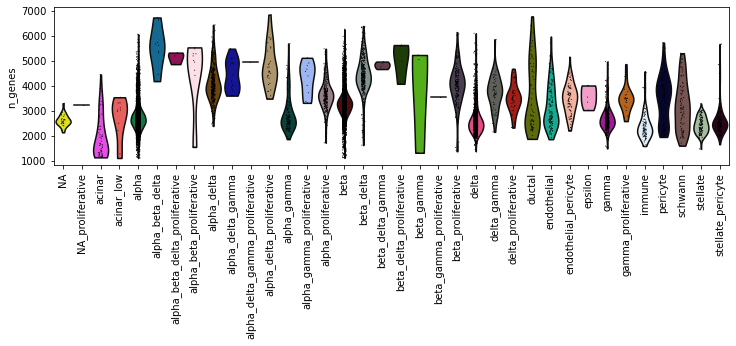

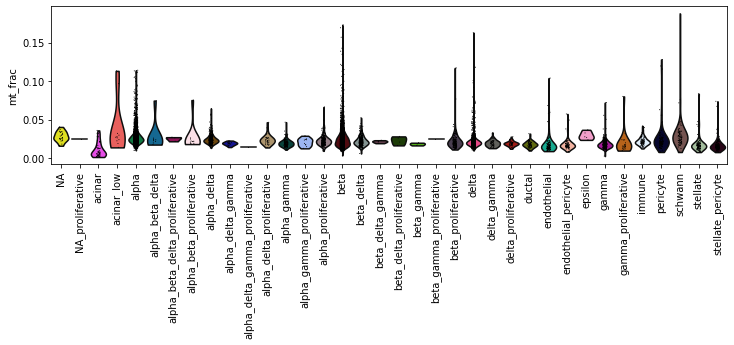

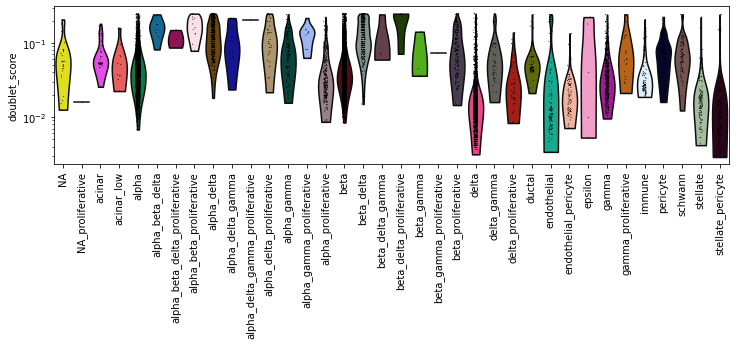

In [261]:
# QC metrics per cell type
rcParams['figure.figsize']=(10,3)
sc.pl.violin(adata, ['n_counts'], groupby='cell_type', size=1, log=True,rotation=90)
sc.pl.violin(adata, ['n_genes'], groupby='cell_type', size=1, log=False,rotation=90)
sc.pl.violin(adata, ['mt_frac'], groupby='cell_type', size=1, log=False,rotation=90)
sc.pl.violin(adata, 'doublet_score',groupby='cell_type',size=1, log=True,rotation=90)

145_mGFP


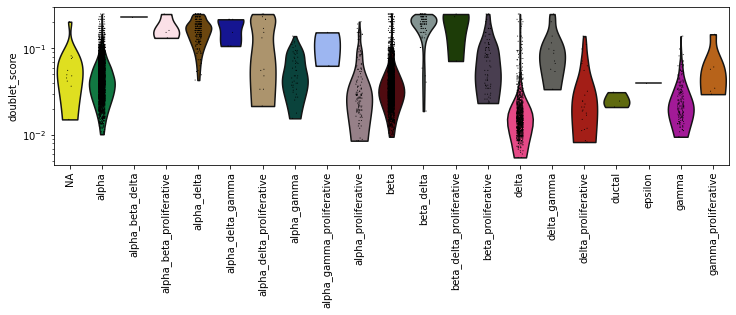

146_mRFP


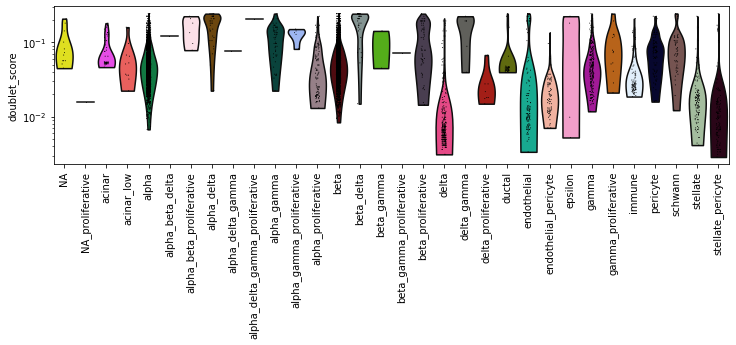

147_mTmG


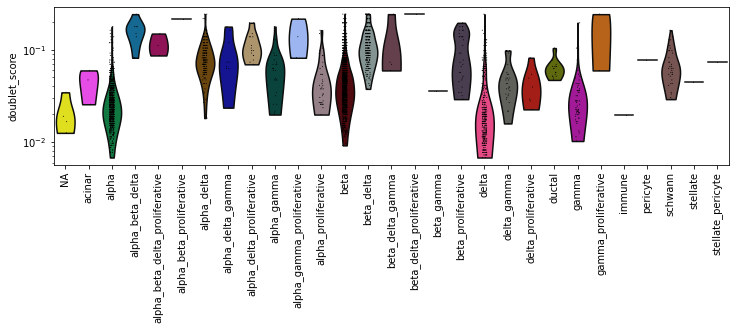

In [268]:
# Doublet score per file
for file in adata.obs.file.unique():
    print(file)
    sc.pl.violin(adata[adata.obs.file==file,:], 'doublet_score',groupby='cell_type',size=1, log=True,rotation=90)
    time.sleep(1)

### Expected doublet rates

Adapted from https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6126471/#ref-7, but using 0.1 as doublet rate (described in my notes).

Expected multiplet number is calculated for each file separately.

In [267]:
# Singlet cell types whose multiplet rates are predicted
cell_types=['alpha','beta','gamma','delta']
# DFs with expected multiplet rates
expected_dfs=[]
# Exclude some endocrine cells as they form completely separate populations 
# with no multiplets in neighbourhood)
exclude_types=[cell_type for cell_type in adata.obs.cell_type.unique() if 'proliferative'  in cell_type]
print('Excluding following cells:',exclude_types)
# Calculate expected rate for each file separately
for file in adata.obs.file.unique():
    print('\nFile:',file)
    cell_type_temp=adata.obs.query('file == "'+file+'" & cell_type not in @exclude_types').cell_type.copy()
    
    # N of droplets containing at least one cell of the relevant cell type
    Ns=dict()
    for cell_type in cell_types:
        n_celltype=cell_type_temp.str.contains(cell_type).sum()
        Ns[cell_type]=n_celltype
    print('N droplets that contain at least one:',Ns)
    
    # Calculate N (see formula in notes)
    N=emr.get_N(Ns=Ns.values())
    regex_any='|'.join(['.*'+cell_type+'.*' for cell_type in cell_types])
    print('N:',round(N,1), '(observed cell-containing N with relevant cell types:',
          cell_type_temp.str.contains(fr'{regex_any}').sum(),')')
    
    # Calculate mu for each cell type
    mus=dict()
    for cell_type in cell_types:
        mus[cell_type]=emr.mu_cell_type(N_cell_type=Ns[cell_type], N=N)
    print('mu:',{k:round(v,4) for k,v in mus.items()})
    
    # Extract multiplet types and their components
    multiplet_types=dict()
    for cell_type in cell_type_temp.unique():
        # Get components of multiplets by retaining name parts contained in original cell type dict
        components_all=cell_type.split('_')
        components_relevant=[type_singlet for type_singlet in components_all if type_singlet in cell_types]
        if len(components_relevant) > 1:
            multiplet_types[cell_type]=components_relevant
            # This does not assure that initially the cell types are not counted wrongly 
            # (e.g. including proliferative, ...)
            #if len(components_relevant) < len(components_all):
            #    warnings.warn('Multiplet type has additional unrecognised component: '+cell_type)
    #print('Relevant multiplet cell types:',multiplet_types.keys())
    
    # This also analyses O and E of singlet types, but this is not so relevant as changes in multiplets also 
    # affect it?
    #types_OE= dict(zip(cell_types,[[i] for i in cell_types]))
    #types_OE.update(multiplet_types)
    
    # Calculate O (observed) and E (expected) numbers
    expected_df=pd.DataFrame(index=multiplet_types.keys(),columns=['O_'+file,'E_'+file
                                                                  # ,'E_atleast'
                                                                  ])
    #for multiplet, components in types_OE.items():
    for multiplet, components in multiplet_types.items():
        absent=np.setdiff1d(cell_types,components)
        # N of cellls of this cell type
        expected_df.at[multiplet,'O_'+file]=(cell_type_temp==multiplet).sum()
        # Expected N of cells that have all the individual cell types of multiplet and non of the other 
        # considered possible multiplet ontributors
        expected_df.at[multiplet,'E_'+file]=emr.expected_multiplet(
            mu_present=[mus[cell_type] for cell_type in components], 
            mu_absent=[mus[cell_type] for cell_type in absent], 
            N=N)
        # E that droplet contains at least one cell of each present cell type,
        # but does not exclude other cell types from being present
        #expected_df.at[multiplet,'E_atleast']=emr.expected_multiplet(
        #    mu_present=[mus[cell_type] for cell_type in components], 
        #    mu_absent=[], 
        #    N=N)
    expected_dfs.append(expected_df)
    
# Merge O/E rates for all files into single DF
display(pd.concat(expected_dfs,axis=1))
del cell_type_temp

Excluding following cells: ['alpha_proliferative', 'beta_proliferative', 'alpha_delta_proliferative', 'delta_proliferative', 'gamma_proliferative', 'alpha_gamma_proliferative', 'beta_delta_proliferative', 'alpha_beta_proliferative', 'beta_gamma_proliferative', 'alpha_delta_gamma_proliferative', 'NA_proliferative', 'alpha_beta_delta_proliferative']

File: 145_mGFP
N droplets that contain at least one: {'alpha': 4332, 'beta': 3375, 'gamma': 232, 'delta': 1377}
N: 19323.2 (observed cell-containing N with relevant cell types: 8942 )
mu: {'alpha': 0.2538, 'beta': 0.192, 'gamma': 0.0121, 'delta': 0.0739}

File: 146_mRFP
N droplets that contain at least one: {'alpha': 2950, 'beta': 2676, 'gamma': 310, 'delta': 389}
N: 13230.3 (observed cell-containing N with relevant cell types: 6187 )
mu: {'alpha': 0.2523, 'beta': 0.226, 'gamma': 0.0237, 'delta': 0.0298}

File: 147_mTmG
N droplets that contain at least one: {'alpha': 1116, 'beta': 1799, 'gamma': 129, 'delta': 794}
N: 7917.3 (observed cell-co

,O_145_mGFP,E_145_mGFP,O_146_mRFP,E_146_mRFP,O_147_mTmG,E_147_mTmG
alpha_delta,214,251.728,35,67.5718,169,85.0801
alpha_gamma,46,39.868,55,53.5198,26,12.6426
beta_delta,88,184.349,36,59.7044,249,152.46
alpha_delta_gamma,6,3.05905,1,1.62127,9,1.40921
delta_gamma,12,10.586,6,5.64987,31,8.58821
alpha_beta_delta,1,53.2714,1,17.1326,7,25.0167
beta_gamma,NaN,NaN,2,47.2884,1,22.655
beta_delta_gamma,NaN,NaN,NaN,NaN,4,2.52526


#C: Potential doublet populations alpha_delta and beta_delta are differently likely to be doublets across different samples (based on O/E and doublet scores). Thus their distribution is shown on sample-specific UMAPs.

145_mGFP


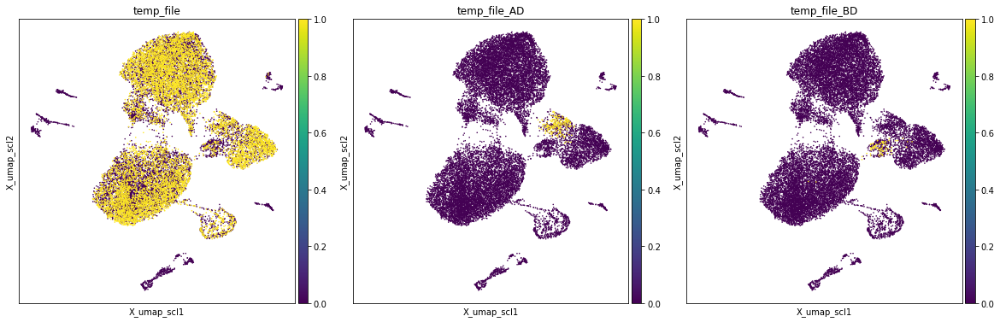

146_mRFP


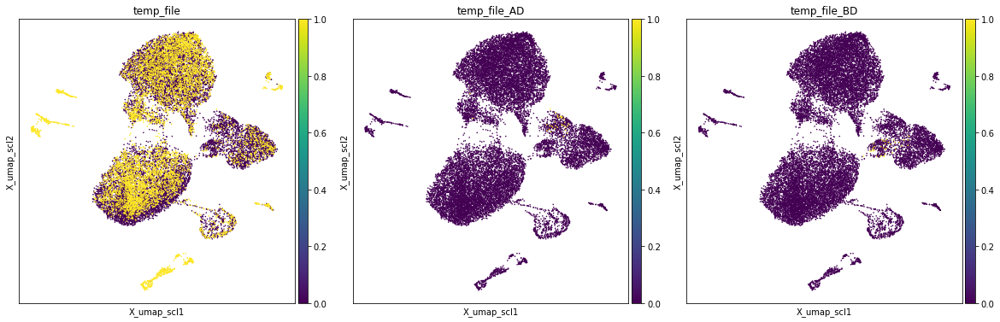

147_mTmG


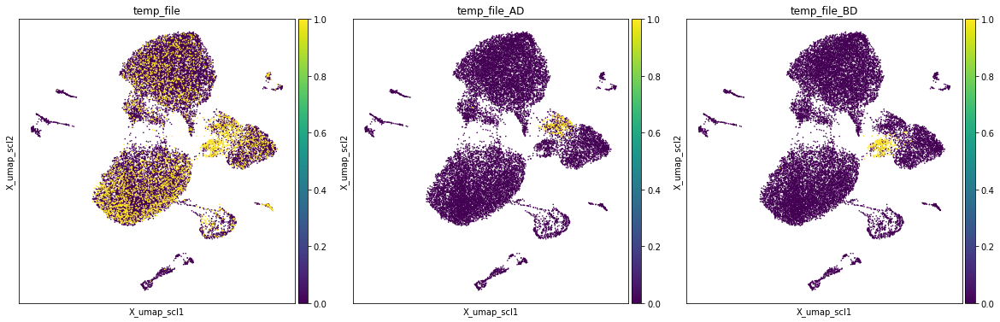

In [284]:
# Display where are ambigous multiplets present in different files
rcParams['figure.figsize']=(6,6)
for file in adata.obs.file.unique():
    print(file)
    adata.obs['temp_file']=adata.obs.file==file
    adata.obs['temp_file_AD']=(adata.obs.file==file) & (adata.obs.cell_type=='alpha_delta')
    adata.obs['temp_file_BD']=(adata.obs.file==file) & (adata.obs.cell_type=='beta_delta')
    sc.pl.embedding(adata,'X_umap_scl', color=['temp_file','temp_file_AD','temp_file_BD'], 
                    size=10, use_raw=False,wspace=0.1)
    time.sleep(1)
adata.obs.drop(['temp_file','temp_file_AD','temp_file_BD'],axis=1,inplace=True)

#C: AD and BD have same location across files, but different frequency. AD was assigned as non-doublet in other datasets (Fltp, VSGref, STZref) and BD was assigned as doublet. However, here it seems that both populations might be non-doublets. In case of BD this could be due to poor cell dissociation in one of the samples (cells are located in the same region as doublet-like cells from other files) as the same cell trype was not observed as non-doublet in other files. 

Proliferative potential doublets are added to multiplets based on non-multiplet results and low N.

In [6]:
# Reassign cell types to multiplet
multiplets=['alpha_beta_delta','beta_delta_gamma','beta_gamma','beta_delta',
            # Add proliferative
            # beta_delta_proliferative and alpha_delta_gamma_proliferative are
            # added to multiplets as they have relatively low counts (4 cells, 1 cell) and high doublet scores
            'alpha_beta_proliferative','beta_delta_proliferative',
            'alpha_beta_delta_proliferative','alpha_delta_gamma_proliferative','beta_gamma_proliferative']

adata.obs['cell_type_multiplet']=adata.obs.cell_type.replace(multiplets, 'multiplet')

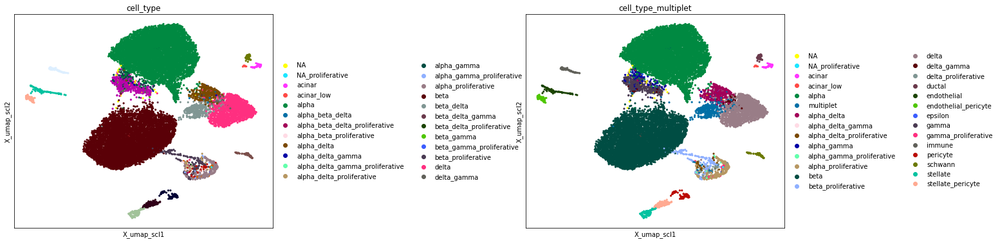

In [7]:
# Plot new cell types
rcParams['figure.figsize']=(6,6)
sc.pl.embedding(adata,'X_umap_scl', color=['cell_type','cell_type_multiplet'], size=40, use_raw=False,wspace=0.8)

## Resolve beta subtypes

#### Preprocess beta cell data

Select beta cells only

In [7]:
[ct for ct in adata.obs.cell_type_multiplet.unique() if 'beta' in ct]

['beta', 'beta_proliferative']

#C: No beta str containing cell types to exclude

In [8]:
# Subset adata
selected_beta=[ct for ct in adata.obs.cell_type_multiplet.unique() if 'beta' in ct]
adata_beta=adata[adata.obs.cell_type.isin(selected_beta),:].copy()
adata_beta.shape

# Normalise raw data for plotting and cell type scoring
adata_raw_beta=adata_beta.raw.to_adata().copy()
# Normalize and log transform
adata_raw_beta.X /= adata_raw_beta.obs['size_factors'].values[:,None] # This reshapes the size-factors array
sc.pp.log1p(adata_raw_beta)
adata_raw_beta.X = sparse.csr_matrix(np.asarray(adata_raw_beta.X))

# Scale beta adata for umap
adata_scl_beta=adata_beta
del adata_beta
sc.pp.scale(adata_scl_beta,max_value=10)
sc.pp.pca(adata_scl_beta, n_comps=10, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_scl_beta,n_pcs=10)
sc.tl.umap(adata_scl_beta)

# Combine raw and X data
adata_rawnormalised_beta=adata_scl_beta.copy()
adata_rawnormalised_beta.raw=adata_raw_beta
del adata_raw_beta

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'

In [9]:
metadata=pd.read_excel('/lustre/groups/ml01/workspace/karin.hrovatin/data/pancreas/scRNA/scRNA-seq_pancreas_metadata.xlsx',
                      sheet_name='Fltp_P16')
# Add metadata 
samples=adata_rawnormalised_beta.obs.file.unique()
value_map={sample:metadata.query('sample_name =="'+sample+'"')['design'].values[0] for sample in samples}
adata_rawnormalised_beta.obs['design']=adata_rawnormalised_beta.obs.file.map(value_map)

Trying to set attribute `.uns` of view, copying.


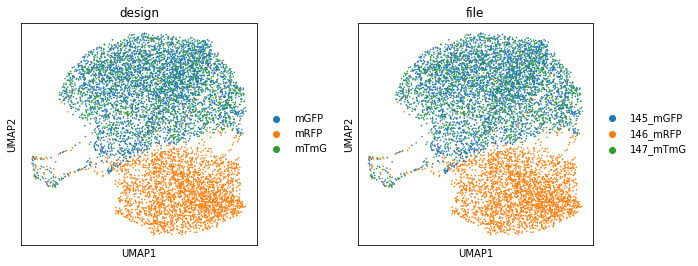

In [10]:
rcParams['figure.figsize']=(4,4)
random_indices=np.random.permutation(list(range(adata_rawnormalised_beta.shape[0])))
sc.pl.umap(adata_rawnormalised_beta[random_indices,:], color=['design','file'],size=10, use_raw=True,wspace=0.3)

#### Check markers

('beta', '/')
Missing genes: []


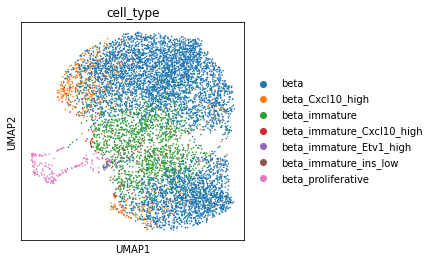

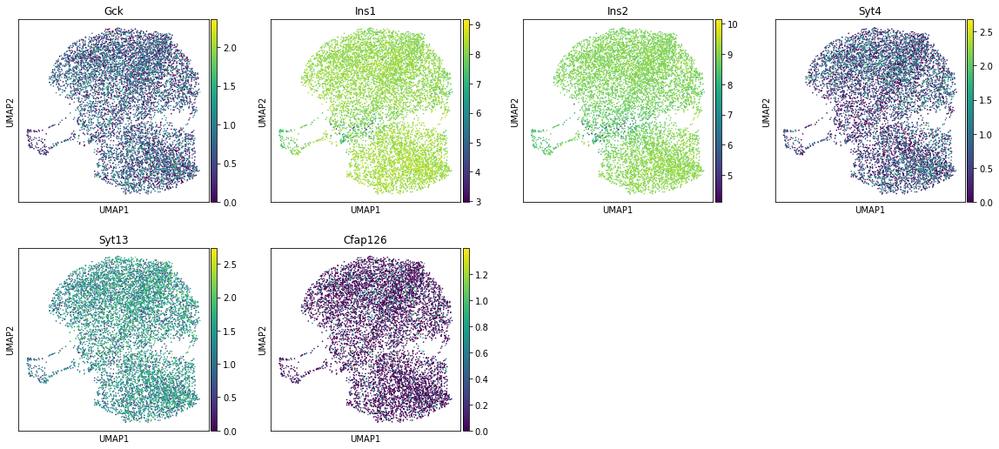

('beta', 'aging')
Missing genes: []


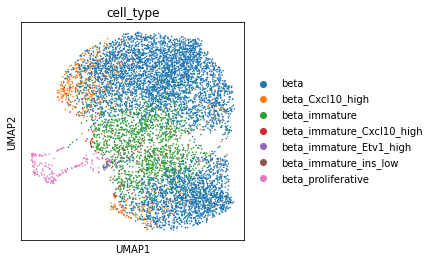

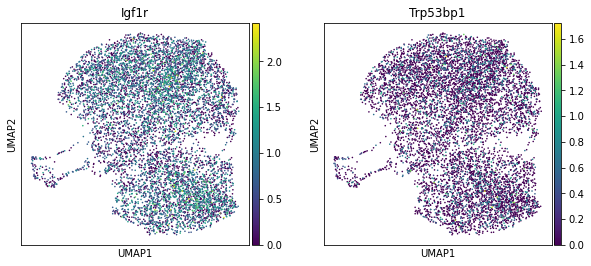

('beta', 'dedifferentiated')
Missing genes: []


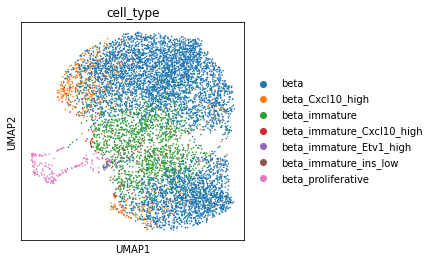

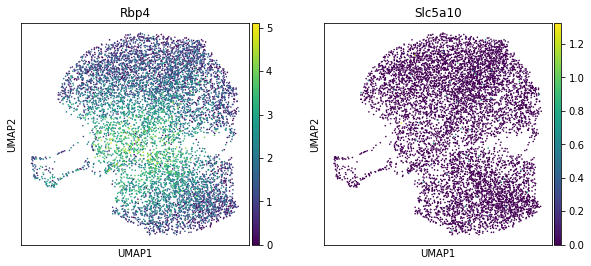

('beta', 'disease')
Missing genes: []


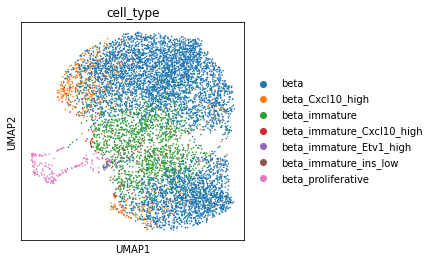

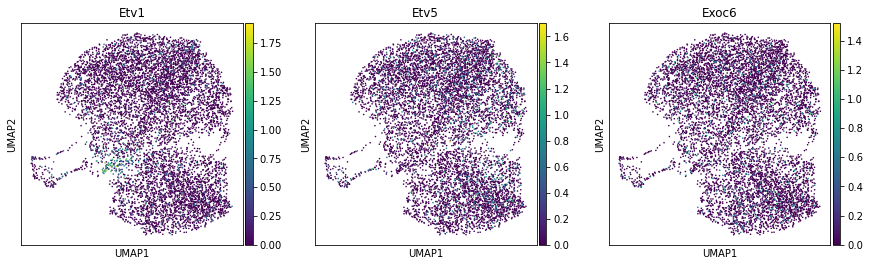

('beta', 'immature')
Missing genes: ['Pax4']


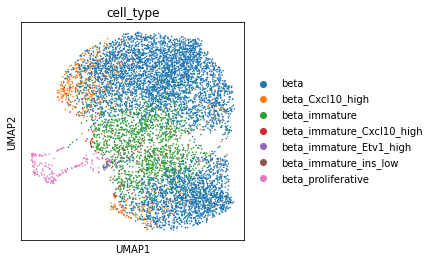

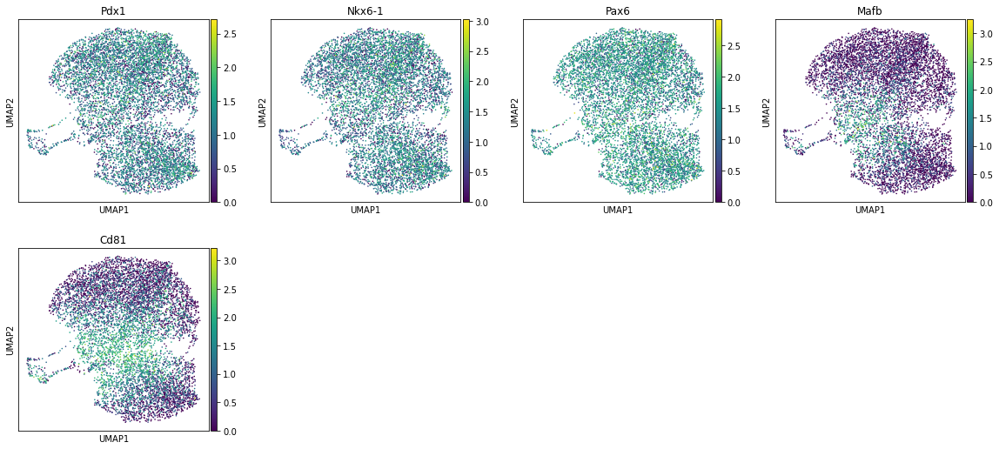

('beta', 'inflamation')
Missing genes: []


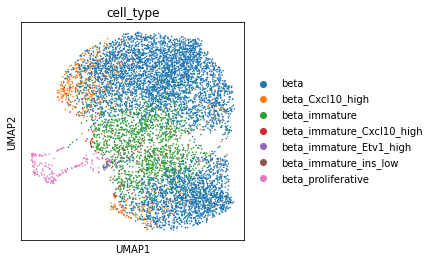

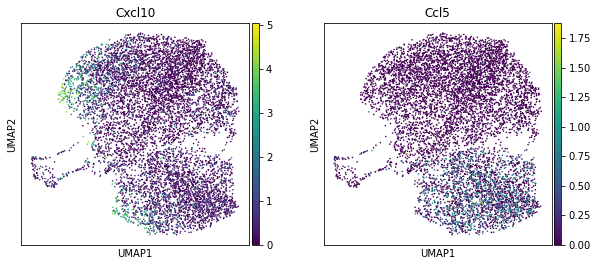

('beta', 'mature')
Missing genes: []


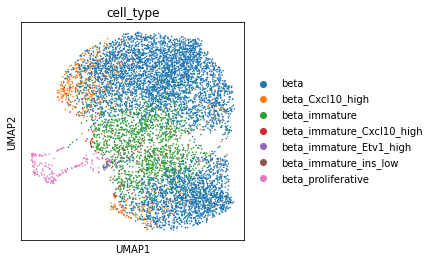

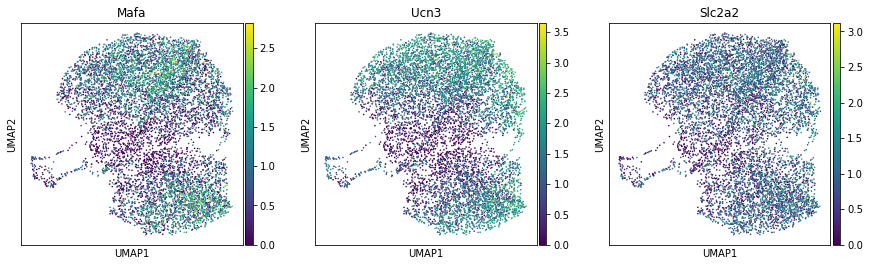

('beta', 'senescent')
Missing genes: []


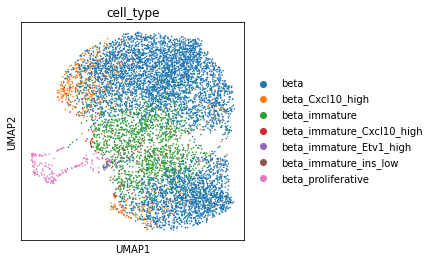

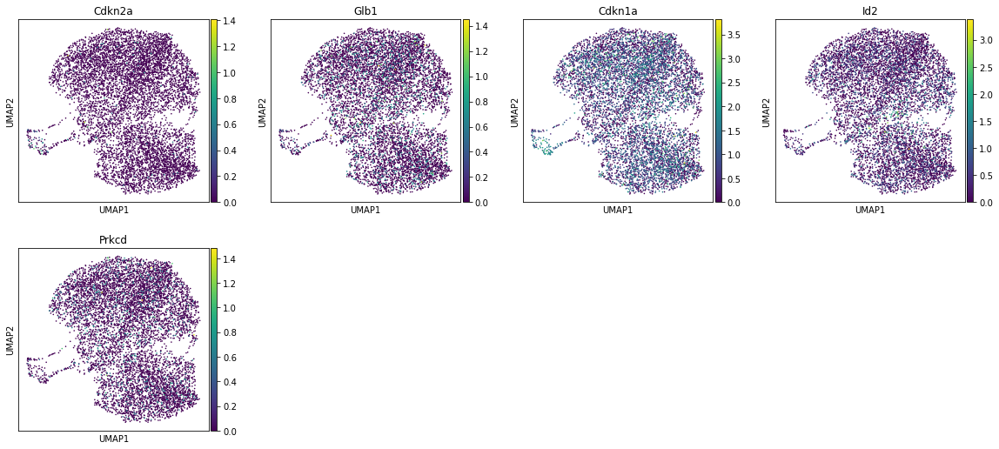

('endocrine', '/')
Missing genes: ['Neurod2']


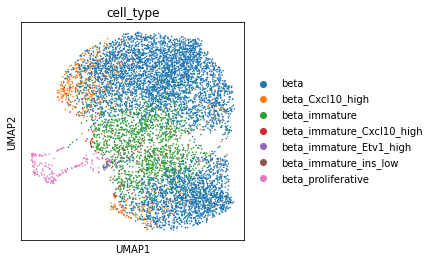

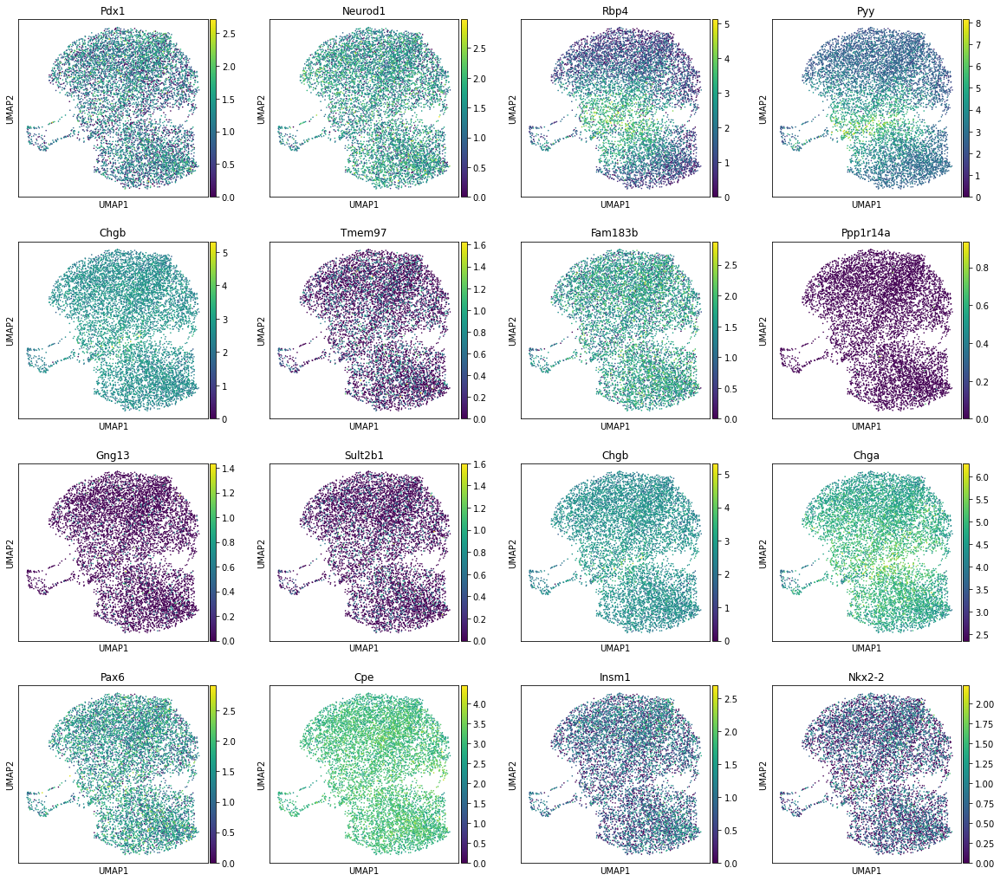

In [189]:
# Select beta and endocrine markers and group by cell type and subtype
for group_name, group in markers.query('Cell in ["beta","endocrine"]').fillna('/').groupby(['Cell','Subtype']):
    print(group_name)
    genes=group.Gene
    # Retain genes present in raw var_names
    missing=[gene for gene in genes if gene not in adata.raw.var_names]
    genes=[gene for gene in genes if gene in adata.raw.var_names]
    print('Missing genes:',missing)
    rcParams['figure.figsize']=(4,4)
    sc.pl.umap(adata_rawnormalised_beta, color=['cell_type'],size=10, use_raw=True)
    sc.pl.umap(adata_rawnormalised_beta, color=genes ,size=10, use_raw=True)

#C: The following populations can be identified: immature (high: Rbp4, Cd81, Mafb,Pyy, low: Mafa, Ucn3), Etv1 high, Ins1,2 low. Etv1 high and Ins low might be overlapping, similarly Etv1 and Pyy high. Proliferative beta cells will not be re-annotated (excluded from further analysis). Ccl5 seems to be sample specific thus a obs could be added another column with Ccl5 high per cell - otherwise all other subtypes would be separated based on this sample specific value. Howevrer,  Ccl5 is high in Fltp- samples of P16 and adoult - thus confounding with Fltp, indicating true population. Ccl5 will be thus used as other markers. Nevertheless, this is not evident in 2y Fltp- samples.

In [8]:
adata_rawnormalised_beta=adata_rawnormalised_beta[adata_rawnormalised_beta.obs.cell_type!='beta_proliferative',:]

Try to cluster cells to see if clusters can resolve above defined populations.

/home/icb/karin.hrovatin/miniconda3/envs/rpy2_3/lib/python3.8/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
Trying to set attribute `.obs` of view, copying.


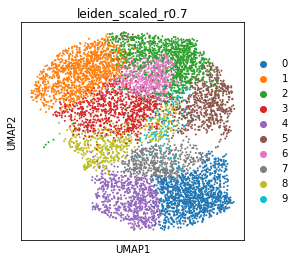

In [191]:
res=0.7
sc.tl.leiden(adata_rawnormalised_beta, resolution=res, key_added='leiden_scaled_r'+str(res), directed=True, use_weights=True)
sc.pl.umap(adata_rawnormalised_beta, color='leiden_scaled_r'+str(res))

#C: Clustering is not able to well separate immature from mature cells (based on markers). This could be in part due to using HVGs defined on the whole dataset for distance calculation. It is also possible that there are other differences between cells (e.g. unknown markers). As markers will be used for annotation the annotation will be rather done based on scores (and not clusters) as this better correesponds to the known markers. Immature and Cd81 high were separted for consistency with other studies.

In [9]:
# Selected markers that seem to be able to distinguish between cell seubtypes
markers_selection_beta={
'immature':['Rbp4',  'Mafb', 'Pyy'],
'Cd81_high':['Cd81'],
'mature':['Mafa', 'Ucn3'],
'Etv1_high':['Etv1'],
'ins_high':['Ins1','Ins2'],
'Cxcl10_high':['Cxcl10'],
'Ccl5_high':['Ccl5']
}

#### Calculate scores

In [10]:
# Calculate scores
scores=[]
for cell_type,genes in markers_selection_beta.items():
    score_name=cell_type+'_score'
    scores.append(cell_type+'_score')
    sc.tl.score_genes(adata_rawnormalised_beta, gene_list=genes, score_name=score_name,  use_raw=True)

Trying to set attribute `.obs` of view, copying.


In [11]:
# Scores normalised to interval [0,1] for each cell type - so that they can be more easily compared
scores_df_norm_beta=adata_rawnormalised_beta.obs[scores]
scores_df_norm_beta=pd.DataFrame(pp.minmax_scale(scores_df_norm_beta),columns=scores_df_norm_beta.columns,index=adata_rawnormalised_beta.obs.index)

#### Plot score distn and score relationships

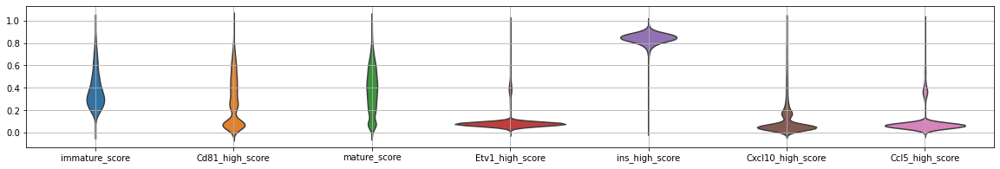

In [12]:
# Plot of normalised scores distribution in whole dataset, per cluster
rcParams['figure.figsize']=(20,3)
fig,ax=plt.subplots()
sb.violinplot(data=scores_df_norm_beta,inner=None,ax=ax)
ax.grid()

In [13]:
# Dict for score thresholds
beta_marker_thresholds=dict()

Text(0, 0.5, 'mature_score')

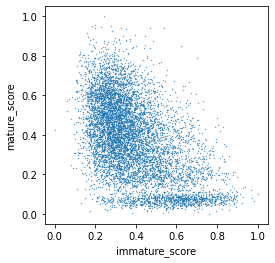

In [14]:
rcParams['figure.figsize']=(4,4)
plt.scatter(scores_df_norm_beta['immature_score'],scores_df_norm_beta['mature_score'],s=0.1)
plt.xlabel('immature_score')
plt.ylabel('mature_score')

Distribution of differences between immature and mature scores

In [15]:
scores_df_norm_beta['immature-mature_score']=scores_df_norm_beta['immature_score']-scores_df_norm_beta['mature_score']

Text(0.5, 0, 'immature-mature score')

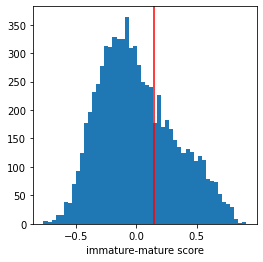

In [16]:
a=plt.hist(scores_df_norm_beta['immature-mature_score'],bins=50)
beta_marker_thresholds['immature-mature_score']=0.15
plt.axvline(beta_marker_thresholds['immature-mature_score'],c='r')
plt.xlabel('immature-mature score')

#C: The mature annd immaturte populations are hard to separate. The thershold will be set at 0.15 of their difference.

Text(0, 0.5, 'mature_score')

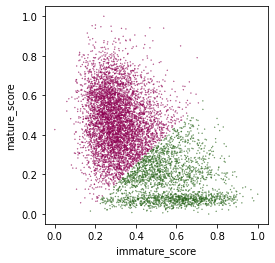

In [17]:
plt.scatter(scores_df_norm_beta['immature_score'],scores_df_norm_beta['mature_score'],s=0.1,
            c=scores_df_norm_beta['immature-mature_score']>=beta_marker_thresholds['immature-mature_score'],
           cmap='PiYG')
plt.xlabel('immature_score')
plt.ylabel('mature_score')

Text(0, 0.5, 'iommature-mature_score')

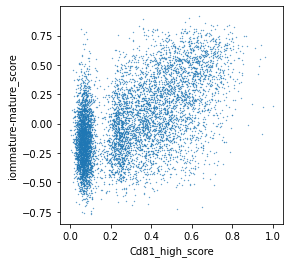

In [18]:
rcParams['figure.figsize']=(4,4)
plt.scatter(scores_df_norm_beta['Cd81_high_score'],scores_df_norm_beta['immature-mature_score'],s=0.1)
plt.xlabel('Cd81_high_score')
plt.ylabel('iommature-mature_score')

#C: First large peak is often 0 expressing cells and the second and third peak then represent low (e.g. low but not zero) and high cells. 

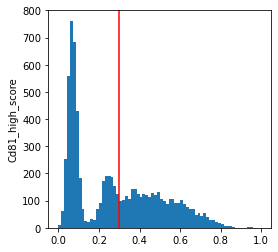

In [19]:
a=plt.hist(scores_df_norm_beta['Cd81_high_score'],bins=70)
#plt.yscale('log')
plt.ylabel('Cd81_high_score')
beta_marker_thresholds['Cd81_high_score']=0.3
plt.axvline(beta_marker_thresholds['Cd81_high_score'],c='r')

In [20]:
# Convert ins high to ins low
scores_df_norm_beta['ins_low_score']=scores_df_norm_beta['ins_high_score']*-1+1

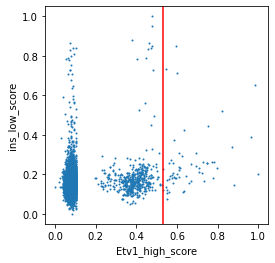

In [21]:
rcParams['figure.figsize']=(4,4)
plt.scatter(scores_df_norm_beta['Etv1_high_score'],scores_df_norm_beta['ins_low_score'],s=1)
plt.xlabel('Etv1_high_score')
plt.ylabel('ins_low_score')
beta_marker_thresholds['Etv1_high_score']=0.53
plt.axvline(beta_marker_thresholds['Etv1_high_score'],c='r')

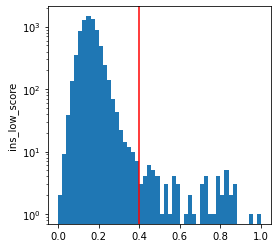

In [22]:
a=plt.hist(scores_df_norm_beta['ins_low_score'],bins=50)
plt.yscale('log')
plt.ylabel('ins_low_score')
beta_marker_thresholds['ins_low_score']=0.4
plt.axvline(beta_marker_thresholds['ins_low_score'],c='r')

Text(0, 0.5, 'ins_low_score')

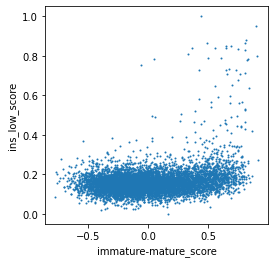

In [23]:
rcParams['figure.figsize']=(4,4)
plt.scatter(scores_df_norm_beta['immature-mature_score'],scores_df_norm_beta['ins_low_score'],s=1)
plt.xlabel('immature-mature_score')
plt.ylabel('ins_low_score')

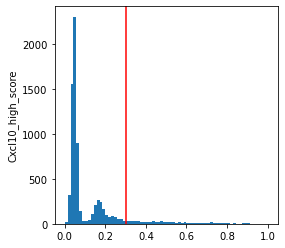

In [24]:
a=plt.hist(scores_df_norm_beta['Cxcl10_high_score'],bins=70)
#plt.yscale('log')
plt.ylabel('Cxcl10_high_score')
beta_marker_thresholds['Cxcl10_high_score']=0.3
plt.axvline(beta_marker_thresholds['Cxcl10_high_score'],c='r')

#C: A higher Cxcl10 threshold was selected as threshold between main two peaks still includes cells all across UMAP.

Text(0, 0.5, 'Cxcl10_high_score')

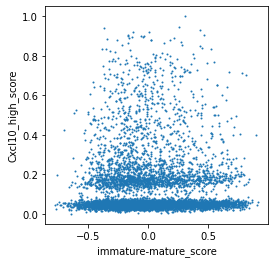

In [25]:
rcParams['figure.figsize']=(4,4)
plt.scatter(scores_df_norm_beta['immature-mature_score'],scores_df_norm_beta['Cxcl10_high_score'],s=1)
plt.xlabel('immature-mature_score')
plt.ylabel('Cxcl10_high_score')

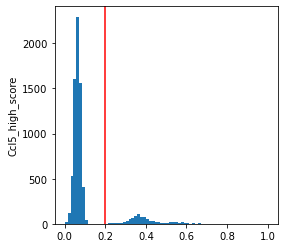

In [26]:
a=plt.hist(scores_df_norm_beta['Ccl5_high_score'],bins=70)
#plt.yscale('log')
plt.ylabel('Ccl5_high_score')
beta_marker_thresholds['Ccl5_high_score']=0.2
plt.axvline(beta_marker_thresholds['Ccl5_high_score'],c='r')

#C: Based on UMAPs Etv1 high and ins low mostly overlap immature cells. Check on UMAP where are each of these cells to see if all Etv1 high and ins low cells can be classified as immature.

In [415]:
# Add Ccl5 high to special obs column
#ccl5=pd.Series(index=scores_df_norm_beta.index)
#ccl5[scores_df_norm_beta['Ccl5_high_score']>=beta_marker_thresholds['Ccl5_high_score']]='high'
#ccl5.fillna('low',inplace=True)
#adata.obs.loc[adata_rawnormalised_beta.obs.index,'Ccl5']=ccl5

<ipython-input-415-079d46aae328>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  ccl5=pd.Series(index=scores_df_norm_beta.index)


In [27]:
# Thresholds for cell type assignemnt based on normalised scores
scores_cols_beta=['immature-mature_score','Cd81_high_score','Etv1_high_score','ins_low_score','Cxcl10_high_score',
                  'Ccl5_high_score']
thresholds_beta=[beta_marker_thresholds[score_col] for score_col in scores_cols_beta]

In [28]:
# Assign cell types based on scores to each cell
assignment_df_beta=scores_df_norm_beta[scores_cols_beta]>=thresholds_beta
# replace '-mature' from immature-mature to get just immature out for the cell type name
assignment_df_beta.columns=[col.replace('_score','').replace('-mature','') for col in scores_cols_beta] 

In [29]:
# For each cell make a (standard) string of annotated cell types: 
# e.g. each annotated cell type in the same order, separated by '_' when multiple cell types were annotated
type_unions_beta=[]
for idx,row in assignment_df_beta.iterrows():
    type_union=''
    for col in row.index:
        if row[col] :
            type_union=type_union+col+'_'
    if type_union=='':
        type_union='NA'
    type_unions_beta.append(type_union.rstrip('_'))

In [30]:
# Add cell types strings of cells to scores/assignment DF
assignment_df_beta['type_union']=type_unions_beta

In [31]:
assignment_df_beta['type_union'].value_counts()

NA                                                            3033
immature_Cd81_high                                            1340
Cd81_high                                                     1126
immature                                                       403
Ccl5_high                                                      369
Cxcl10_high                                                    330
immature_Cd81_high_Ccl5_high                                   215
Cd81_high_Ccl5_high                                            155
immature_Cd81_high_Cxcl10_high                                  99
Cd81_high_Cxcl10_high                                           86
immature_Ccl5_high                                              59
immature_Cxcl10_high                                            49
immature_Cd81_high_ins_low                                      44
Cxcl10_high_Ccl5_high                                           43
immature_Cd81_high_Cxcl10_high_Ccl5_high                      

In [32]:
adata_rawnormalised_beta.obs['beta_subtype']=assignment_df_beta['type_union']

... storing 'beta_subtype' as categorical


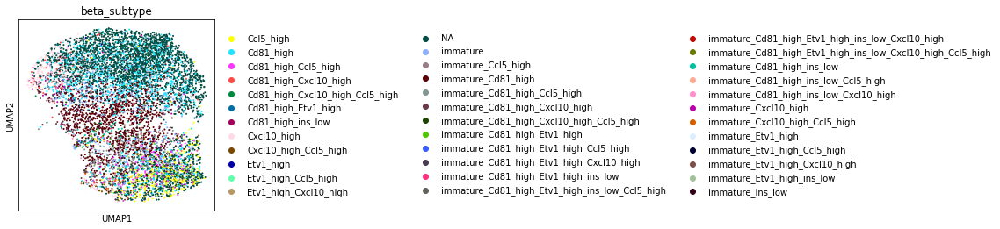

In [33]:
rcParams['figure.figsize']=(4,4)
sc.pl.umap(adata_rawnormalised_beta,color='beta_subtype')

Show rare subtypes if they cluster on UMAP with more common subtypes.

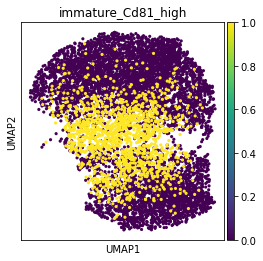

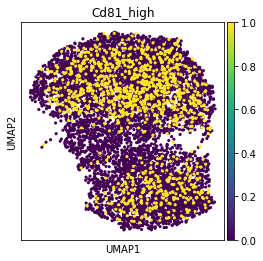

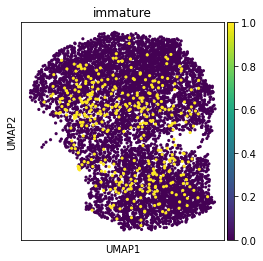

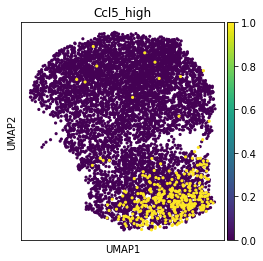

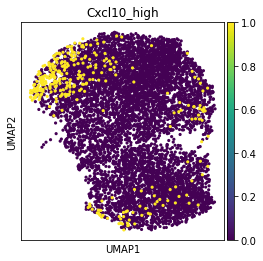

...

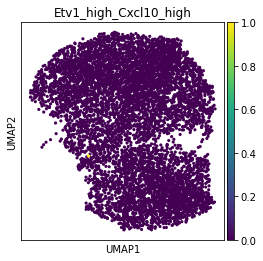

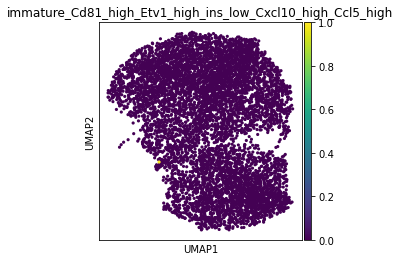

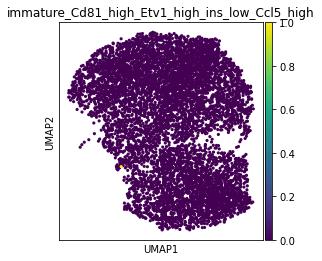

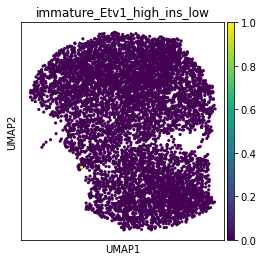

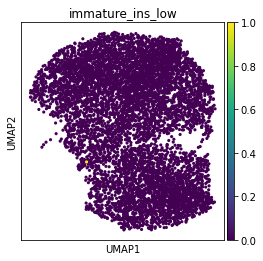

In [35]:
for subtype in adata_rawnormalised_beta.obs.beta_subtype.value_counts().index:
    if subtype !='NA':
        adata_rawnormalised_beta.obs['temp']=adata_rawnormalised_beta.obs['beta_subtype']==subtype
        sc.pl.umap(adata_rawnormalised_beta,color='temp',size=40,title=subtype)
adata_rawnormalised_beta.obs.drop('temp',axis=1,inplace=True)

#C: Set less common cell types to more common ones based on UMAP position.

In [39]:
# rename cell types

adata_rawnormalised_beta.obs['beta_subtype'].replace({
    'immature_Cd81_high':'immature',
'Cd81_high_Etv1_high':'immature_Etv1_high',
'immature_Cd81_high_ins_low':'immature_ins_low',
'immature_Cd81_high_ins_low_Ccl5_high':'immature_ins_low',
'immature_Cd81_high_Cxcl10_high':'immature_Cxcl10_high',
'immature_Cd81_high_Cxcl10_high_Ccl5_high':'immature_Cxcl10_high_Ccl5_high',
'immature_Cd81_high_Etv1_high':'immature_Etv1_high',
'immature_Cd81_high_Etv1_high_Ccl5_high':'immature_Etv1_high_Ccl5_high',
'immature_Cd81_high_Etv1_high_Cxcl10_high':'immature_Etv1_high', 
'Cd81_high_ins_low':'immature_ins_low',
'Etv1_high_Cxcl10_high':'NA', 
'immature_Cd81_high_ins_low_Cxcl10_high':'immature_ins_low', 
'immature_Etv1_high_ins_low':'immature_Etv1_high', 
'Etv1_high':'NA', 
'Etv1_high_Ccl5_high':'NA', 
'immature_Cd81_high_Etv1_high_ins_low':'immature_Etv1_high',
'immature_Cd81_high_Etv1_high_ins_low_Ccl5_high':'immature_Etv1_high_Ccl5_high',
'immature_Cd81_high_Etv1_high_ins_low_Cxcl10_high':'immature_Etv1_high',
'immature_Cd81_high_Etv1_high_ins_low_Cxcl10_high_Ccl5_high':'immature_Etv1_high_Ccl5_high',
'immature_Etv1_high_Cxcl10_high':'immature_Cxcl10_high',
'immature_Cd81_high_Ccl5_high':'immature_Ccl5_high'
                                                }, inplace=True)

In [40]:
adata_rawnormalised_beta.obs['beta_subtype'].value_counts()

NA                                 3043
immature                           1743
Cd81_high                          1126
Ccl5_high                           369
Cxcl10_high                         330
immature_Ccl5_high                  274
Cd81_high_Ccl5_high                 155
immature_Cxcl10_high                149
Cd81_high_Cxcl10_high                86
immature_ins_low                     58
Cxcl10_high_Ccl5_high                43
immature_Etv1_high                   40
immature_Cxcl10_high_Ccl5_high       27
Cd81_high_Cxcl10_high_Ccl5_high      12
immature_Etv1_high_Ccl5_high          6
Name: beta_subtype, dtype: int64

... storing 'beta_subtype' as categorical


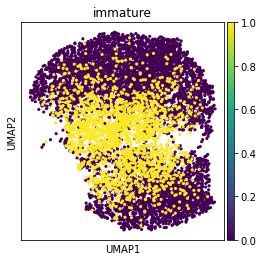

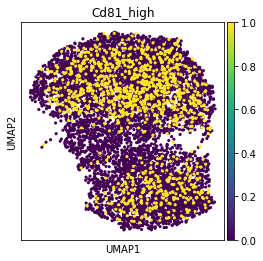

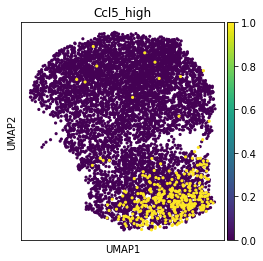

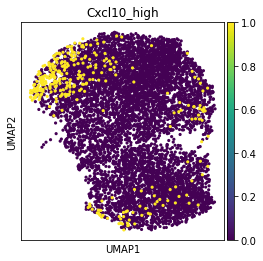

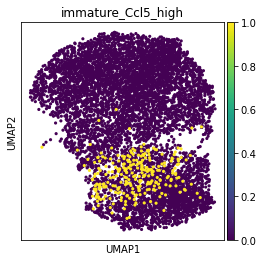

...

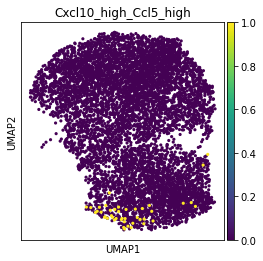

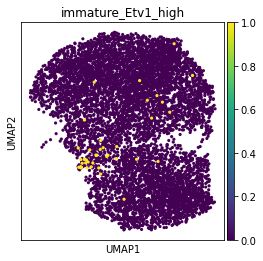

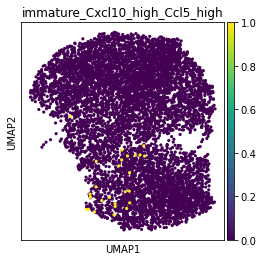

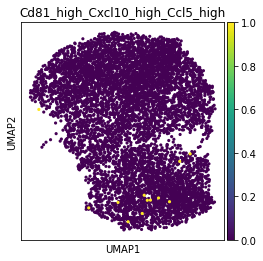

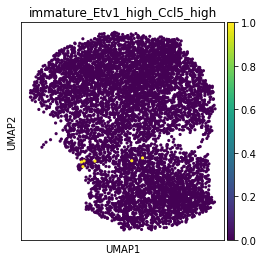

In [41]:
for subtype in adata_rawnormalised_beta.obs.beta_subtype.value_counts().index:
    if subtype !='NA':
        adata_rawnormalised_beta.obs['temp']=adata_rawnormalised_beta.obs['beta_subtype']==subtype
        sc.pl.umap(adata_rawnormalised_beta,color='temp',size=40,title=subtype)
adata_rawnormalised_beta.obs.drop('temp',axis=1,inplace=True)

In [44]:
# Add cell type data to adata
adata.obs[['cell_subtype','cell_subtype_multiplet']]=adata.obs[['cell_type','cell_type_multiplet']]
for subtype in adata_rawnormalised_beta.obs['beta_subtype'].unique():
    if subtype != 'NA':
        idxs=adata_rawnormalised_beta.obs.query('beta_subtype == @subtype').index
        subtype='beta_'+subtype
        add_category(df=adata.obs,idxs=idxs,col='cell_subtype',category=subtype)
        add_category(df=adata.obs,idxs=idxs,col='cell_subtype_multiplet',category=subtype)
# reorder categories
adata.obs.cell_subtype=pd.Categorical(adata.obs.cell_subtype,
                                   categories=sorted(list(adata.obs.cell_subtype.unique())),ordered=True)
adata.obs.cell_subtype_multiplet=pd.Categorical(adata.obs.cell_subtype_multiplet,
                                  categories=sorted(list(adata.obs.cell_subtype_multiplet.unique())),ordered=True)

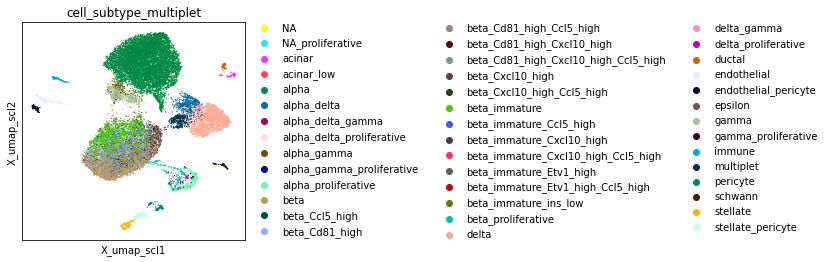

In [45]:
sc.pl.embedding(adata,'X_umap_scl',color='cell_subtype_multiplet')

### Save annotation

In [46]:
if SAVE:
    h.save_h5ad(adata, shared_folder+"data_annotated.h5ad",unique_id2=UID2)

In [5]:
#adata=h.open_h5ad(shared_folder+"data_annotated.h5ad",unique_id2=UID2)